In [1]:
import aim
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

aim_repo = '/home/jgaud/data/PhD/Novelty Detection in Data Streams/Extension/Aim Results/'
algorithms = ['ECSMinerWF', 'ECSMiner', 'Minas']
datasets = ['elec.csv', 'luxembourg.csv', 'ozone.arff', 'gassensor.arff', 'powersupply.arff', 'rialto.arff', 'outdoor.arff', 'keystroke.arff', 'NOAA.arff', 'shuttle.csv', 'creditcard.csv', 'room_occupancy.csv', 'INSECTS-abrupt_balanced_norm.arff']
save_path = '/home/jgaud/data/PhD/Novelty Detection in Data Streams/Extension/Graphs/'

baseline = 'run.wait_time_between_classes == 0 and run.ratio_known_classes == 0.3 and run.ratio_offline == 0.1 and run.sparsity == 1'

queries = {
    'wait_time=5000': 'run.wait_time_between_classes == 5000 and run.ratio_known_classes == 0.3 and run.ratio_offline == 0.1 and run.sparsity == 1',
    'ratio_offline=0.4': 'run.wait_time_between_classes == 0 and run.ratio_known_classes == 0.3 and run.ratio_offline == 0.4 and run.sparsity == 1',
    'ratio_offline=0.7': 'run.wait_time_between_classes == 0 and run.ratio_known_classes == 0.3 and run.ratio_offline == 0.7 and run.sparsity == 1',
    'ratio_known=0.5': 'run.wait_time_between_classes == 0 and run.ratio_known_classes == 0.5 and run.ratio_offline == 0.1 and run.sparsity == 1',
    'ratio_known=0.7': 'run.wait_time_between_classes == 0 and run.ratio_known_classes == 0.7 and run.ratio_offline == 0.1 and run.sparsity == 1',
    'sparsity=0.1': 'run.wait_time_between_classes == 0 and run.ratio_known_classes == 0.3 and run.ratio_offline == 0.1 and run.sparsity == 0.1',
    'sparsity=100': 'run.wait_time_between_classes == 0 and run.ratio_known_classes == 0.3 and run.ratio_offline == 0.1 and run.sparsity == 100',
    'sparsity=1000': 'run.wait_time_between_classes == 0 and run.ratio_known_classes == 0.3 and run.ratio_offline == 0.1 and run.sparsity == 1000'
}

list_characteristics = ['wait_time=0', 'wait_time=5000', 'ratio_offline=0.1', 'ratio_offline=0.4', 'ratio_offline=0.7', 'ratio_known=0.3', 'ratio_known=0.5', 'ratio_known=0.7', 'sparsity=1', 'sparsity=0.1', 'sparsity=100', 'sparsity=1000']

## Functions

In [2]:
def percentage_change(previous, current):
    if current == previous:
        return 0
    elif previous == 0:
        return float('inf')
    try:
        return ((current - previous) / abs(previous)) * 100.0
    except ZeroDivisionError:
        return float('inf')

def get_max_min_mean(data):   
    max_len = max(len(arr) for arr in data)
    max_values = []
    min_values = []
    avg_values = []
    
    for col_idx in range(max_len):
        # Create a temporary list to store values for this column
        column_data = []
        for arr in data:
          if col_idx < len(arr):
            column_data.append(arr[col_idx])
          else:
            # Use np.nan for missing values in shorter arrays
            column_data.append(np.nan)
          
        max_values.append(np.nanmax(column_data, axis=0))
        min_values.append(np.nanmin(column_data, axis=0))
        avg_values.append(np.nanmean(column_data, axis=0))
    
    return max_values, min_values, avg_values
    
def get_metrics(query, repo_path, selected_metrics=None):
    repo = aim.Repo(repo_path)  
    metrics = []

    for run_metrics_collection in repo.query_metrics(query).iter_runs():
        metric_values = {}
        for metric in run_metrics_collection.iter():
            metric_df = metric.dataframe()

            if (selected_metrics is None) or (metric.name in selected_metrics):
                if metric.name in ['inv_m_new', 'inv_f_new']:
                    metric_values[metric.name[4:]] = np.subtract(np.ones(shape=()),metric_df['value'].to_numpy())
                else:
                    metric_values[metric.name] = metric_df['value'].to_numpy()
                    
        if metric_values:
            metrics.append(metric_values)
    
    return metrics

def print_range_plots(dataset_name, condition, repo, metric_names, save_path=None):
    algorithms = ['ECSMinerWF', 'ECSMiner', 'Minas']
    colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

    for algo in algorithms:
        query = f'run.experiment == "{dataset_name}" and {condition} and "{algo}" in run.tags'

        try:
            metrics = get_metrics(query, repo, metric_names)
        
            # Splitting for save name
            parts = condition.split('==')
            dc_name = parts[0].strip().split('.')[-1]
            dc_value = parts[1].strip()
        
            for i, metric_name in enumerate(metric_names):
                values = [elem[metric_name] for elem in metrics]
    
                filename = f'{dataset}_{algo}_{dc_name}_{dc_value}_{metric_name}'
        
                max_values, min_values, mean_values = get_max_min_mean(values)
        
                x = ((np.arange(0, max(len(arr) for arr in values)) * 100 + 100) / 1000)
        
                fig, ax = plt.subplots()
        
                ax.plot(x, mean_values, color = colors[i])
                ax.fill_between(x, min_values, max_values, color = colors[i], alpha = 0.5)
                plt.xlabel('Samples (in thousands)', fontsize=15)
                plt.ylabel('Value', fontsize=15)
                plt.ylim(0,1)
                
                if save_path is not None:
                    plt.savefig(f'{save_path}Range_plots/eps/{filename}_plot.eps', format='eps', dpi=1200)
                    plt.savefig(f'{save_path}Range_plots/png/{filename}_plot.png', format='png', dpi=1200)
                                
                # #plt.show()
                # plt.clf()
        
                # data = [item for array in values for item in array]
                # plt.boxplot(data)
                
                # if save_path is not None:
                #     plt.savefig(f'{save_path}Range_plots/eps/{filename}_box.eps', format='eps', dpi=1200)
                #     plt.savefig(f'{save_path}Range_plots/png/{filename}_box.png', format='png', dpi=1200)
                
                # #plt.show()
            
        except Exception as e:
            print(str(e))
            print("Exception in query: " + query)

## Correlation Graph

In [10]:
metrics = get_metrics('run.wait_time_between_classes in [0, 5000]', aim_repo, ['adj_mut_info', 'cer'])

100%|███████████████████████████████████████████████████████████████████████████████| 2588/2588 [10:16<00:00,  4.20it/s]


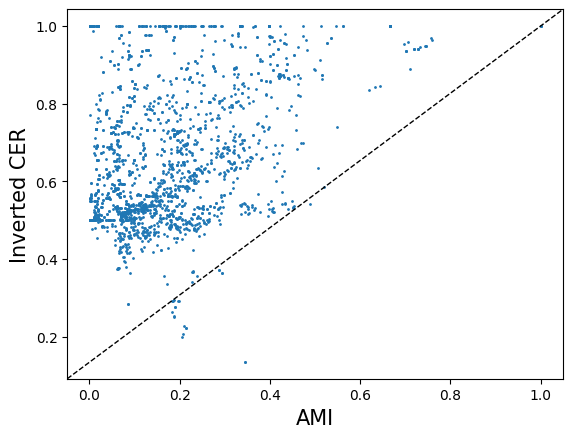

In [13]:
x_ami = []
y_inv_cer = []

for i in range(len(metrics)):
    x_ami.append(np.mean(metrics[i]['adj_mut_info']))
    y_inv_cer.append(np.mean(1-metrics[i]['cer']))

fig, ax = plt.subplots()
plt.scatter(x_ami, y_inv_cer, s=1)
plt.xlabel('AMI', fontsize=15)
plt.ylabel('Inverted CER', fontsize=15)

ax.plot([0, 1], [0, 1], transform=ax.transAxes, linestyle='dashed', color='black',linewidth=1)
plt.savefig(f'{save_path}correlation.eps', format='eps', dpi=1200)
plt.show()

## Range Plots

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 328.74it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 332.55it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 328.06it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 348.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 353.17it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 353.27it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 392.41it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 380.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 381.87it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 403.56it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 401.57it/s]
/tmp/ipykernel_490762/37524950.py:65: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency;

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 400.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 401.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 400.38it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 392.68it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 393.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 393.26it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 403.46it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 401.97it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 395.44it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 280.42it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 283.03it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 276.83it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 359.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 369.55it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 363.61it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 471.28it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 458.14it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 459.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 368.72it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 371.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 368.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 375.06it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 375.32it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 370.59it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 334.24it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 336.97it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 335.99it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 492.21it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 493.47it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 473.07it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 542.43it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 545.44it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 542.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 540.54it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 539.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 538.42it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 551.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 546.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 551.81it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 530.82it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 547.09it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 550.78it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 545.72it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 555.73it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 547.66it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 550.13it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 549.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 541.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 525.95it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 534.29it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 529.46it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 533.92it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 541.49it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 530.43it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 545.52it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 545.12it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 543.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 552.21it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 560.13it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 552.38it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 552.26it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.39it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 563.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 511.11it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 505.23it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 503.75it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 519.79it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 518.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 489.46it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 525.16it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 550.89it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 539.26it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 547.08it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 554.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 539.04it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.52it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 564.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 542.48it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 565.34it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 562.60it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 547.82it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 555.61it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 565.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 545.53it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 564.33it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 563.87it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 553.16it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 594.60it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "ozone.arff" and run.ratio_offline == 0.1 and "ECSMinerWF" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 596.07it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "ozone.arff" and run.ratio_offline == 0.1 and "ECSMiner" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 532.62it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 539.65it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 541.29it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 511.53it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 546.77it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 548.86it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 543.70it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 533.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 570.04it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 559.75it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.47it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.88it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 553.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 530.33it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 536.85it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 508.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 399.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 387.61it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 390.98it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 510.58it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 499.55it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 500.58it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 568.81it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "gassensor.arff" and run.wait_time_between_classes == 20000 and "ECSMinerWF" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.09it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "gassensor.arff" and run.wait_time_between_classes == 20000 and "ECSMiner" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 571.59it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "gassensor.arff" and run.wait_time_between_classes == 20000 and "Minas" in run.tags
4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 521.94it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 522.59it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 515.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 520.63it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 518.24it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 520.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 524.26it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 522.20it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 514.68it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 491.03it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 516.32it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 523.11it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 465.74it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 465.60it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 467.74it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 496.93it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 486.72it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 479.18it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 559.16it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 554.09it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 554.43it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 508.99it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 509.41it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 513.02it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 517.41it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 510.61it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 508.95it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 478.10it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 473.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 474.06it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:11<00:00, 220.55it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:11<00:00, 232.83it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:12<00:00, 210.78it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 526.38it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "powersupply.arff" and run.wait_time_between_classes == 5000 and "ECSMinerWF" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 522.31it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "powersupply.arff" and run.wait_time_between_classes == 5000 and "ECSMiner" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 484.99it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "powersupply.arff" and run.wait_time_between_classes == 5000 and "Minas" in run.tags
3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 519.49it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "powersupply.arff" and run.wait_time_between_classes == 20000 and "ECSMinerWF" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 526.48it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "powersupply.arff" and run.wait_time_between_classes == 20000 and "ECSMiner" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 526.86it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "powersupply.arff" and run.wait_time_between_classes == 20000 and "Minas" in run.tags
4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 423.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 432.01it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 395.10it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 424.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 436.36it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 419.62it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 421.39it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 415.53it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 418.12it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 423.10it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 432.36it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 419.93it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 331.08it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 351.90it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 326.93it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 389.59it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 407.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 389.55it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 458.93it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 468.87it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 458.61it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 386.85it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 407.58it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 384.90it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 384.45it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 402.80it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 385.07it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 386.36it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 403.73it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 379.74it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:13<00:00, 184.99it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:14<00:00, 181.49it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:14<00:00, 179.84it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:11<00:00, 229.65it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:11<00:00, 228.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:11<00:00, 224.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 419.34it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 419.60it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 416.10it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 295.72it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 299.17it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 296.99it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 295.94it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 297.20it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 282.28it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 295.55it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 298.19it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 298.03it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 297.08it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 301.70it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 296.54it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:14<00:00, 172.74it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:14<00:00, 173.15it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:14<00:00, 172.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 267.66it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 273.78it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 268.20it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 445.14it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 443.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 441.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 289.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 293.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 289.27it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:10<00:00, 256.16it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 260.19it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:10<00:00, 257.46it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:11<00:00, 223.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:11<00:00, 226.28it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:11<00:00, 224.81it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 316.59it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 315.01it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 291.68it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 503.14it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "outdoor.arff" and run.wait_time_between_classes == 5000 and "ECSMinerWF" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 502.47it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "outdoor.arff" and run.wait_time_between_classes == 5000 and "ECSMiner" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 503.29it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "outdoor.arff" and run.wait_time_between_classes == 5000 and "Minas" in run.tags
3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 500.95it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "outdoor.arff" and run.wait_time_between_classes == 20000 and "ECSMinerWF" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 504.00it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "outdoor.arff" and run.wait_time_between_classes == 20000 and "ECSMiner" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 507.56it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "outdoor.arff" and run.wait_time_between_classes == 20000 and "Minas" in run.tags
4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 501.19it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 496.54it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 483.72it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 496.23it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 500.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 483.33it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 493.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 498.86it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 480.49it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 497.72it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 451.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 492.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 437.84it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 438.70it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 426.59it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 468.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 476.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 442.56it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 520.50it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 524.16it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 514.64it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 463.46it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 463.74it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 446.01it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 467.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 467.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 408.48it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 492.00it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 494.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 478.83it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 491.45it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 494.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 492.89it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 576.12it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "keystroke.arff" and run.wait_time_between_classes == 5000 and "ECSMinerWF" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 574.17it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "keystroke.arff" and run.wait_time_between_classes == 5000 and "ECSMiner" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 575.80it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "keystroke.arff" and run.wait_time_between_classes == 5000 and "Minas" in run.tags
3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 576.00it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "keystroke.arff" and run.wait_time_between_classes == 20000 and "ECSMinerWF" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 578.22it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "keystroke.arff" and run.wait_time_between_classes == 20000 and "ECSMiner" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 577.60it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "keystroke.arff" and run.wait_time_between_classes == 20000 and "Minas" in run.tags
4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 577.88it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 580.85it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 573.18it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 575.99it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 572.81it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.62it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 572.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 570.38it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 568.27it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 572.80it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 571.36it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 572.46it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 562.15it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 554.52it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 558.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 564.55it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 560.87it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 574.35it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 575.02it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 574.60it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 566.21it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 497.73it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 559.73it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 557.06it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 563.45it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 557.60it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 574.20it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 571.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 574.63it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 400.67it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 421.37it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 399.33it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 428.20it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 451.26it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 427.17it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 496.82it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 505.21it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 503.10it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 482.56it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 496.24it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 479.90it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 482.16it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 494.17it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 480.55it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 478.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 493.00it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 480.97it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 491.11it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 507.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 488.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 419.48it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 475.59it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 425.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 446.90it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 445.72it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 444.75it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 508.01it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 504.86it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 507.15it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 476.63it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 503.36it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 478.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 478.34it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 499.54it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 484.14it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 415.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 428.39it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 415.19it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 272.28it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 272.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 573.09it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.wait_time_between_classes == 0 and "Minas" in run.tags
2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 287.09it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 285.90it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 572.15it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.wait_time_between_classes == 5000 and "Minas" in run.tags
3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 487.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 482.78it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 575.04it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.wait_time_between_classes == 20000 and "Minas" in run.tags
4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 375.54it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 376.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 589.57it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.sparsity == 0.1 and "Minas" in run.tags
5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 375.34it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 377.51it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 596.19it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.sparsity == 1 and "Minas" in run.tags
6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 374.37it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 378.36it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 596.26it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.sparsity == 100 and "Minas" in run.tags
7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 378.80it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 380.20it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 598.11it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.sparsity == 1000 and "Minas" in run.tags
8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:10<00:00, 246.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:10<00:00, 247.14it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 591.55it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.ratio_offline == 0.1 and "Minas" in run.tags
9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 314.02it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 313.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 596.51it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.ratio_offline == 0.4 and "Minas" in run.tags
10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 594.30it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.ratio_offline == 0.7 and "ECSMinerWF" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 596.42it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.ratio_offline == 0.7 and "ECSMiner" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 595.19it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.ratio_offline == 0.7 and "Minas" in run.tags
11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 350.72it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 351.53it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 592.62it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.ratio_known_classes == 0.3 and "Minas" in run.tags
12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 347.88it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 349.64it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 587.74it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.ratio_known_classes == 0.5 and "Minas" in run.tags
13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 311.31it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 314.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 591.52it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "shuttle.csv" and run.ratio_known_classes == 0.7 and "Minas" in run.tags
1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 117.83it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 117.65it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:22<00:00, 116.58it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 118.18it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:22<00:00, 117.18it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 117.90it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 119.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 118.26it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 117.85it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 150.32it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 151.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 151.41it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 151.27it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 151.20it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 150.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 151.19it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 150.87it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 151.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 150.75it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 150.97it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:17<00:00, 150.95it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|███████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:29<00:00, 87.54it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|███████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:29<00:00, 87.79it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|███████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:29<00:00, 87.63it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 120.38it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 120.52it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 120.82it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:13<00:00, 195.19it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:13<00:00, 196.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:13<00:00, 193.08it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 121.04it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 120.81it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 121.07it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 120.39it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 120.93it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 121.03it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 120.74it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 121.49it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:21<00:00, 120.32it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 482.95it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 422.23it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 417.62it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 554.01it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 527.80it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 524.55it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 572.45it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "room_occupancy.csv" and run.wait_time_between_classes == 20000 and "ECSMinerWF" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 571.91it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "room_occupancy.csv" and run.wait_time_between_classes == 20000 and "ECSMiner" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 576.69it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "room_occupancy.csv" and run.wait_time_between_classes == 20000 and "Minas" in run.tags
4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 570.77it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 537.41it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 540.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 564.48it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 532.71it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 534.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.77it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 533.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 532.00it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 563.64it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 532.24it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 532.34it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 593.22it/s]


max() arg is an empty sequence
Exception in query: run.experiment == "room_occupancy.csv" and run.ratio_offline == 0.1 and "ECSMinerWF" in run.tags


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 485.95it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 490.32it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 525.21it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 516.56it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 516.33it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 547.74it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 549.33it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 545.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 565.44it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 532.92it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 535.65it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 558.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 530.97it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 529.90it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 540.62it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 489.85it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 492.14it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

1 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 272.26it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 344.65it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 259.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

2 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 328.65it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 432.29it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 312.56it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

3 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 447.77it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 508.13it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 441.41it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

4 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 378.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 454.53it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 368.32it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

5 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 382.66it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 450.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 327.19it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

6 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 388.83it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 462.35it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 375.99it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

7 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 404.72it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 486.78it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 392.16it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

8 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 281.74it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 524.43it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:10<00:00, 258.36it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

9 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 350.14it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 351.52it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 348.89it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

10 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 459.53it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 455.94it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 460.80it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

11 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 395.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 478.85it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 377.23it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

12 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 375.16it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 455.53it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:07<00:00, 361.74it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

13 / 13


100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:08<00:00, 295.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:06<00:00, 378.81it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:09<00:00, 286.06it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be 

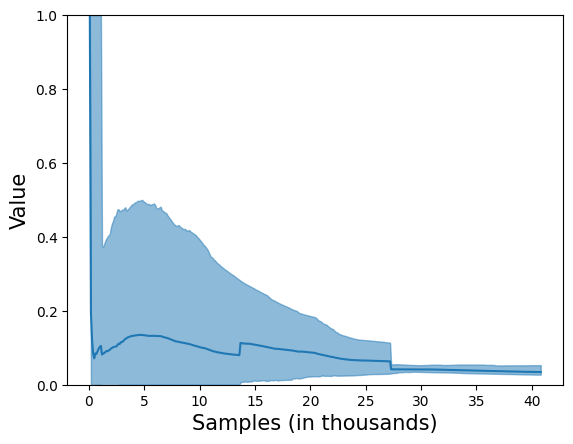

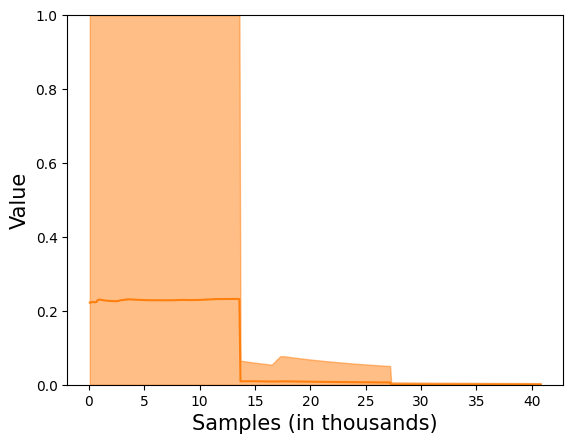

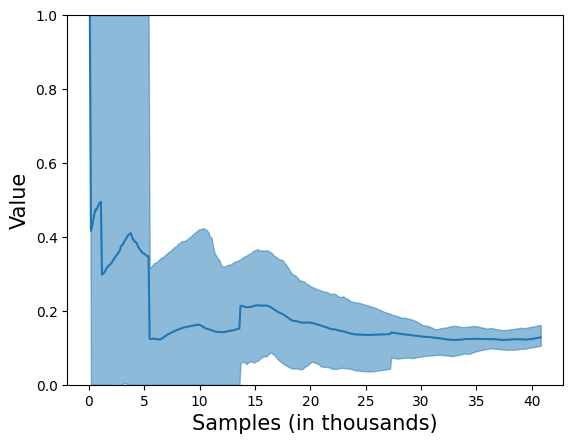

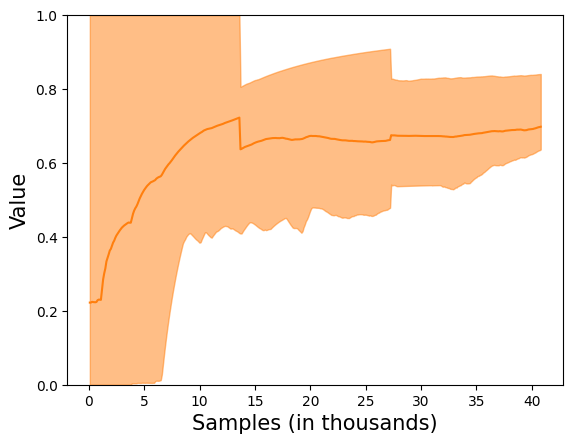

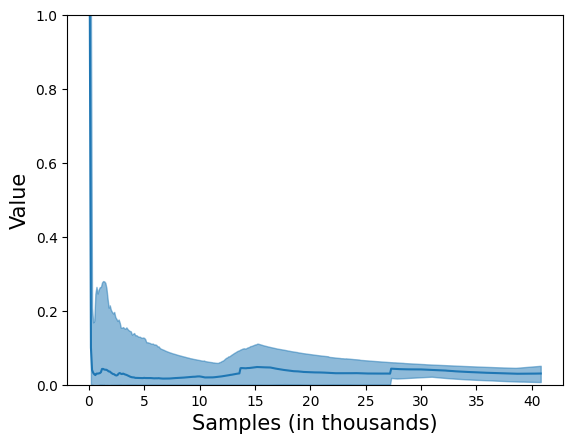

...

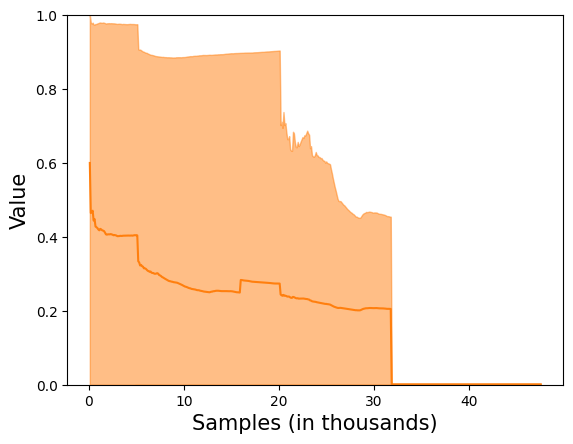

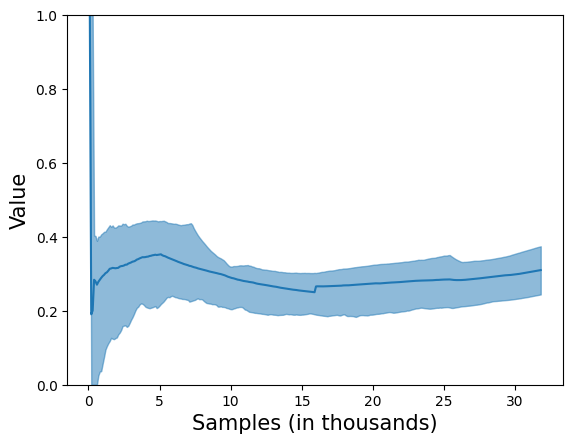

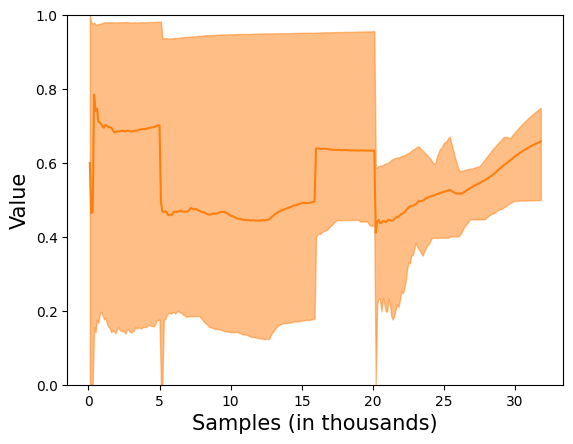

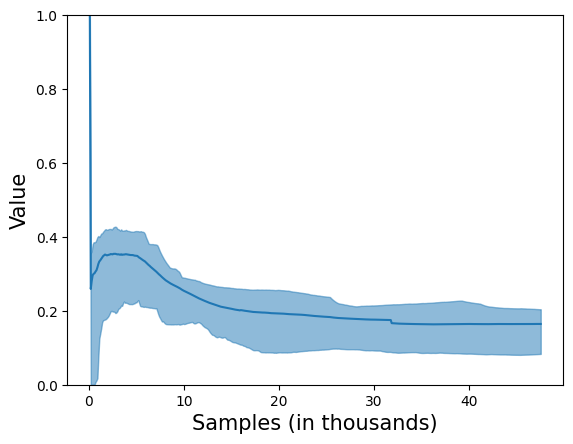

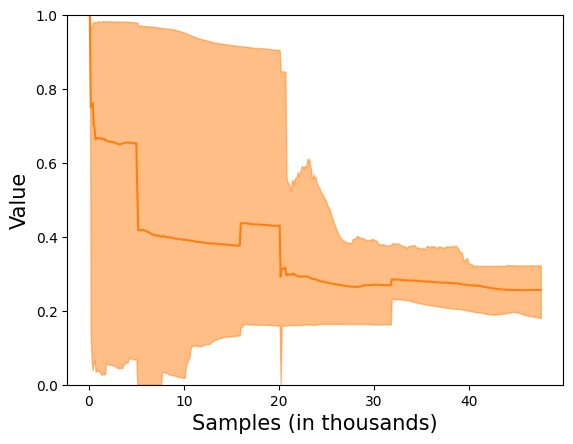

In [6]:
for dataset in datasets:
    for i, characteristic in enumerate(characteristics):
        print(str(i+1) +" / " + str(len(characteristics)))
        print_range_plots(dataset, characteristic, aim_repo, ['adj_mut_info', 'inv_harm_mean'], save_path)

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 538.46it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


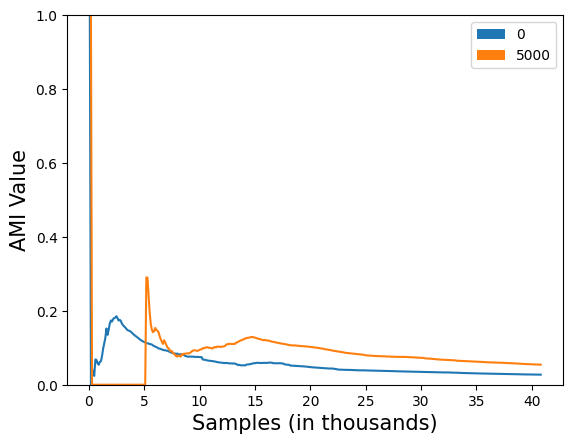

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 553.46it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


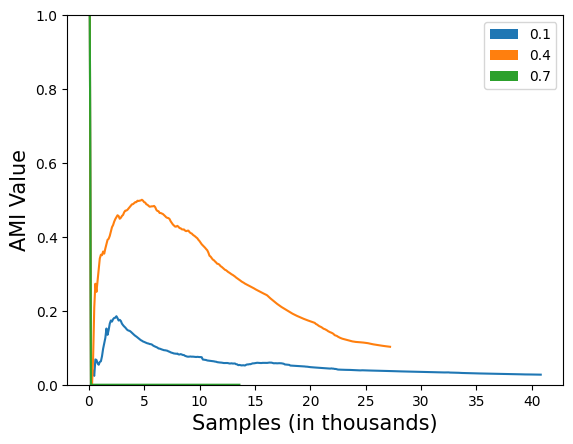

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 546.44it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


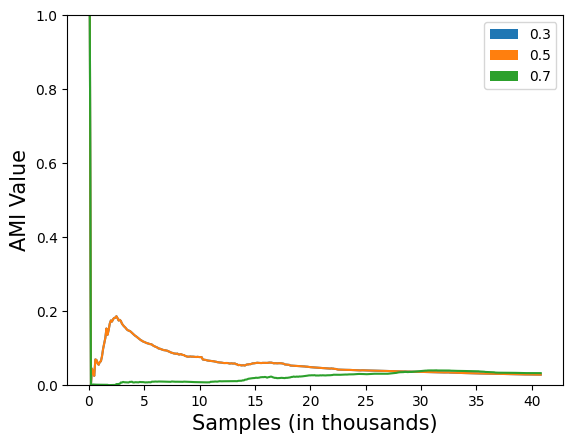

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 529.82it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


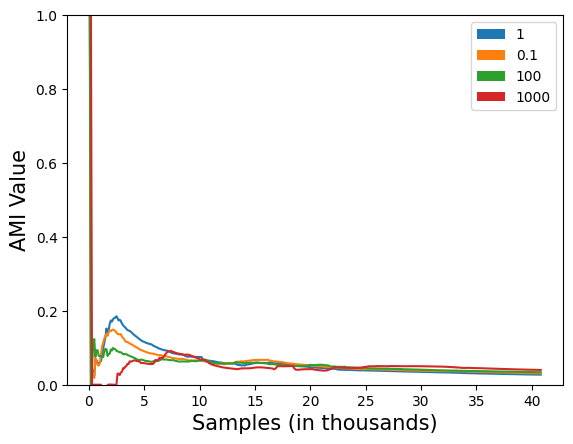

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 526.29it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


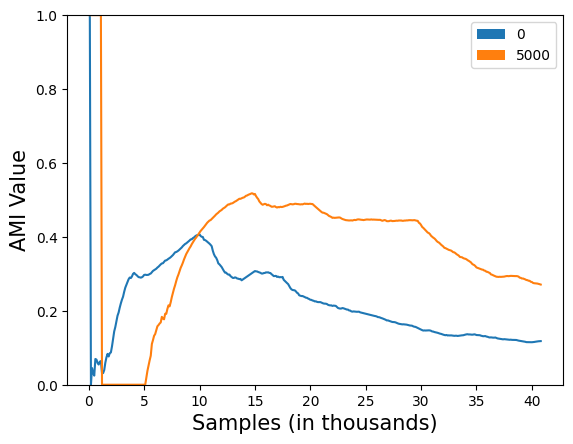

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 545.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


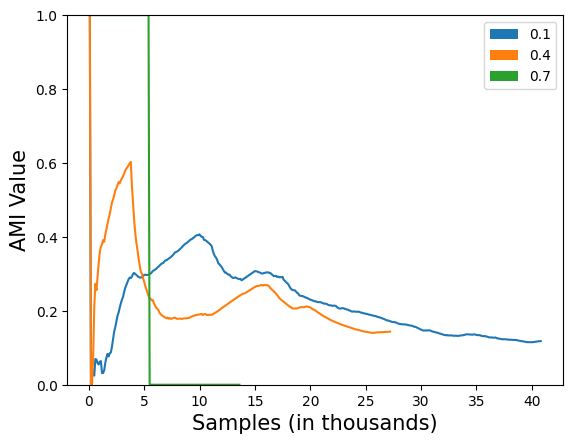

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 542.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


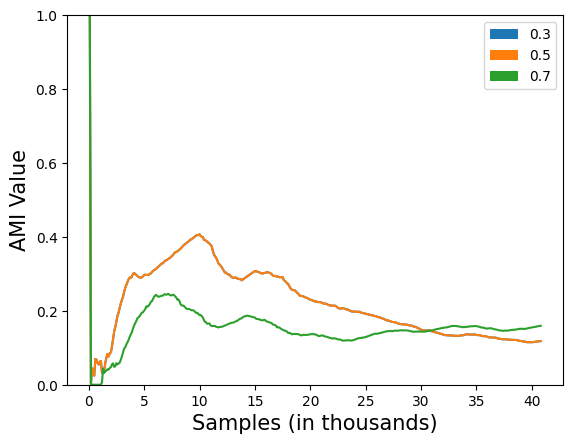

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 542.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


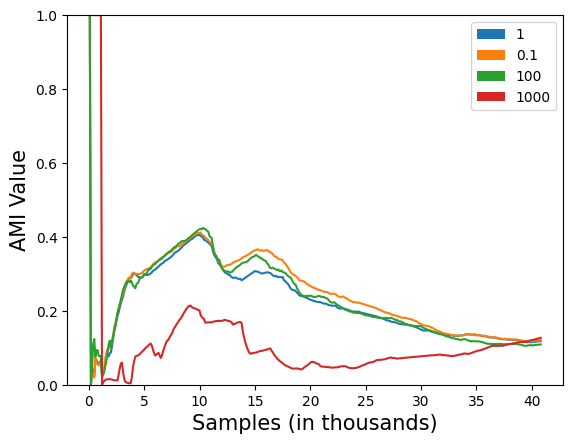

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 547.70it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


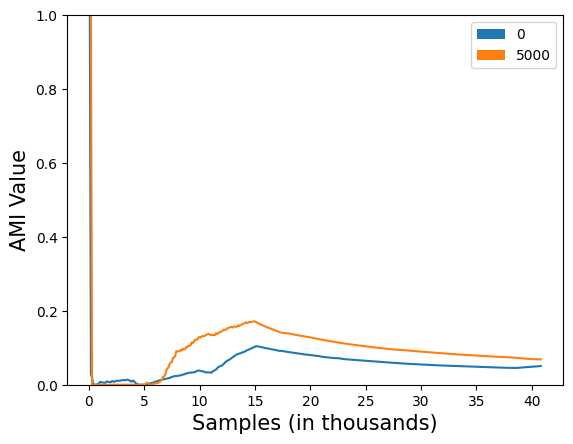

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 553.49it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


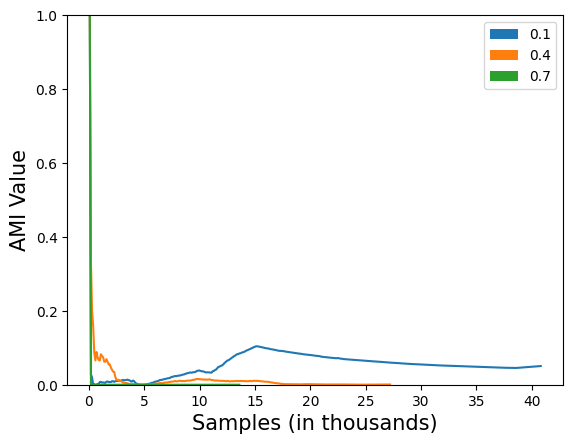

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 542.35it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


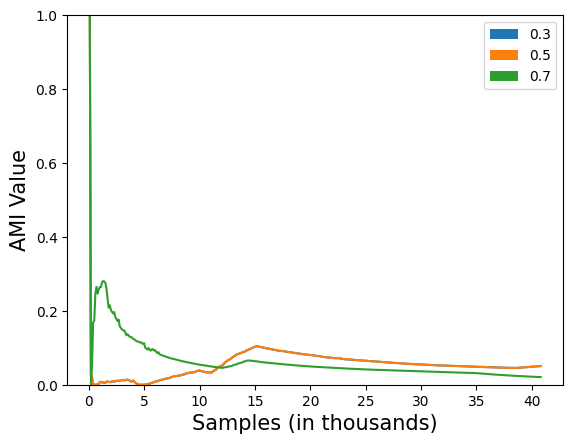

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 541.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


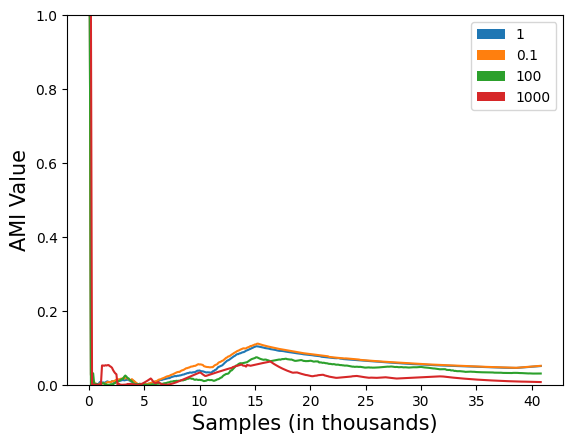

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.31it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


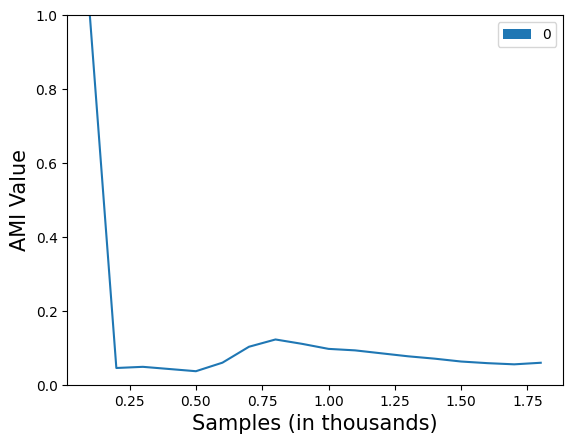

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 560.02it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


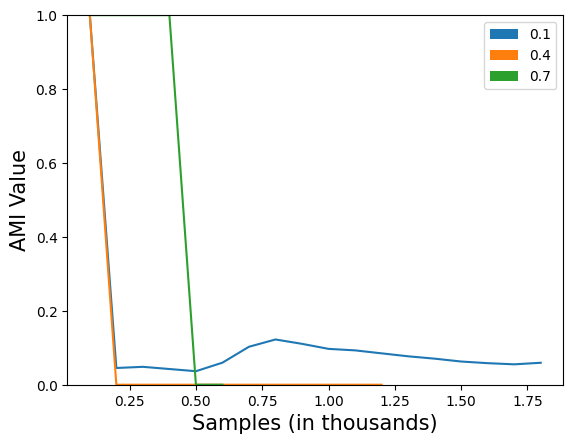

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 555.59it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


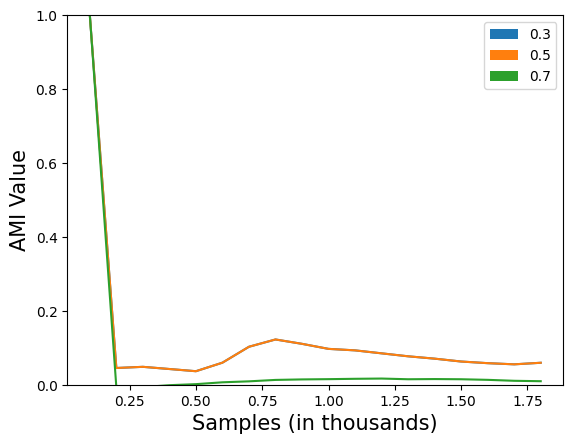

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 546.03it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


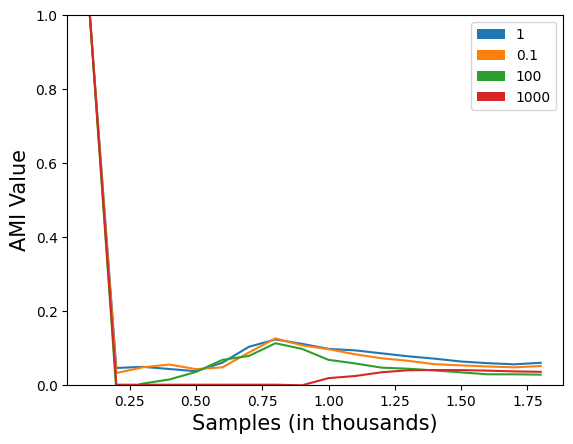

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.59it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


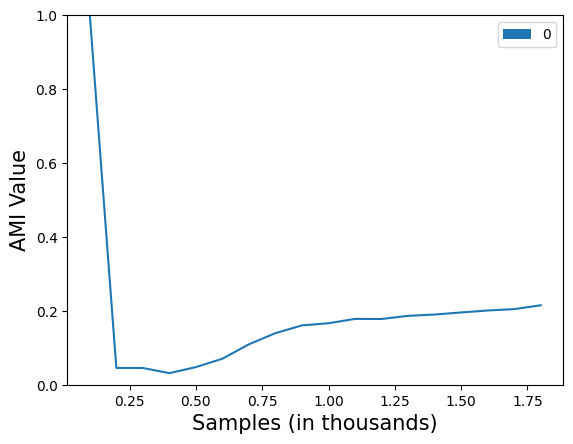

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 558.39it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


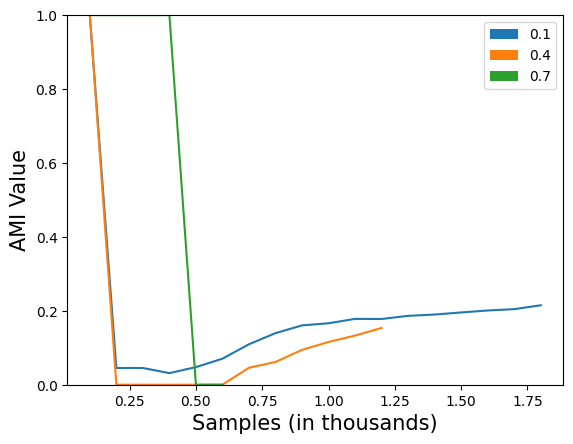

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 545.13it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


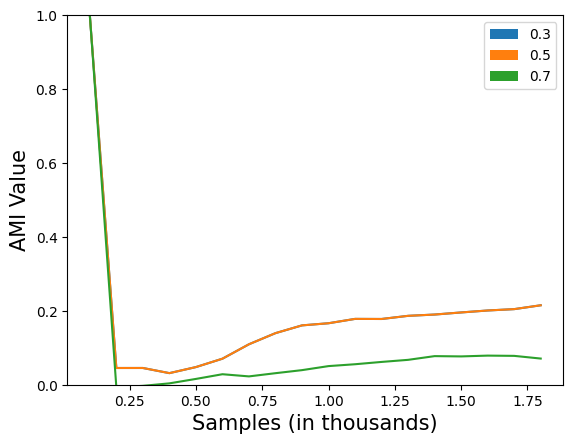

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 558.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


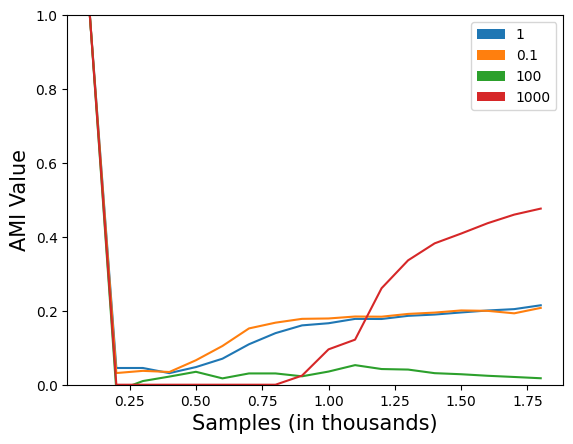

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.67it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


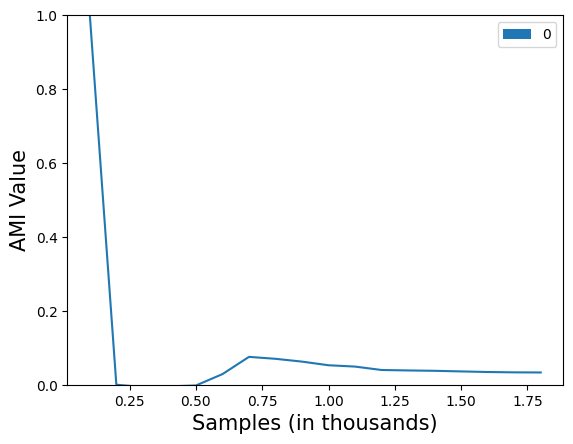

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 548.09it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


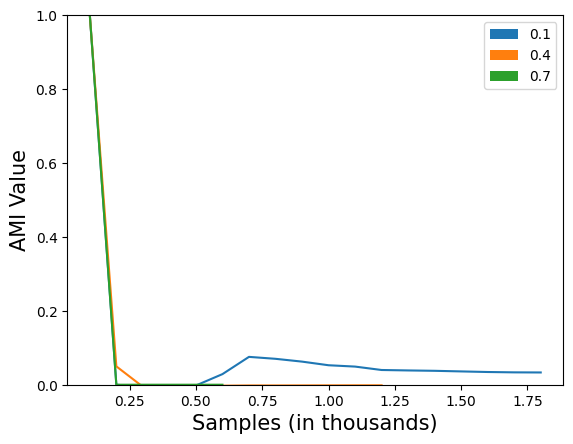

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


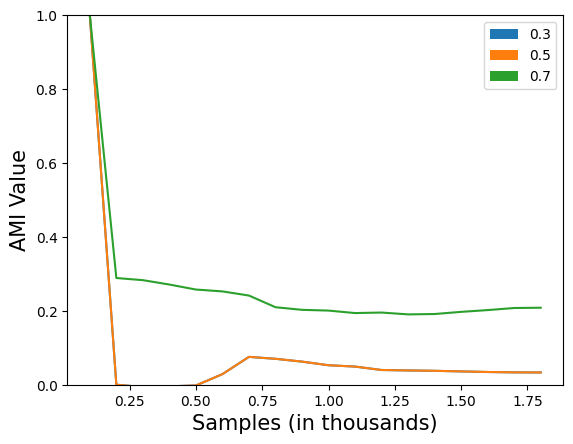

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 557.85it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


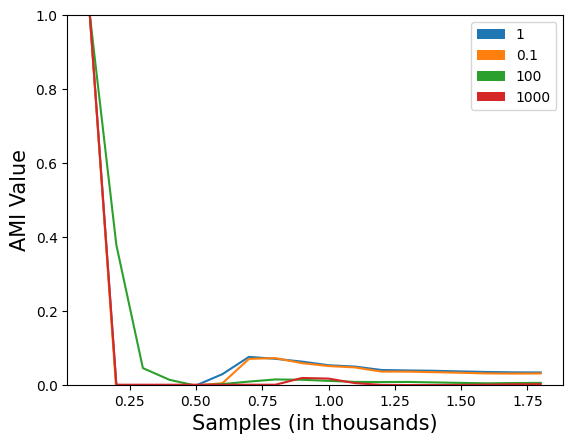

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 565.97it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


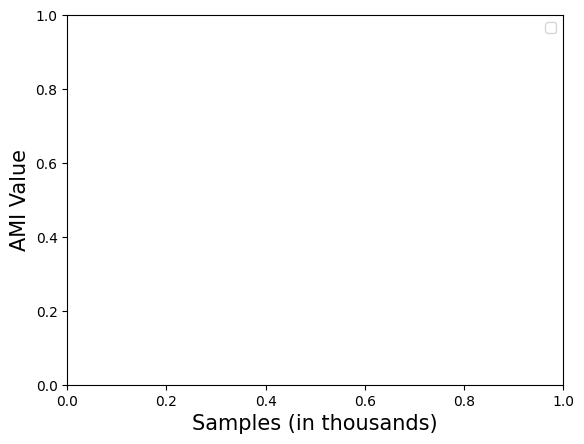

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.48it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


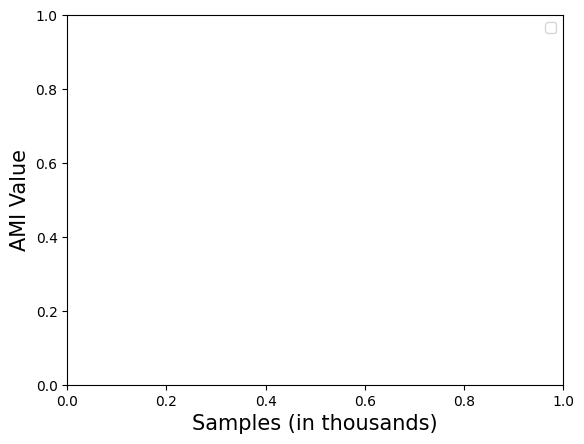

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 557.41it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


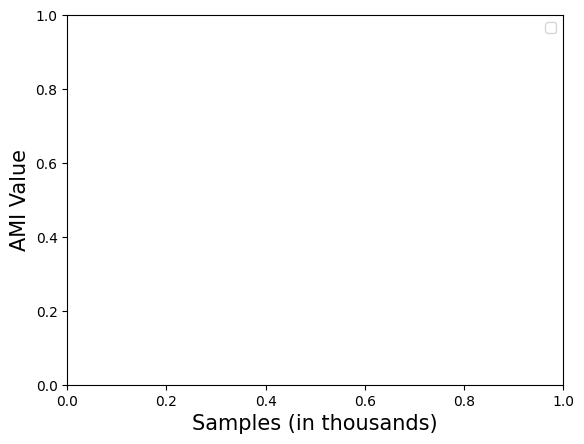

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 550.54it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


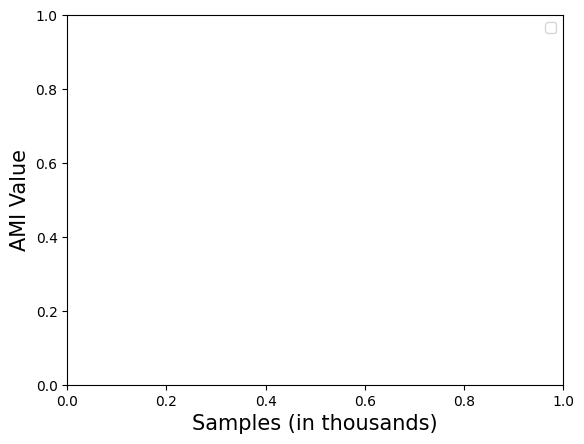

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 552.49it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


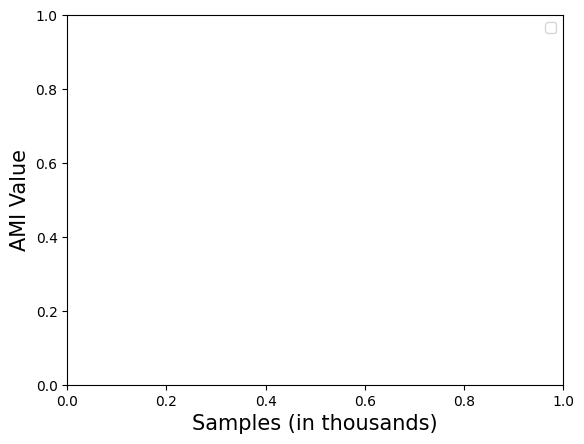

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 565.85it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


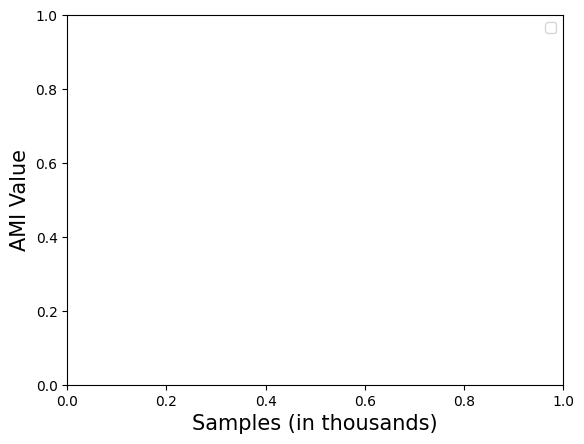

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 560.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


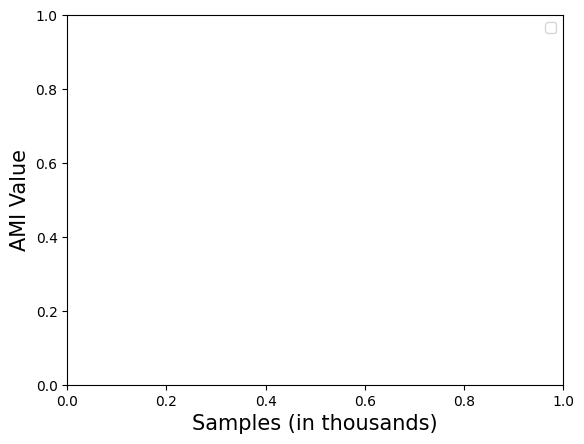

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 571.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


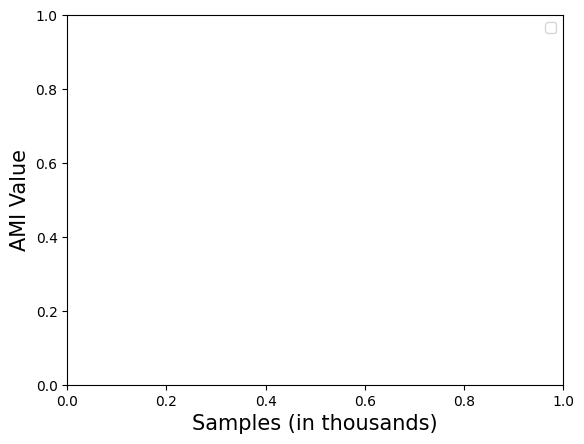

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 569.26it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


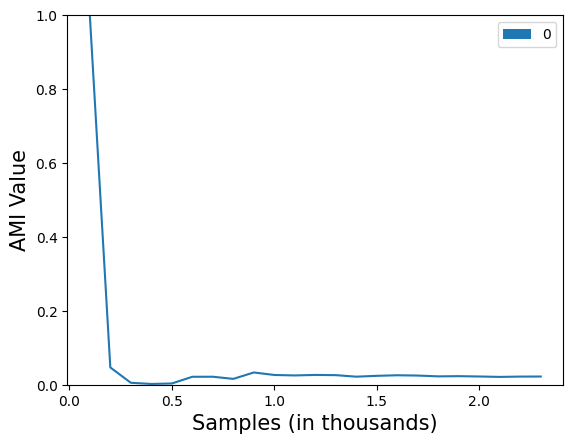

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 546.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


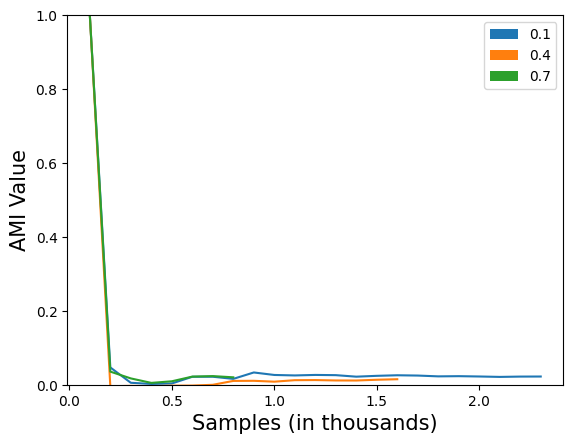

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 569.65it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


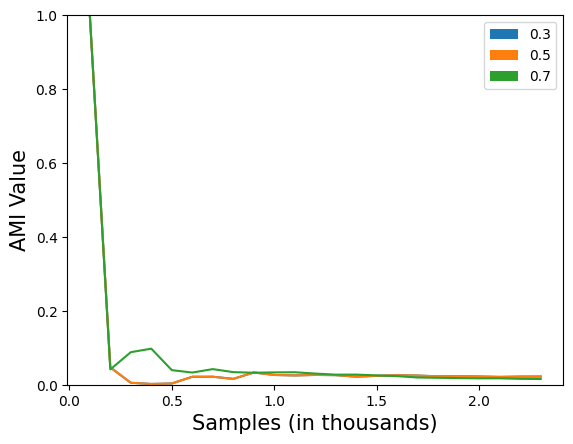

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.66it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


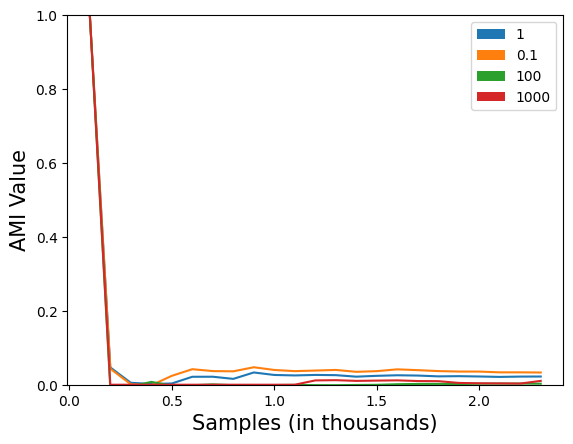

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


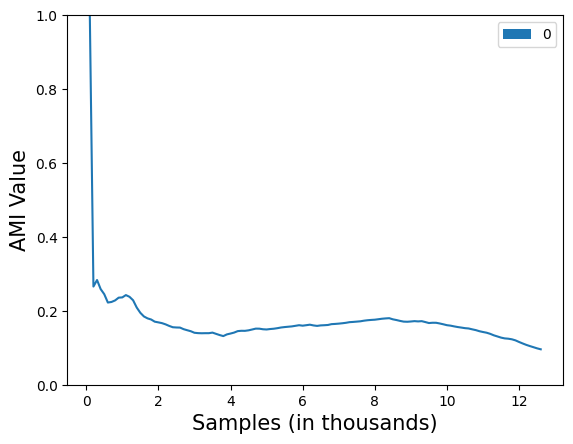

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 547.83it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


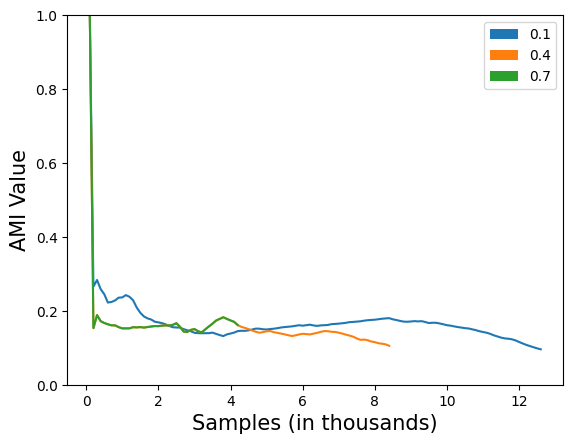

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 543.08it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


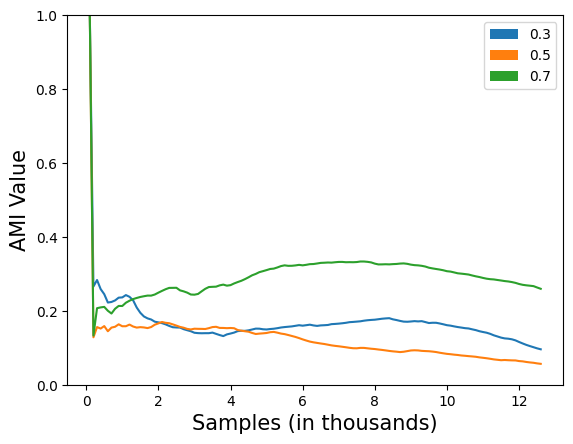

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 547.84it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


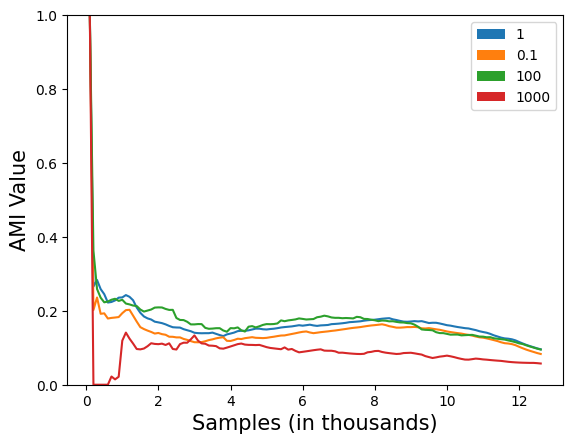

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 558.33it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


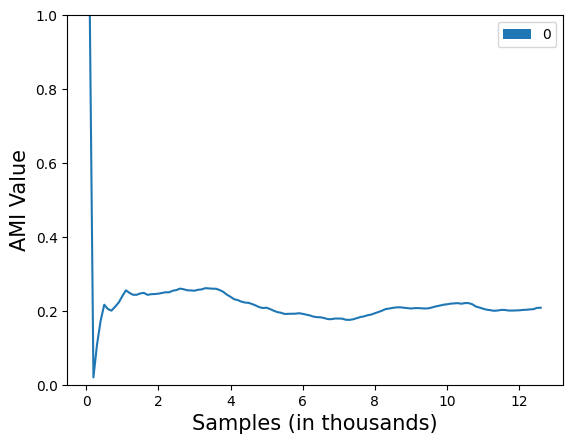

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 549.82it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


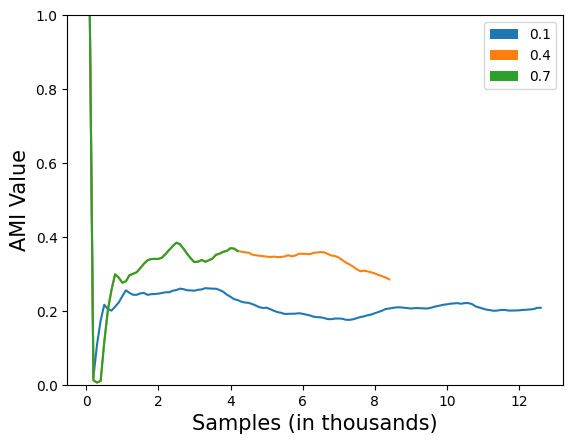

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 542.99it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


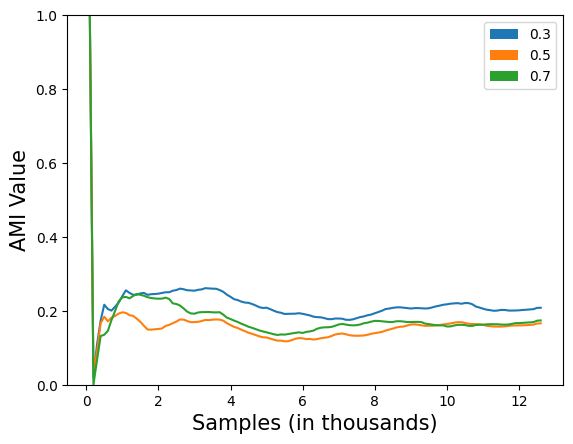

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 548.08it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


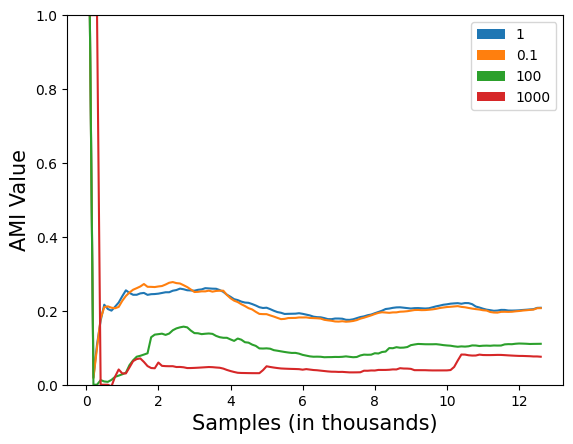

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 557.95it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


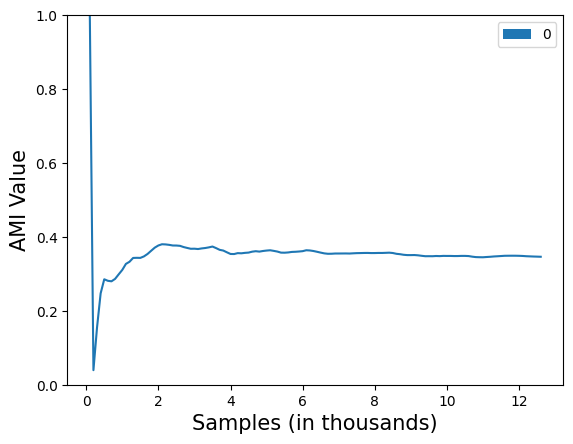

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 548.53it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


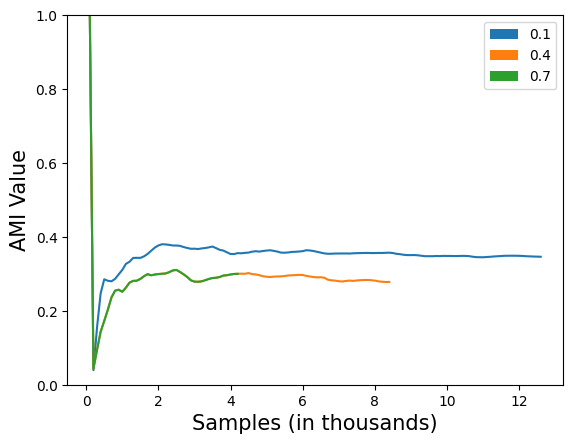

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 537.32it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


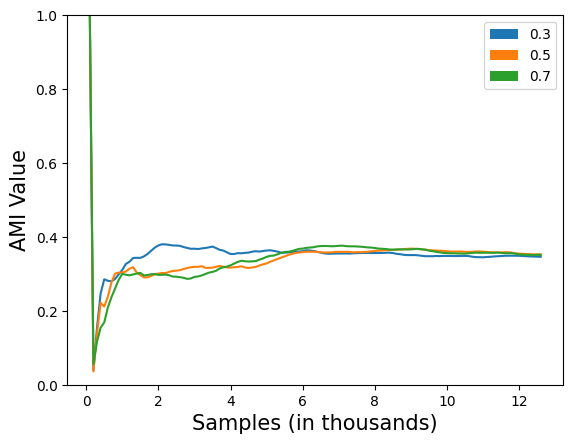

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 546.88it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


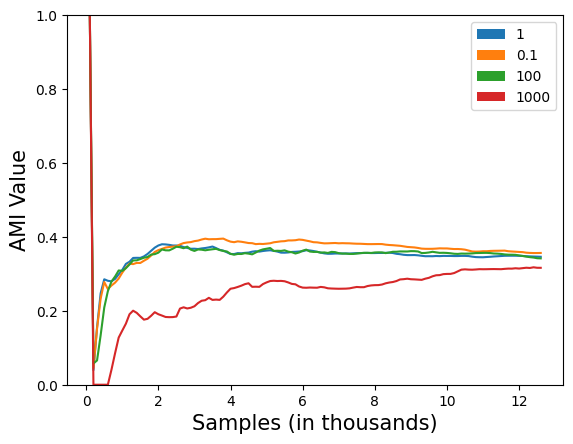

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 524.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


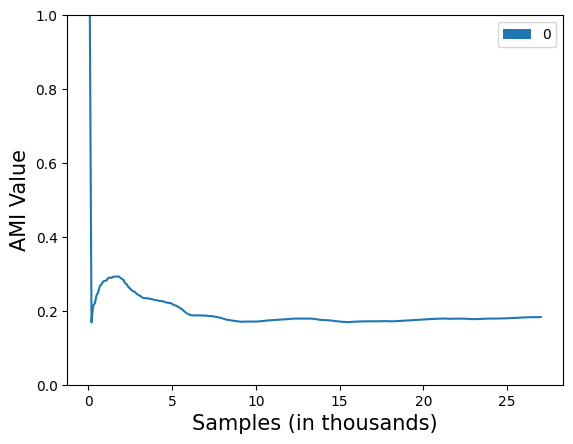

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 495.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


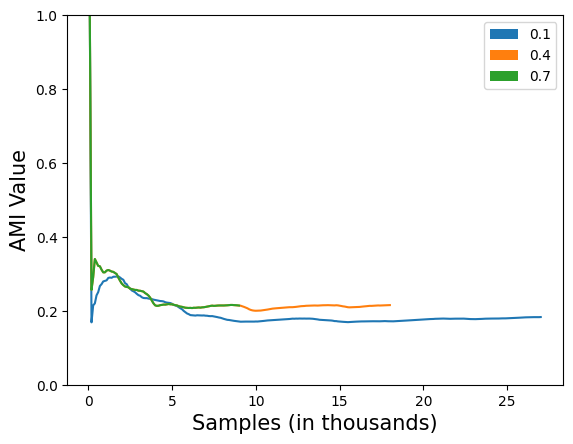

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 479.39it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


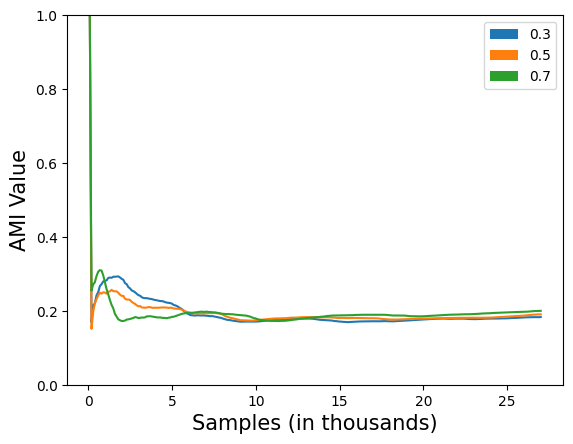

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 479.06it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


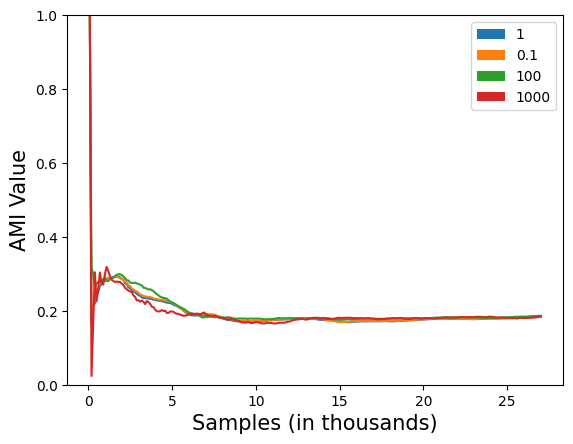

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 521.04it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


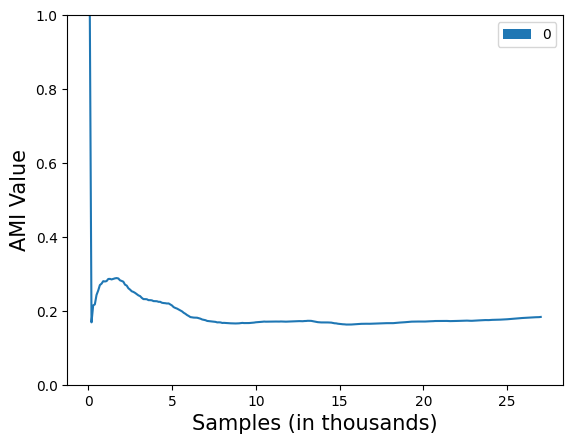

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 493.48it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


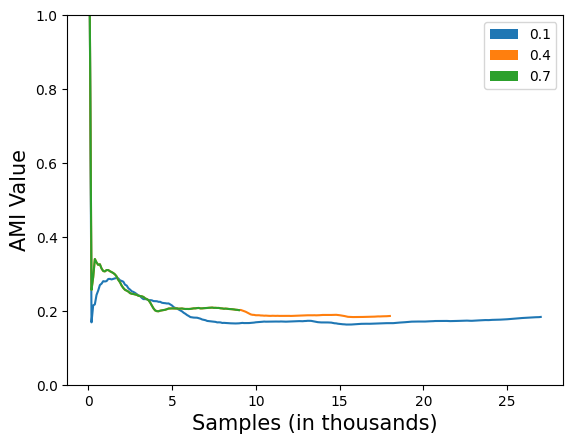

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 485.84it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


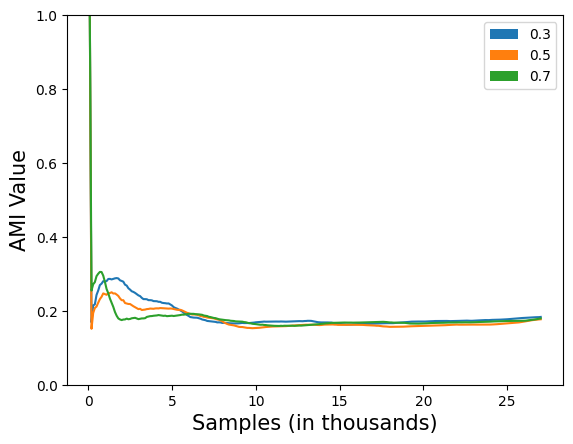

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 486.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


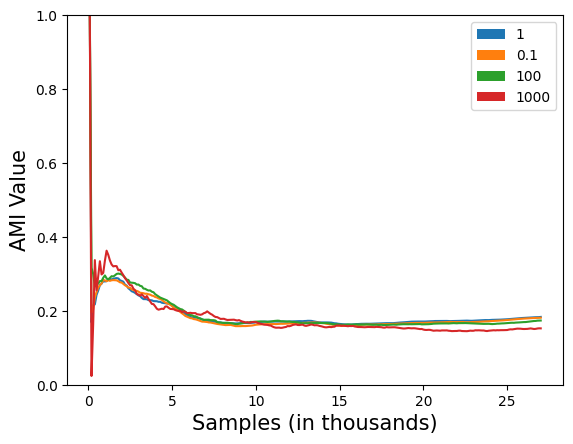

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 514.18it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


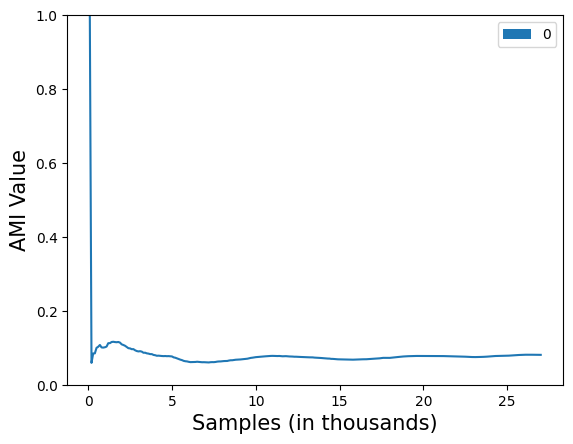

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 493.87it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


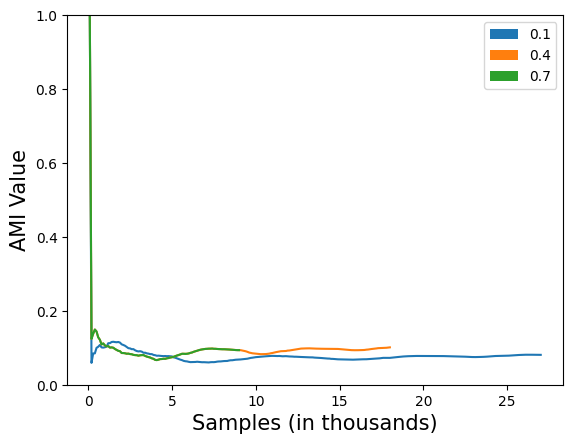

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 479.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


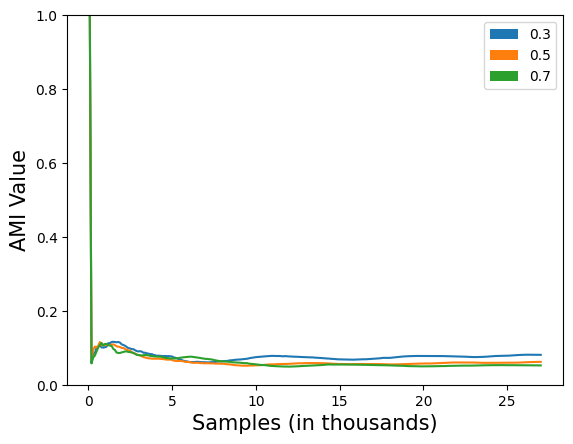

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 475.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


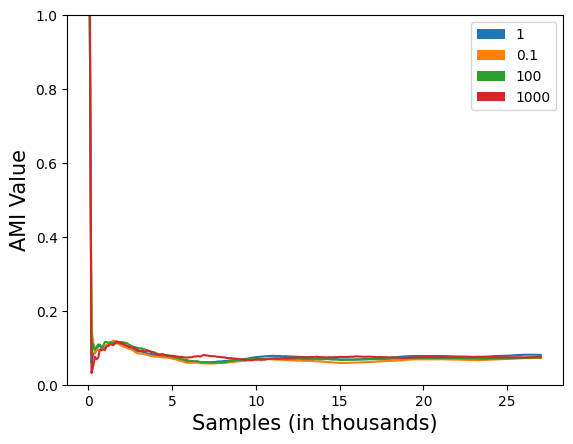

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 501.07it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


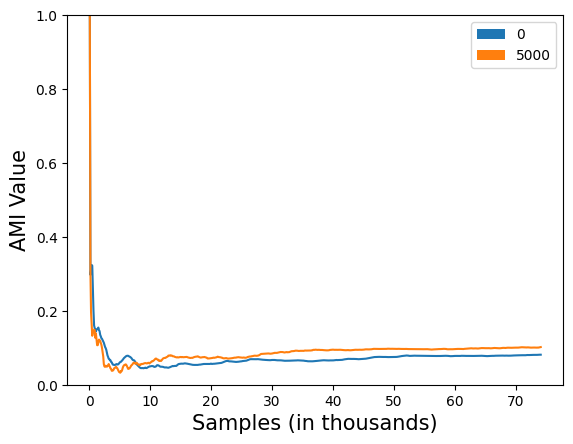

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 523.17it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


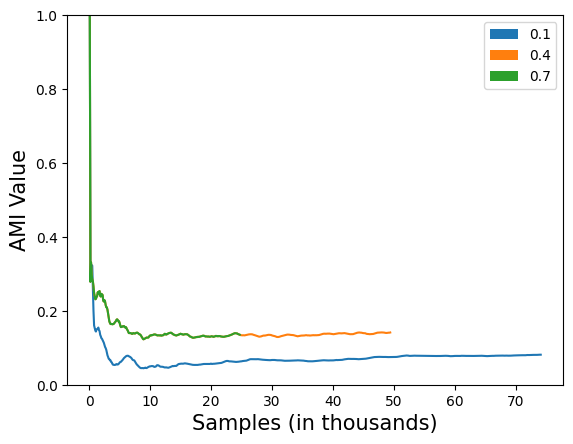

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 494.02it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


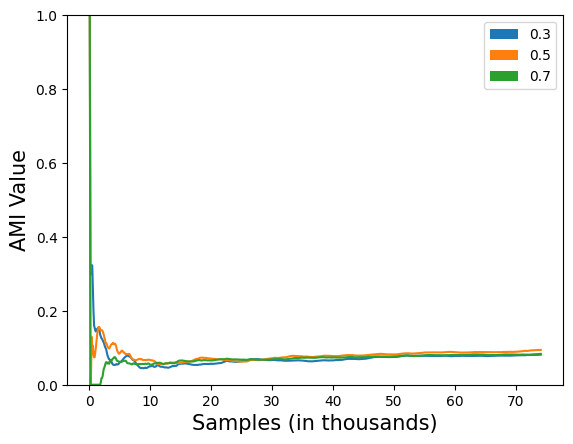

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 495.72it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


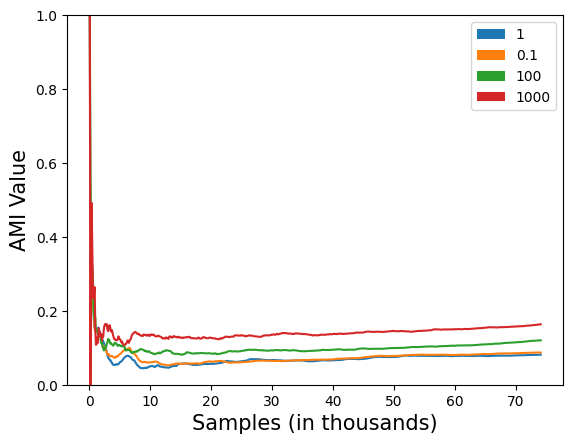

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 501.48it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


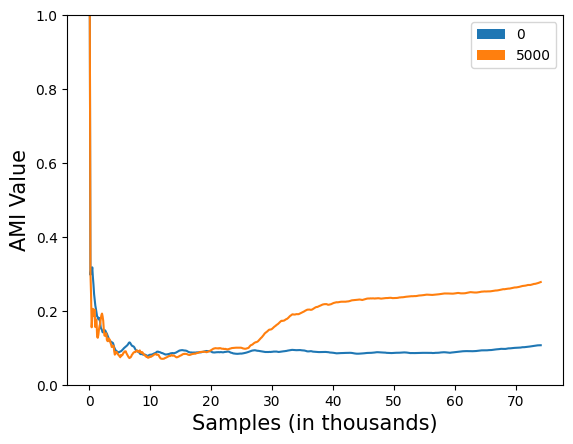

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 515.94it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


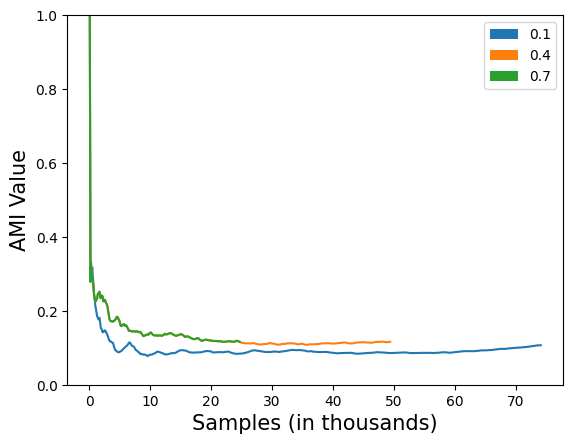

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 494.39it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


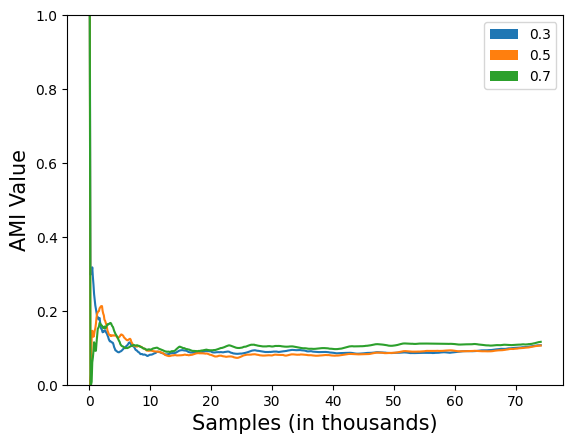

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 495.82it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


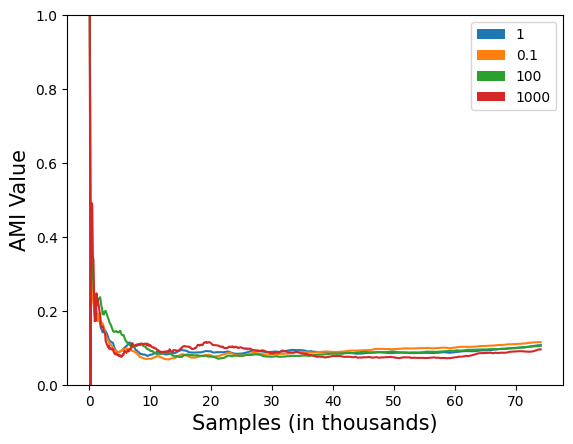

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 504.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


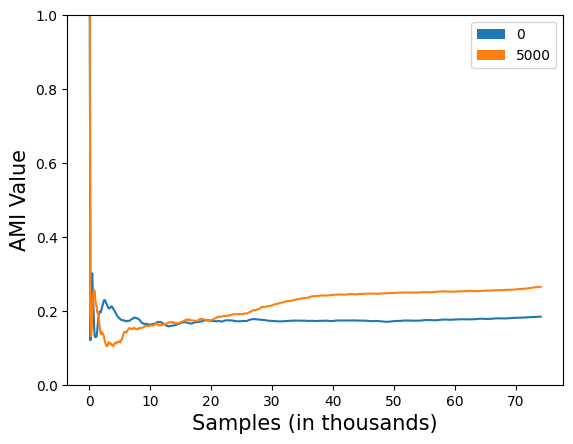

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 522.36it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


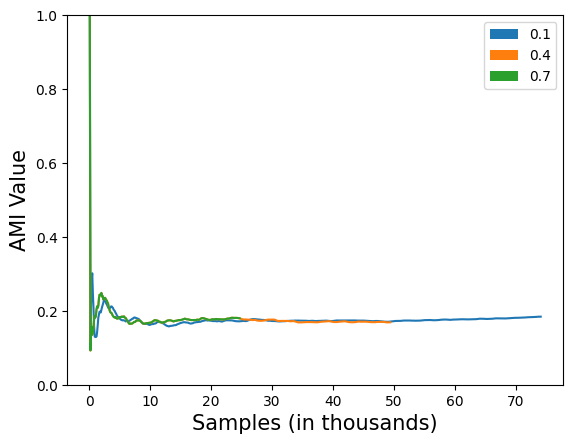

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 498.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


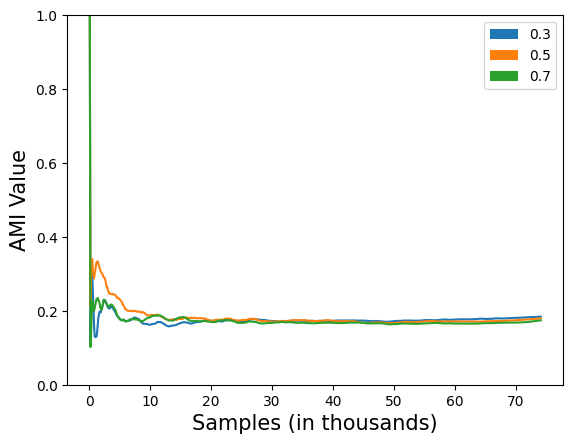

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 495.94it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


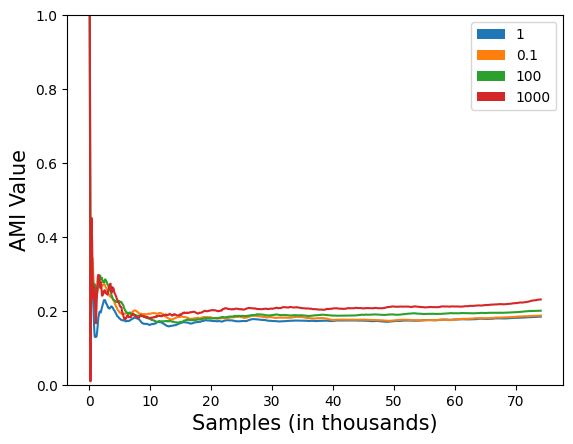

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 494.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


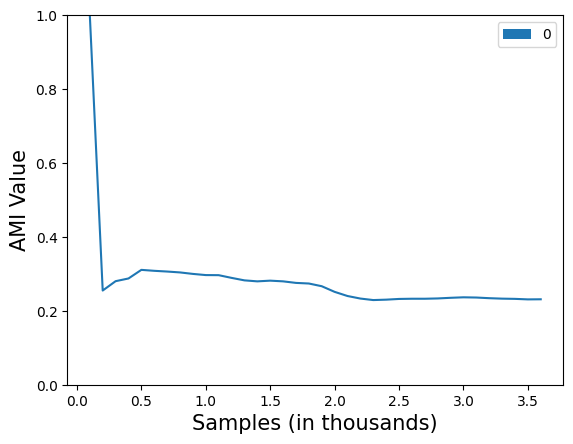

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 481.29it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


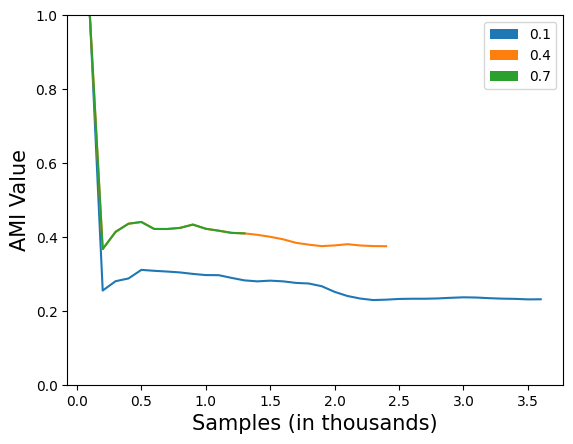

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 480.77it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


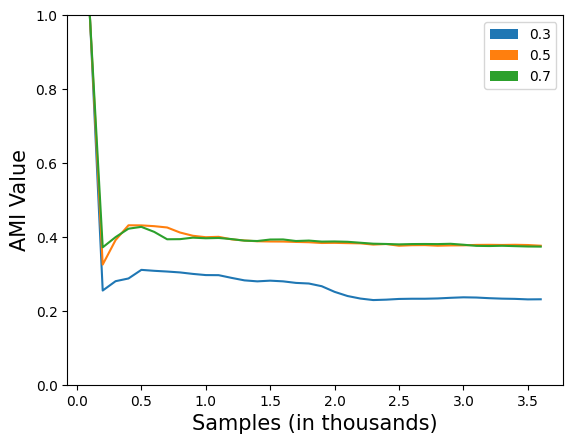

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 474.87it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


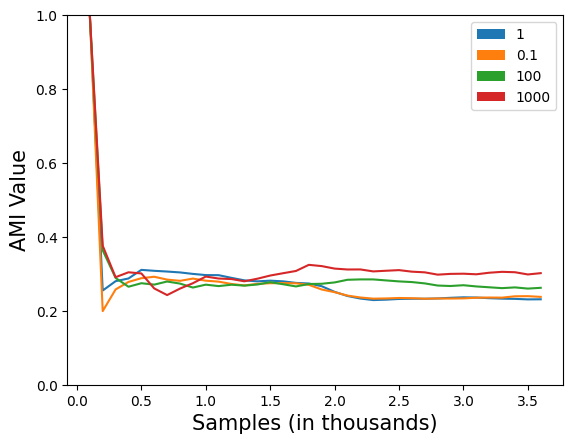

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 502.48it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


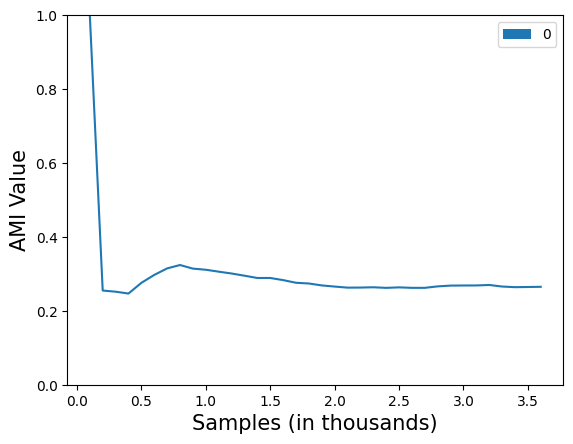

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 480.20it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


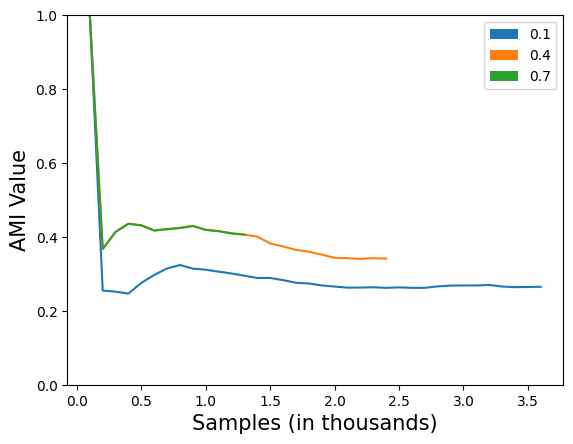

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 479.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


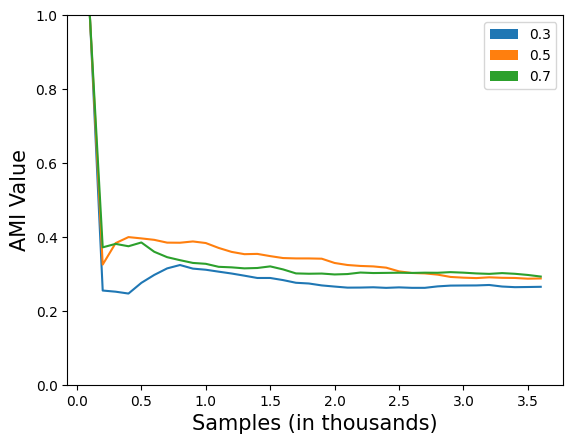

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 477.99it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


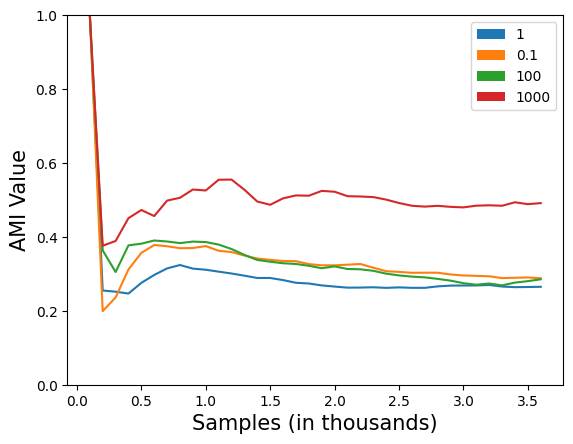

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 504.24it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


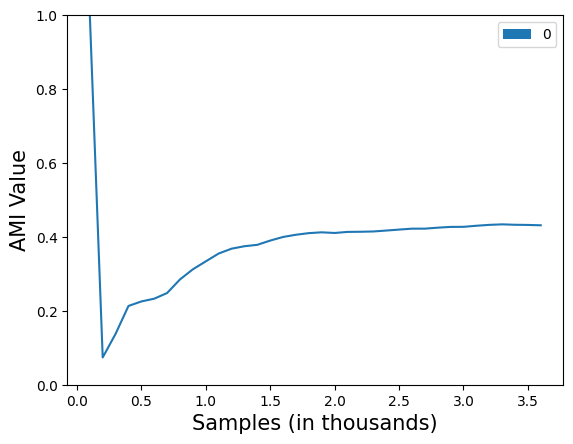

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 481.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


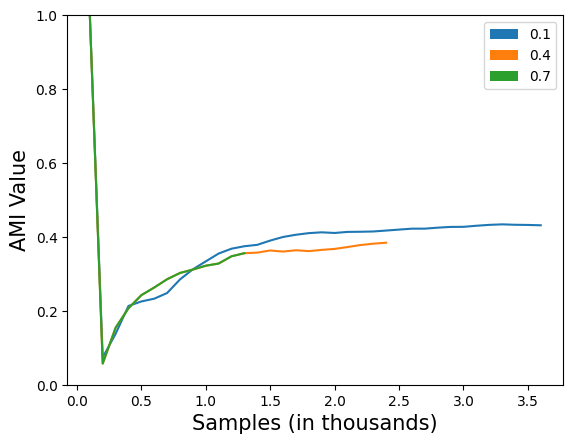

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 473.70it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


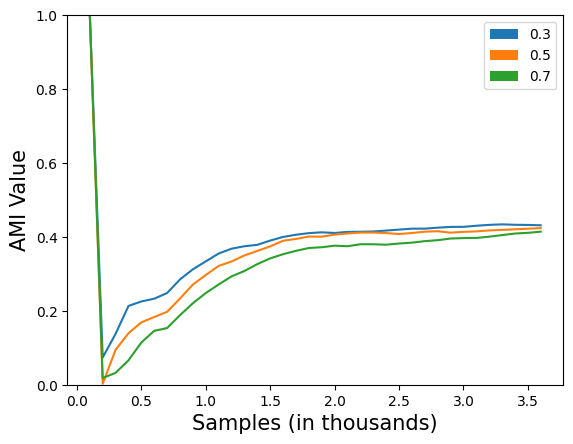

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 464.94it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


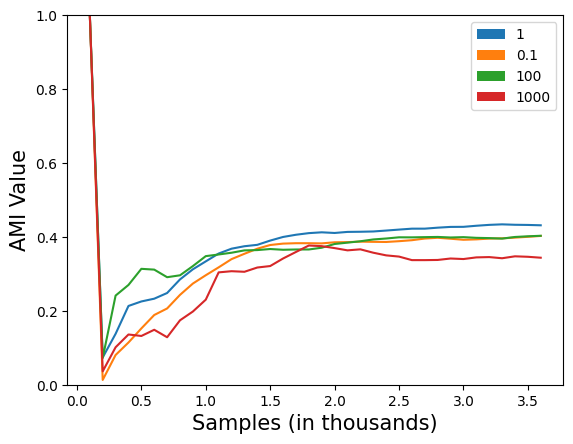

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 569.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


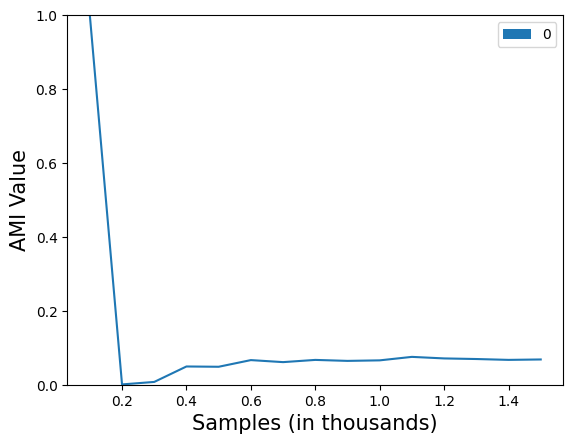

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 562.61it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


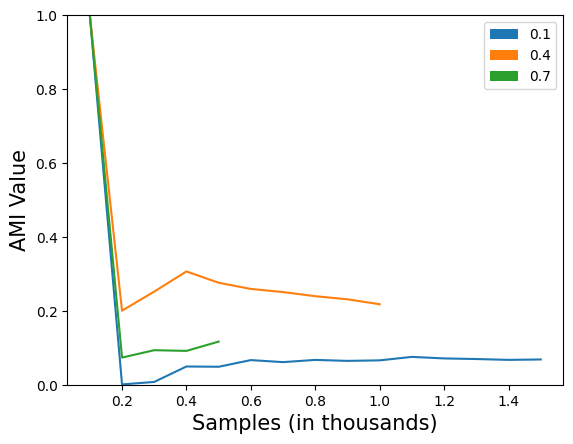

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 564.36it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


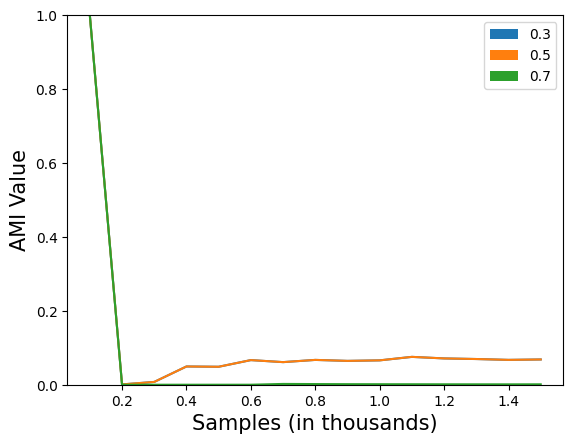

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 560.80it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


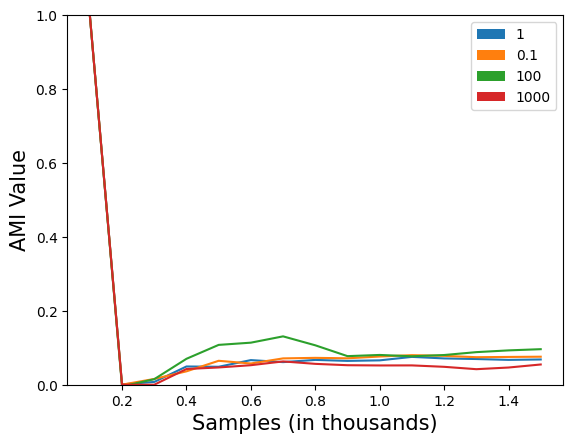

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 570.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


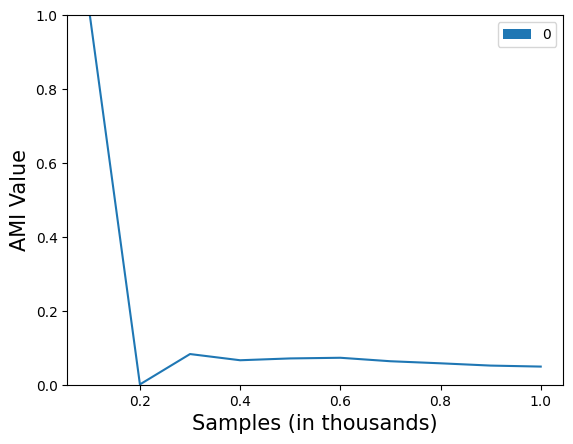

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.04it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


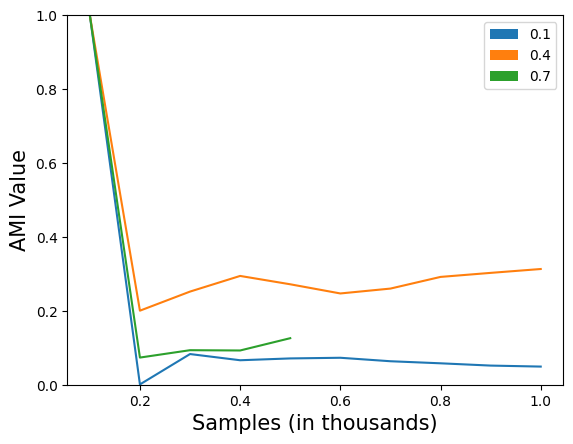

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 562.51it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


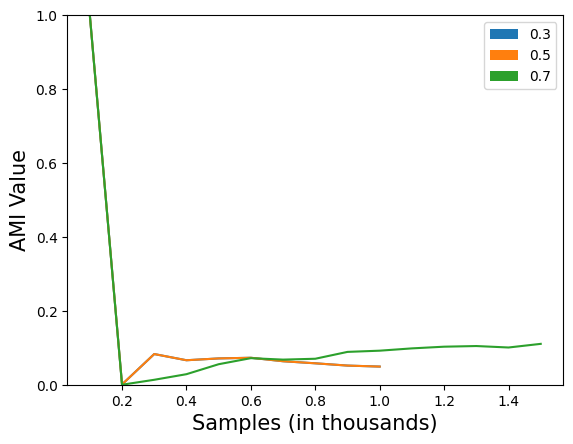

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


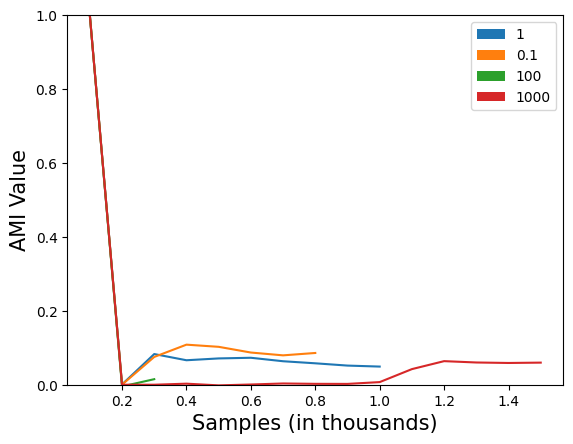

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.99it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


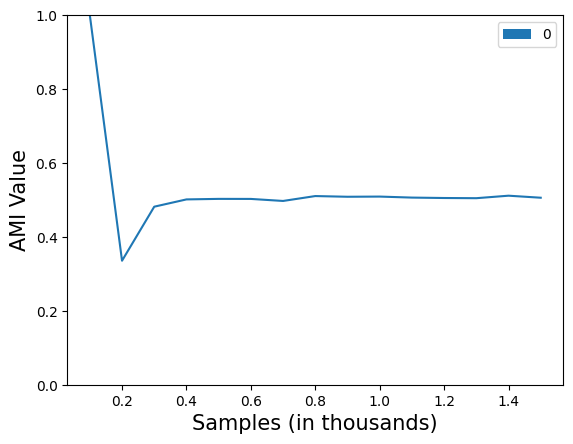

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 547.49it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


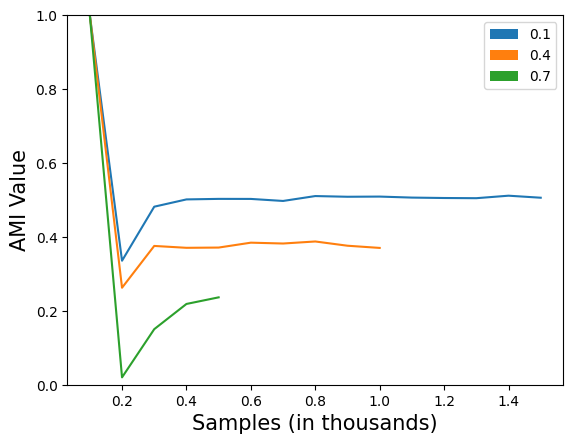

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 563.49it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


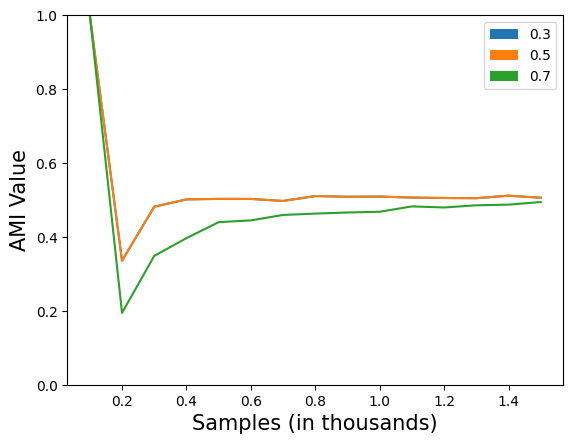

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 558.50it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


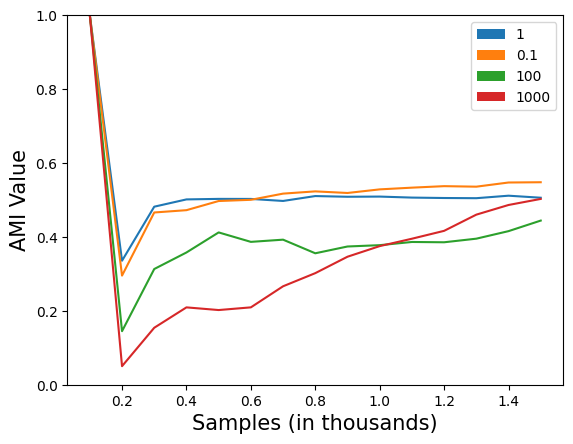

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 555.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


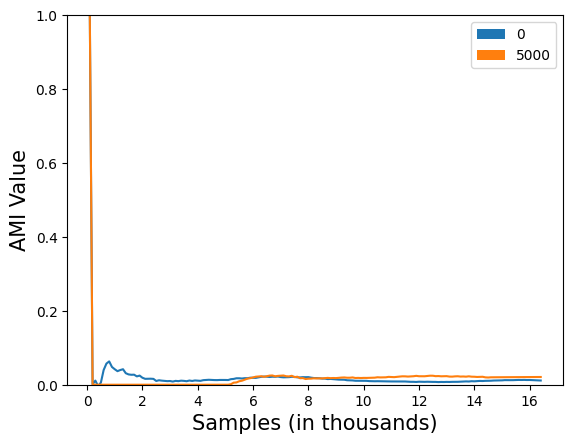

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 553.81it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


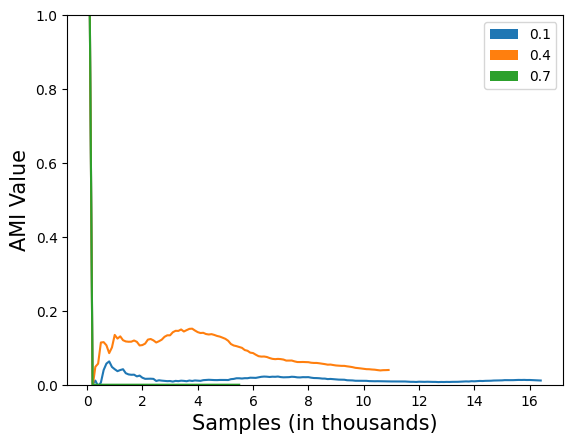

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 550.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


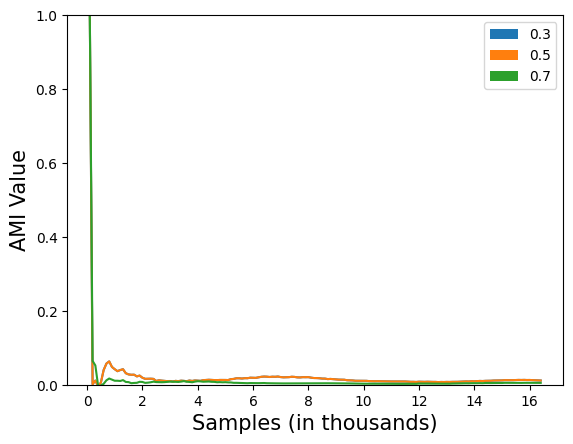

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 553.47it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


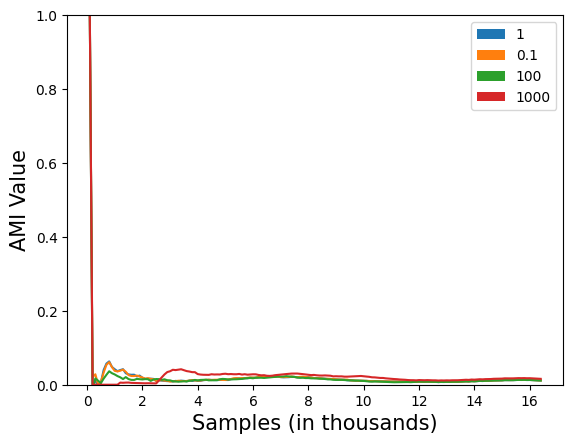

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 554.26it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


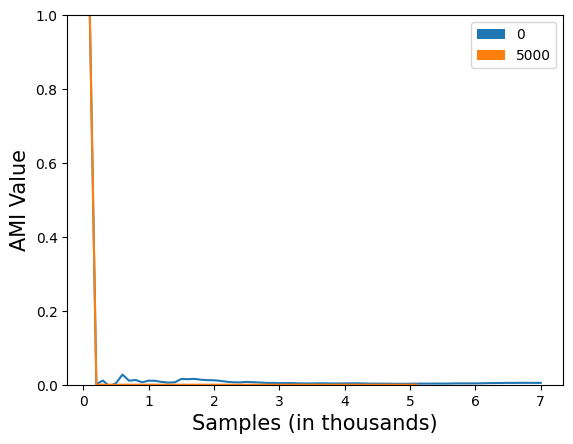

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 557.62it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


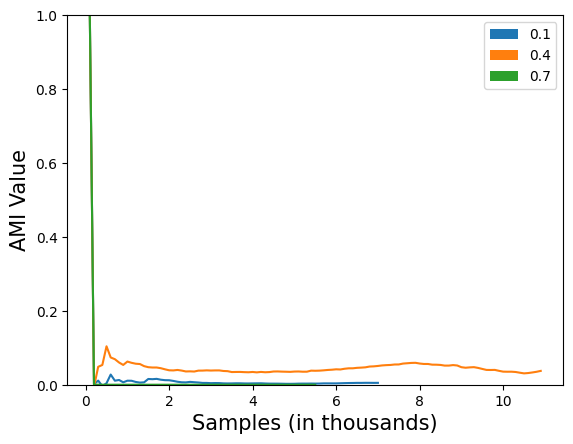

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 543.42it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


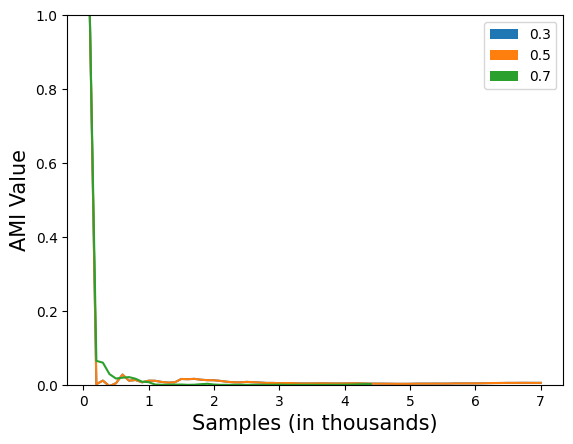

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 557.00it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


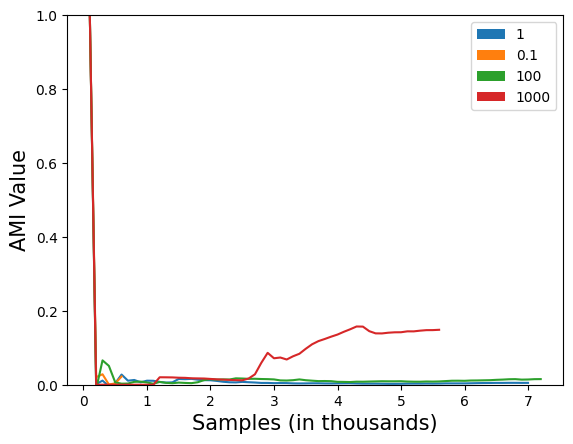

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 548.62it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


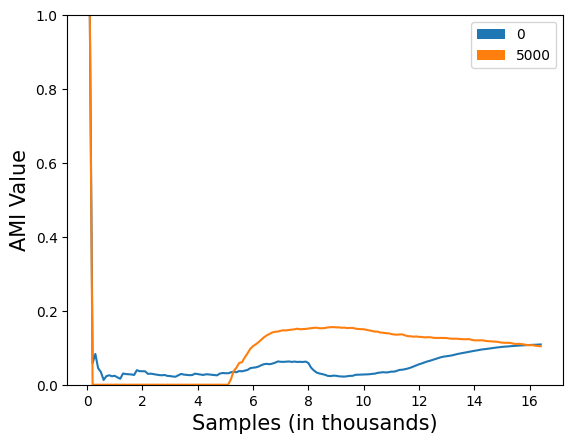

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 557.80it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


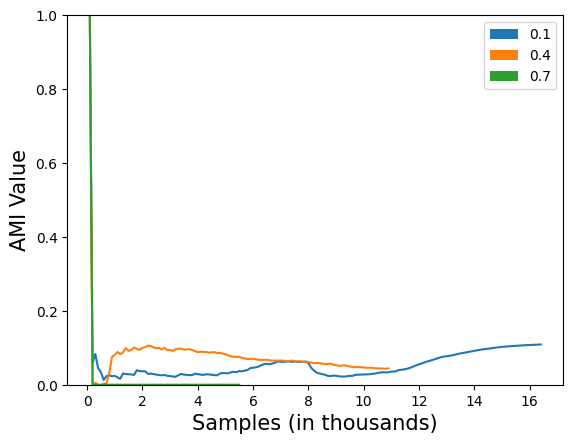

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 546.74it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


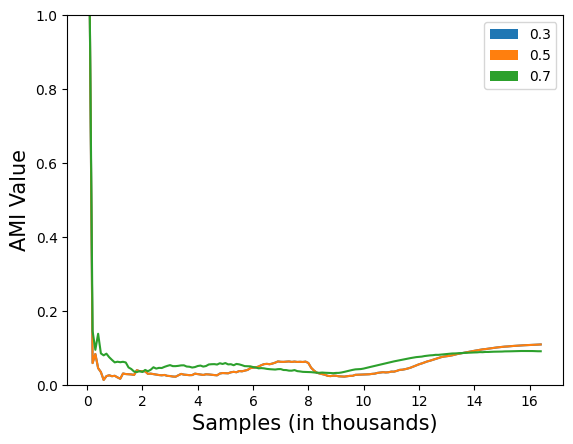

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 551.18it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


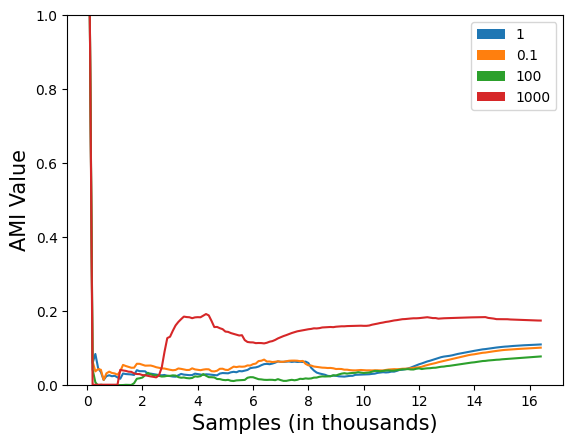

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 541.36it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


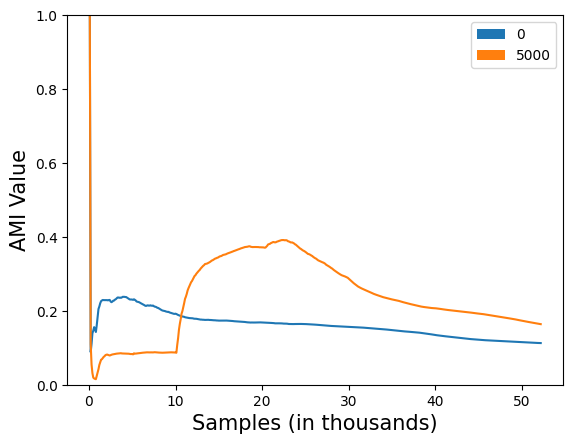

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.87it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


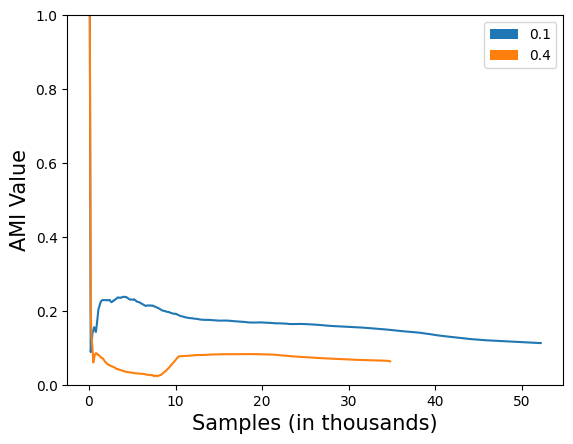

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 540.63it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


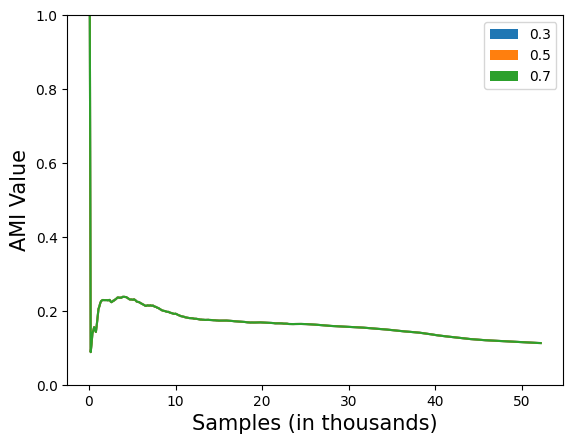

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 545.86it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


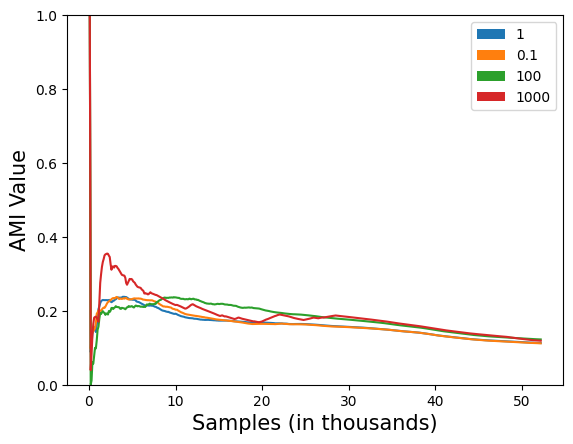

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 540.88it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


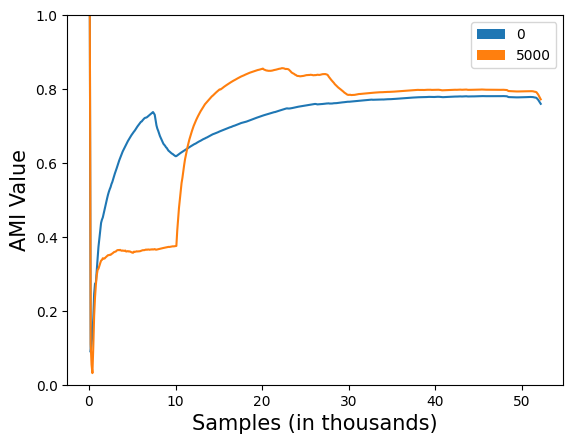

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 571.72it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


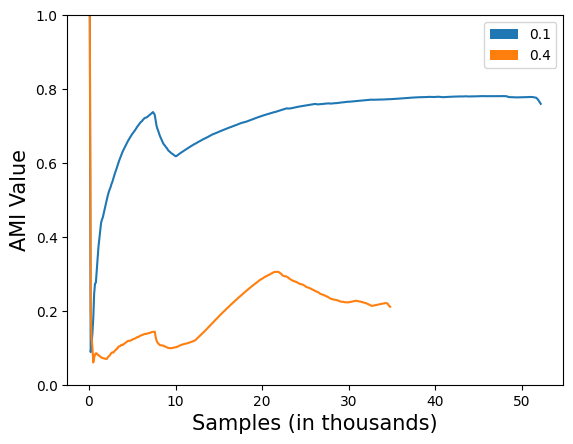

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 540.50it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


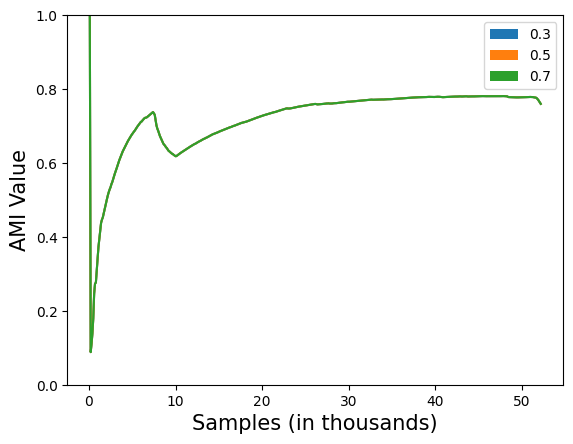

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 540.63it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


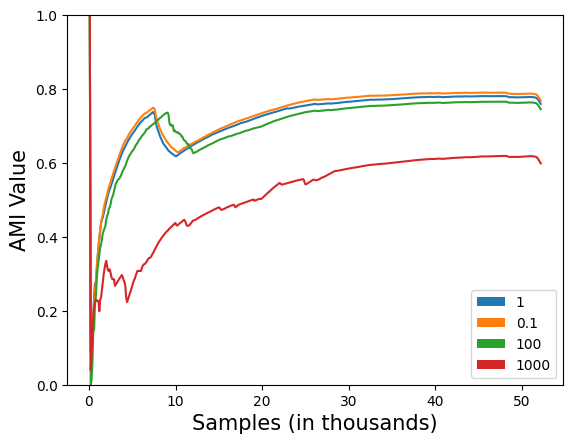

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.20it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


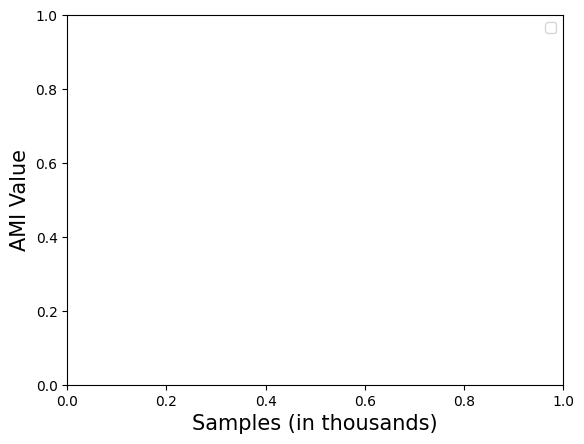

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.19it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


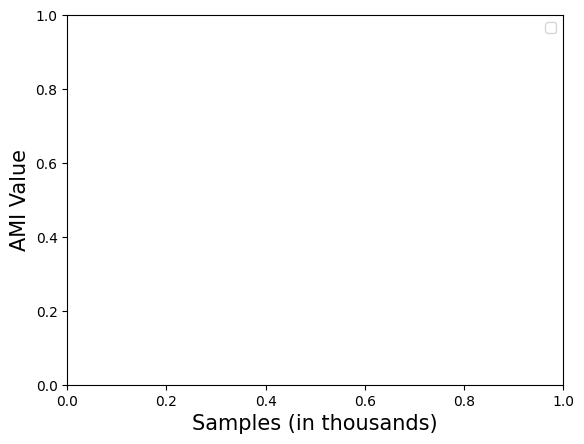

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 569.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


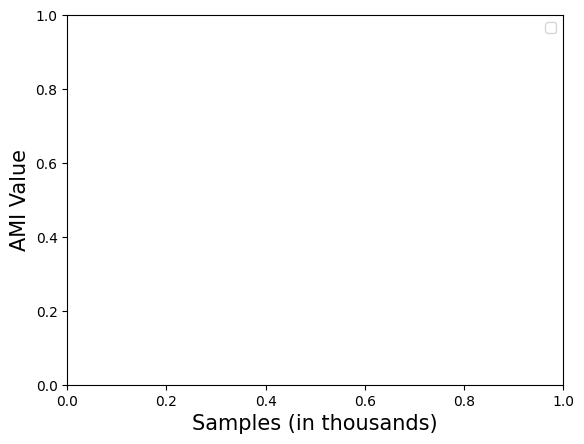

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 573.15it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


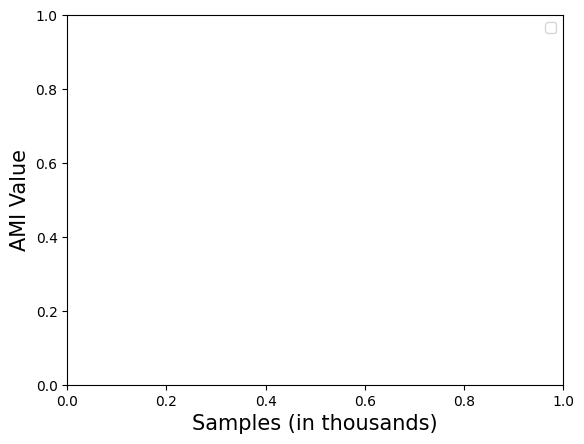

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 482.49it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


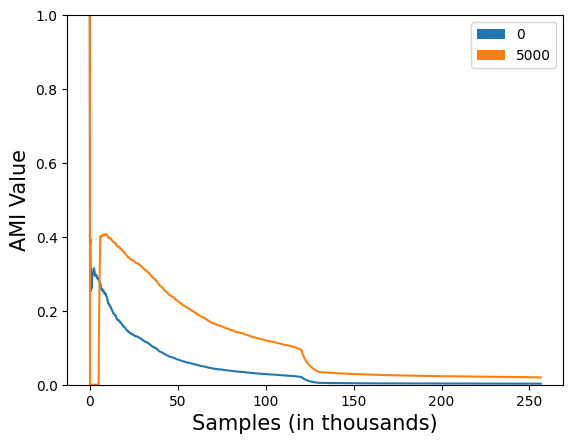

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 531.09it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


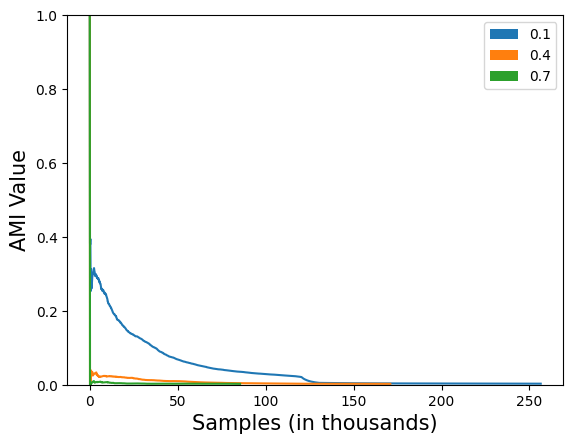

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 481.42it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


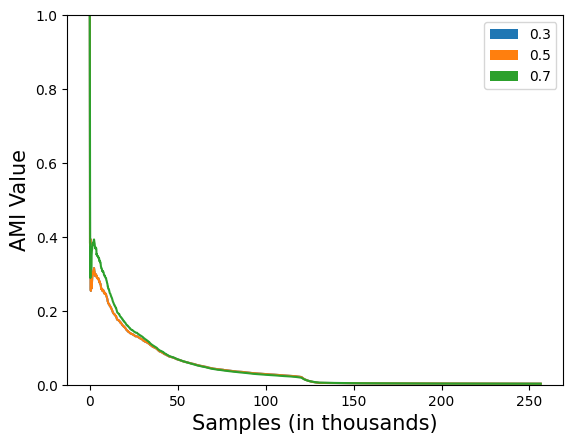

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 482.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


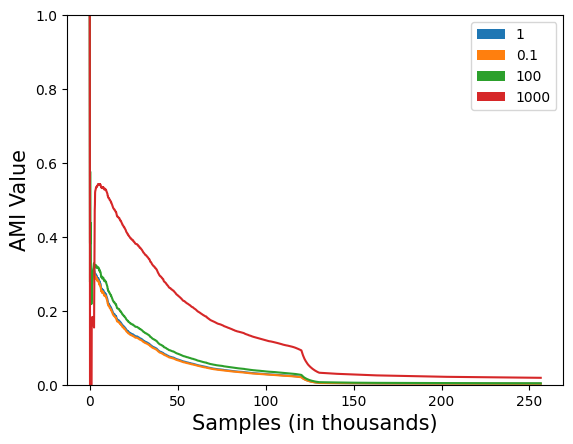

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 475.71it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


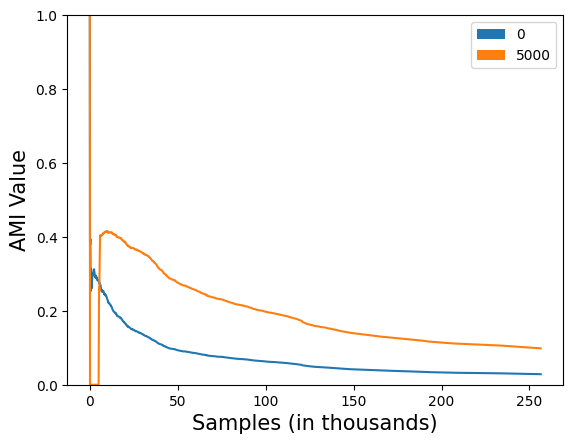

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 528.58it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


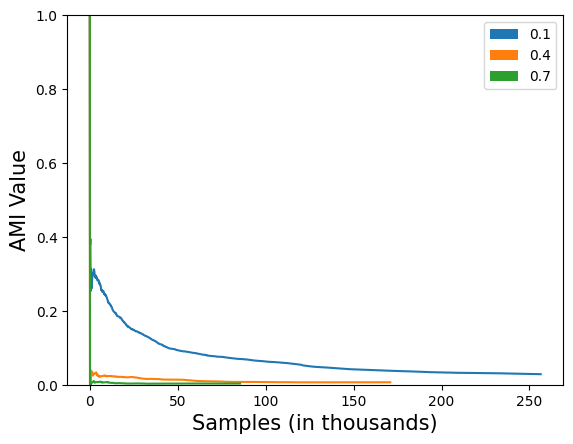

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 480.49it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


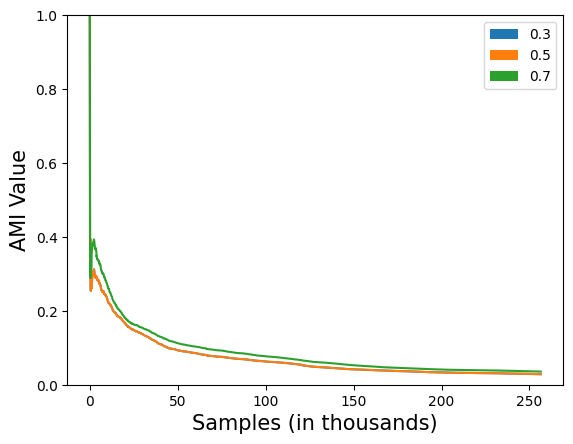

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 482.18it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


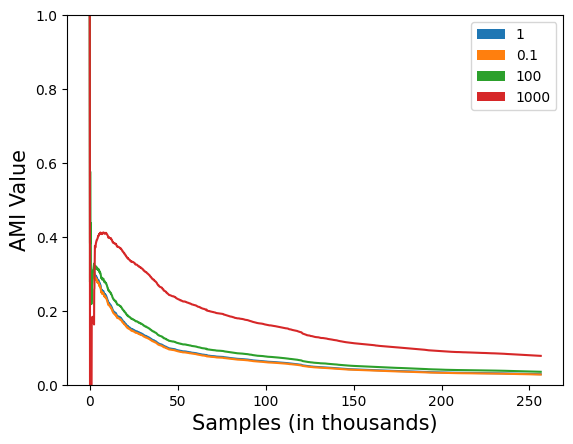

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 482.80it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


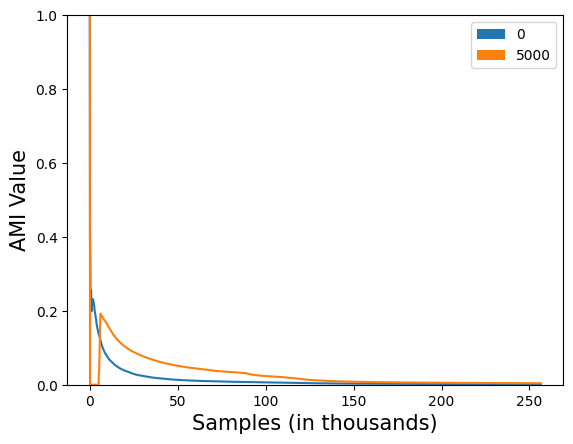

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 515.85it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


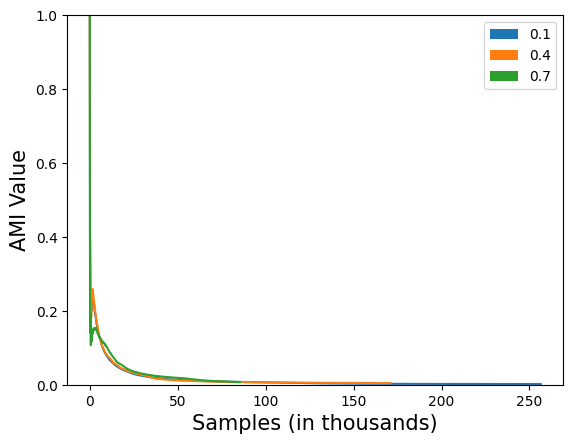

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 480.56it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


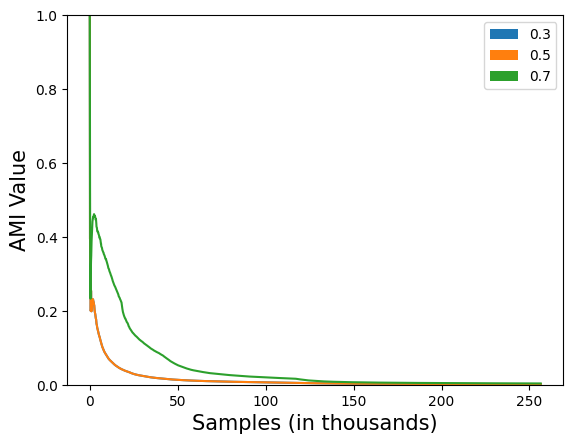

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 479.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


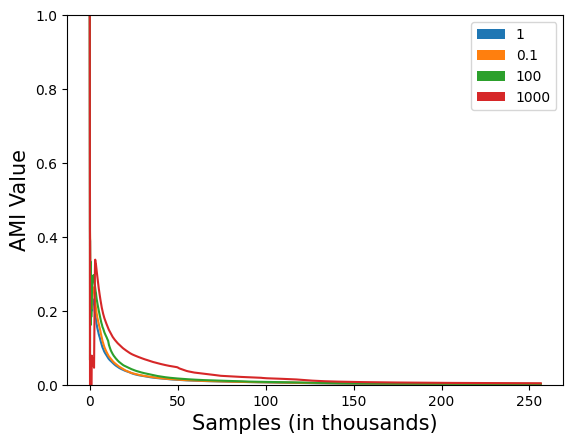

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 564.56it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


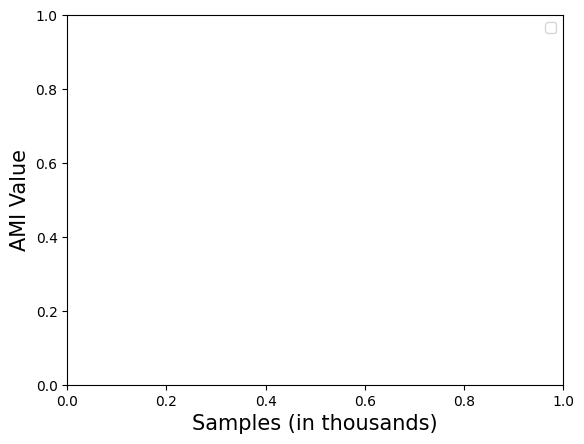

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.41it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


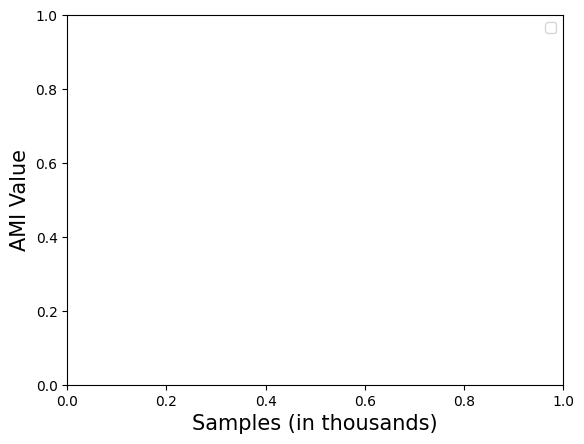

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 566.02it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


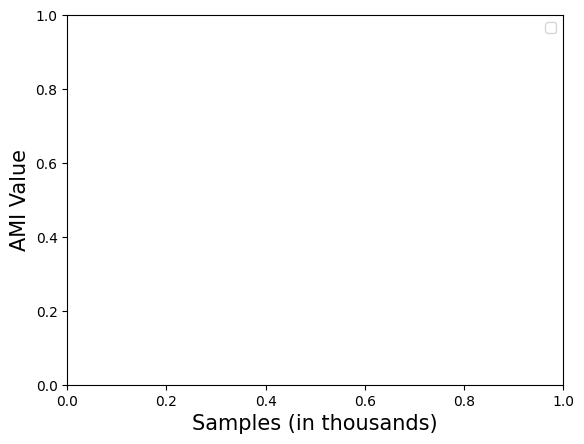

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.85it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


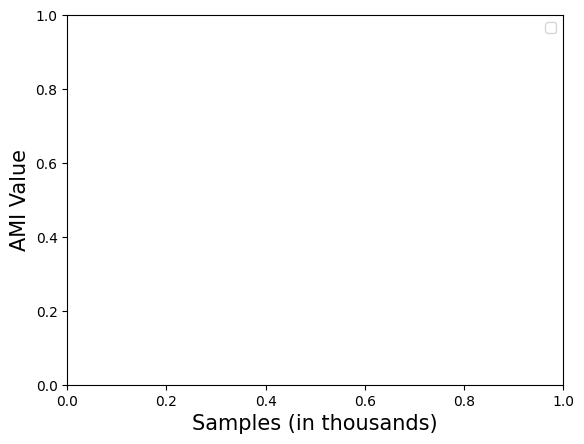

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 554.32it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


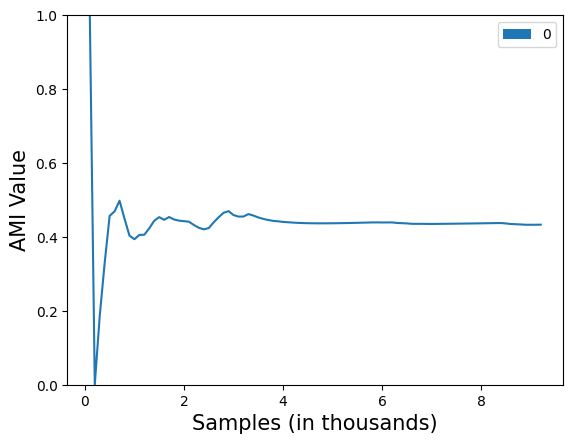

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 557.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


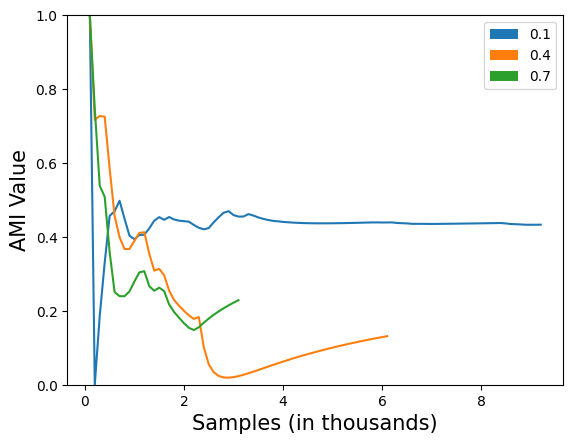

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 559.39it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


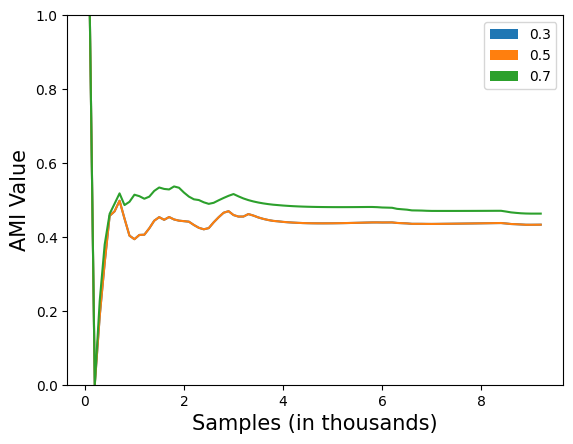

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 554.18it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


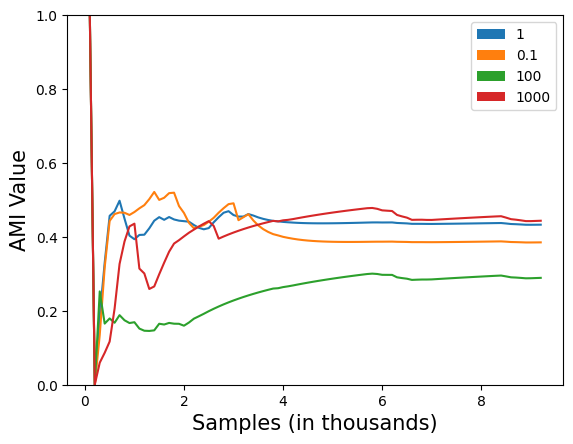

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 563.46it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


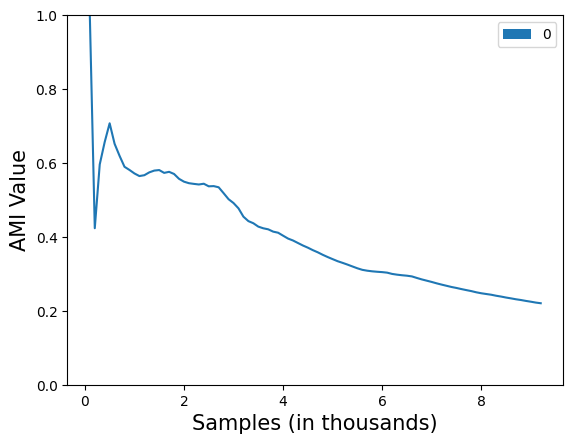

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 562.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


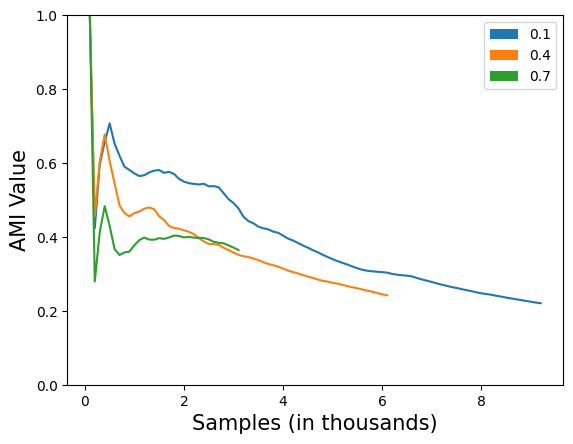

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 558.21it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


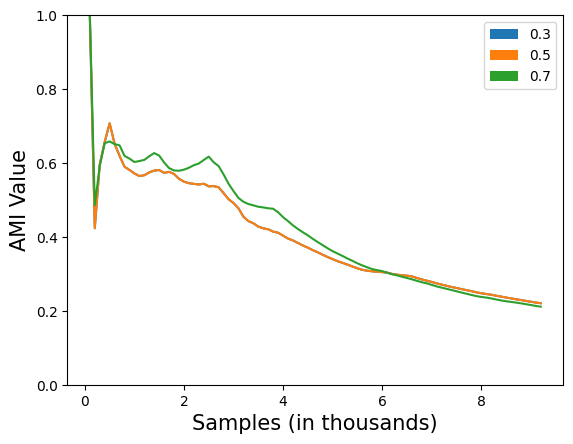

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 558.65it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


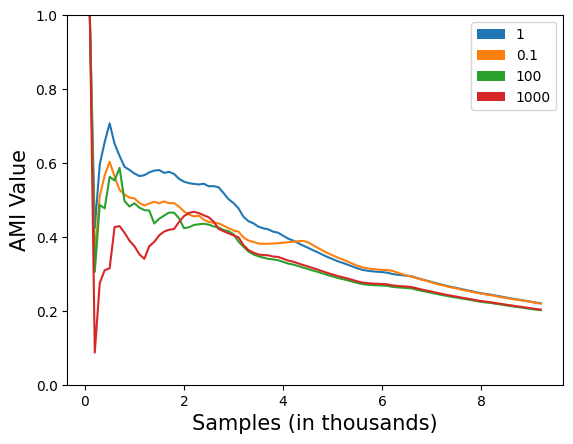

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 535.70it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


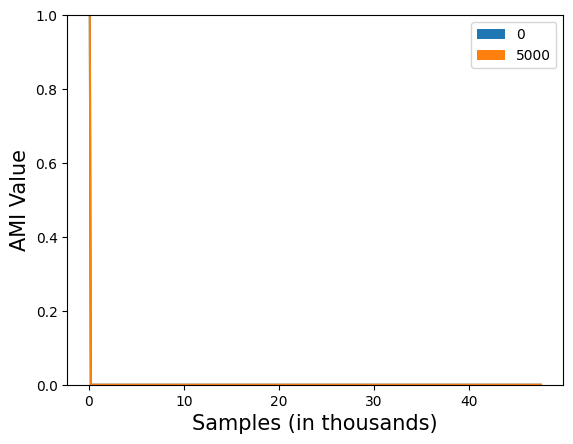

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 544.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


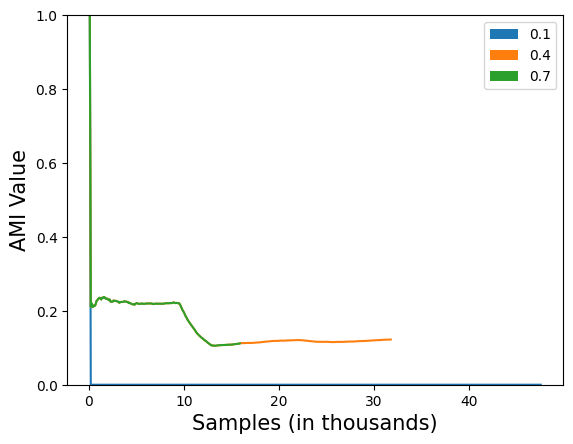

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 520.01it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


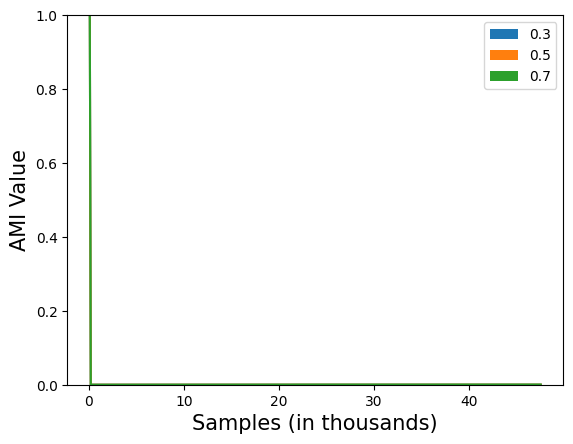

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 532.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


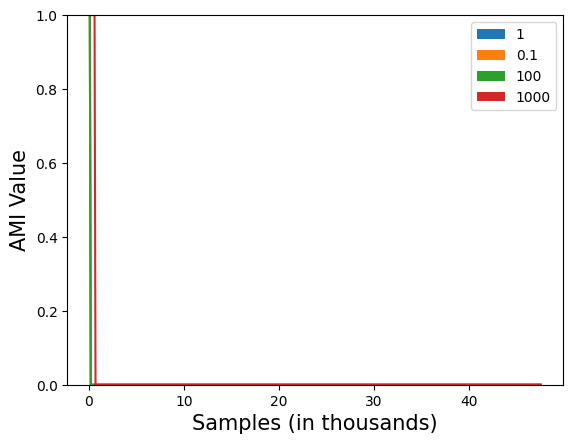

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 552.95it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


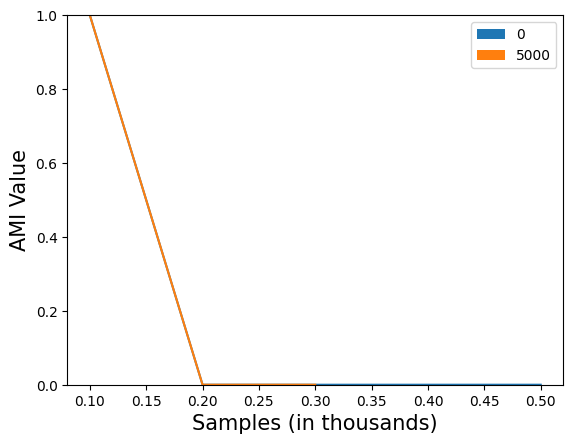

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 531.22it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


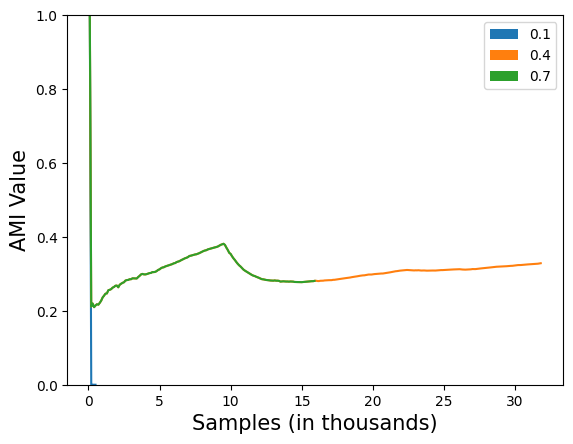

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 548.73it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


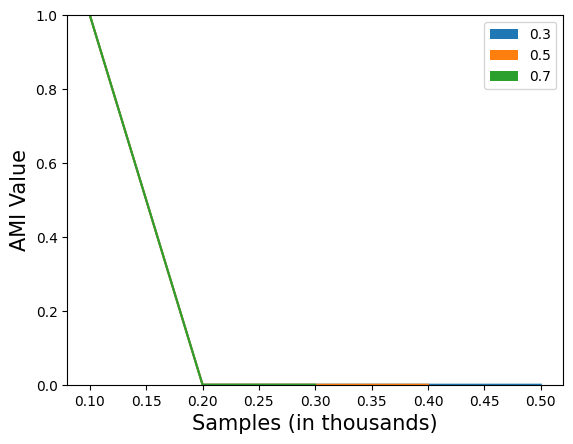

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 548.47it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


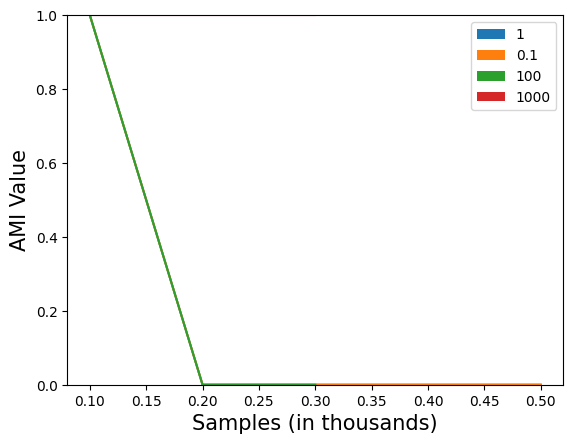

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 531.06it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


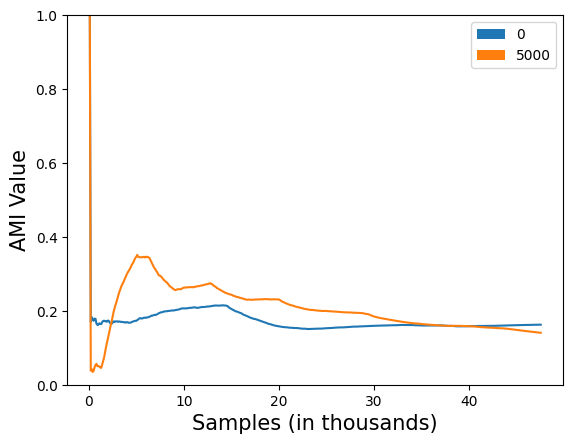

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 536.94it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


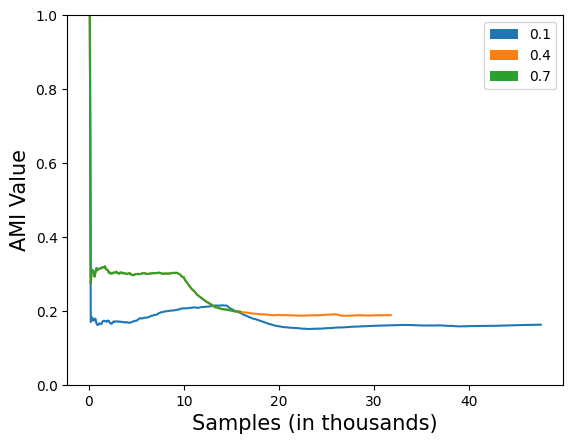

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 526.01it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


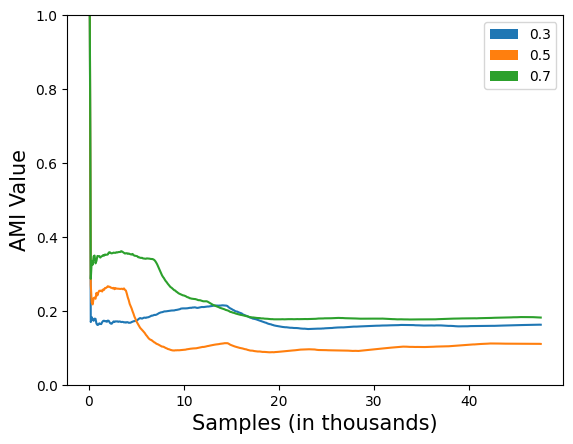

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 524.81it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


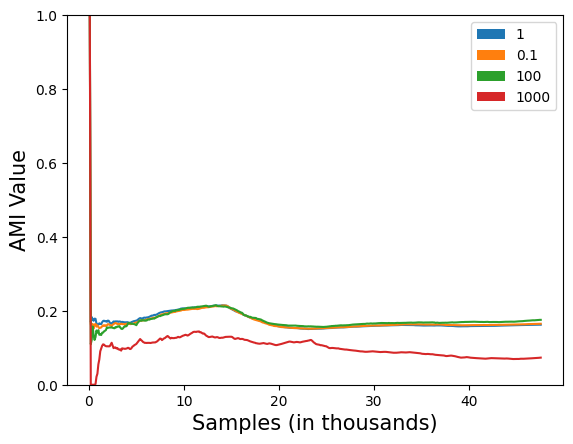

In [27]:
for dataset_name in datasets:
    for algo in algorithms:
        colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
        metric_name = 'adj_mut_info'
        
        for rng in [range(0,2), range(2,5), range(5,8), range(8,12)]:
            fig, ax = plt.subplots()
            plt.xlabel('Samples (in thousands)', fontsize=15)
            plt.ylabel('AMI Value', fontsize=15)
            plt.ylim(0,1)
            counter = 0
            handles = []
            
            for i in rng:
                if counter == 0:
                    query = f'run.experiment == "{dataset_name}" and {baseline} and "{algo}" in run.tags'
                else:
                    query = f'run.experiment == "{dataset_name}" and {queries[list_characteristics[i]]} and "{algo}" in run.tags'
                
            
                metrics = get_metrics(query, aim_repo, [metric_name])
            
                # Splitting for save name
                parts = list_characteristics[i].split('=')
                dc_name = parts[0].strip()
                dc_value = parts[1].strip()
        
                values = [elem[metric_name] for elem in metrics]

                if len(values) == 0:
                    continue
            
                max_values, min_values, mean_values = get_max_min_mean(values)
            
                x = ((np.arange(0, max(len(arr) for arr in values)) * 100 + 100) / 1000)
                ax.plot(x, mean_values, color = colors[counter])
                handles.append(Patch(facecolor=colors[counter], label=dc_value))
                
                counter += 1
                
            plt.legend(handles=handles)#, loc='upper center', bbox_to_anchor=(0.45, 1.15), ncol=5, fontsize=15)
            if save_path is not None:
                plt.savefig(f'{save_path}Range_plots/final/{dataset_name}_{algo}_{dc_name}_plot_ami.eps', format='eps', dpi=1200)
                plt.savefig(f'{save_path}Range_plots/final/{dataset_name}_{algo}_{dc_name}_plot_ami.png', format='png', dpi=1200)
        
            plt.show()

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 559.87it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


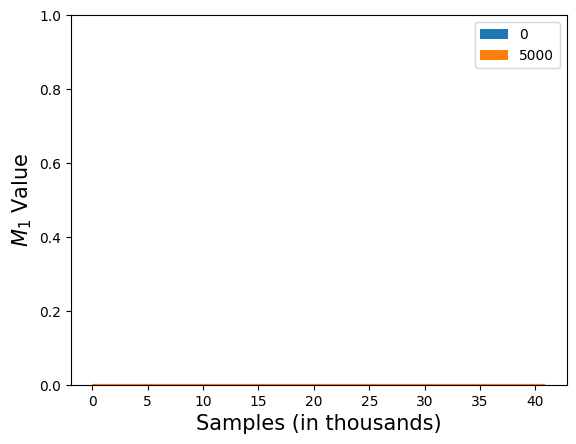

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 559.44it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


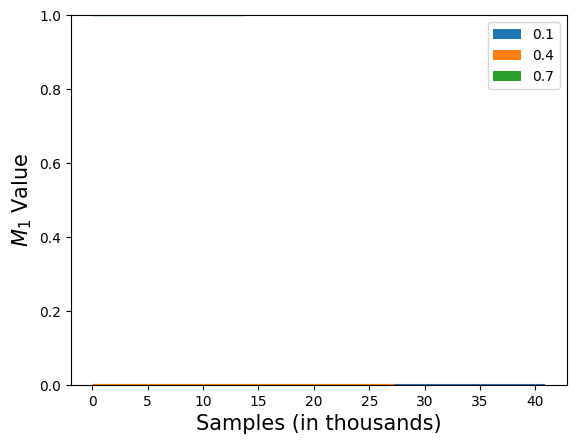

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 556.71it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


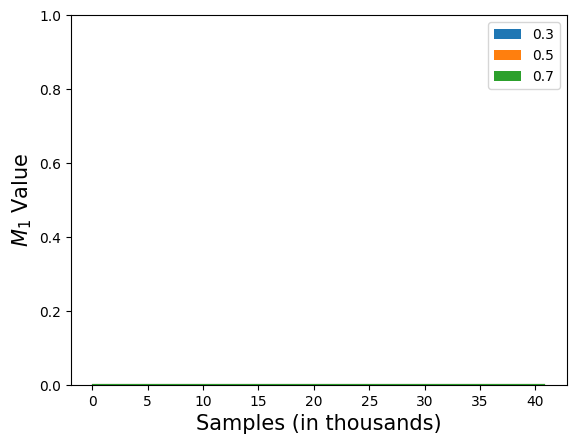

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 552.08it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


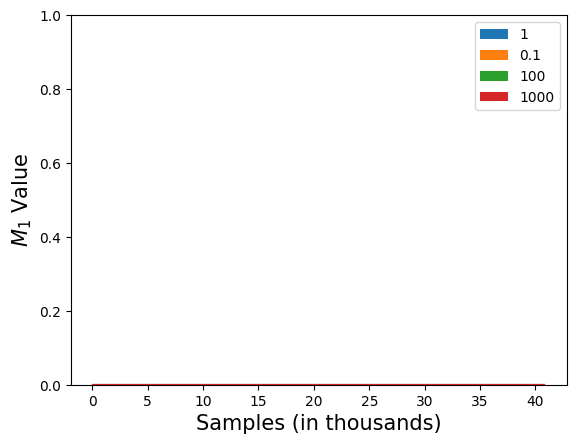

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 555.99it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


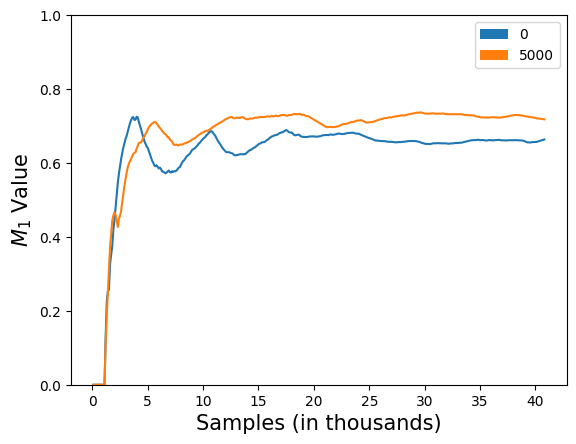

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 558.26it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


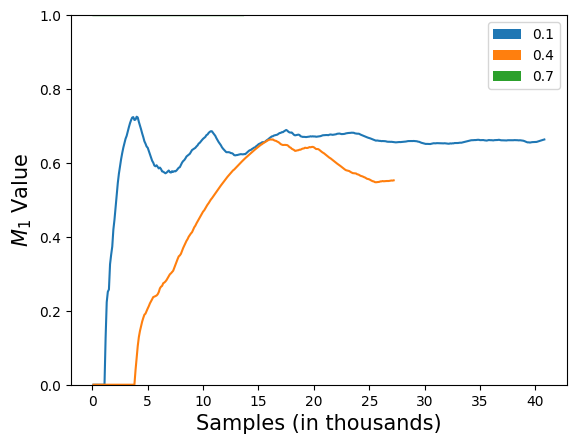

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 556.50it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


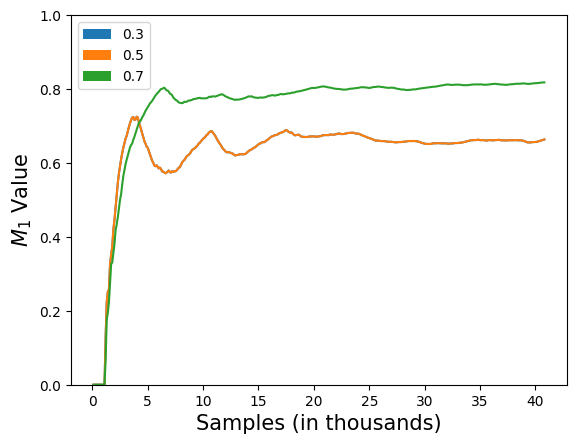

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 551.75it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


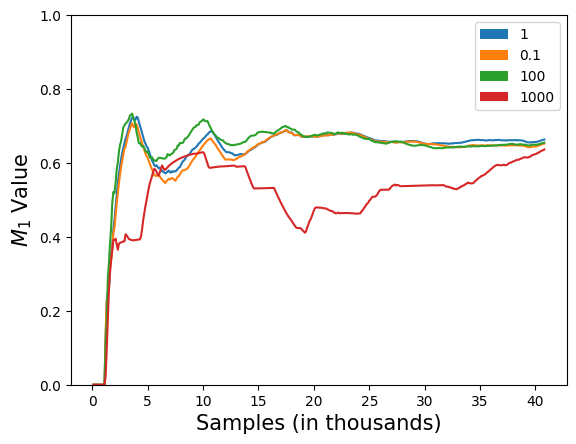

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 556.18it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


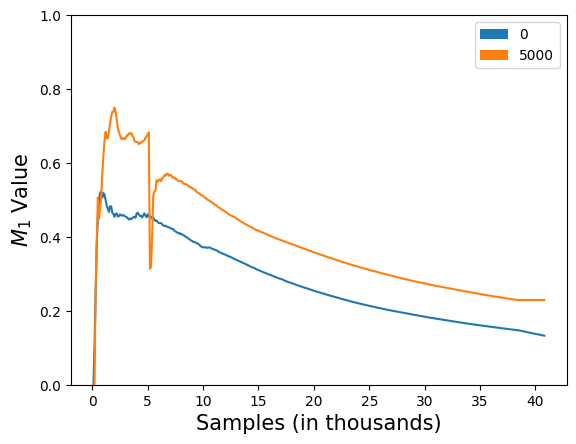

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.28it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


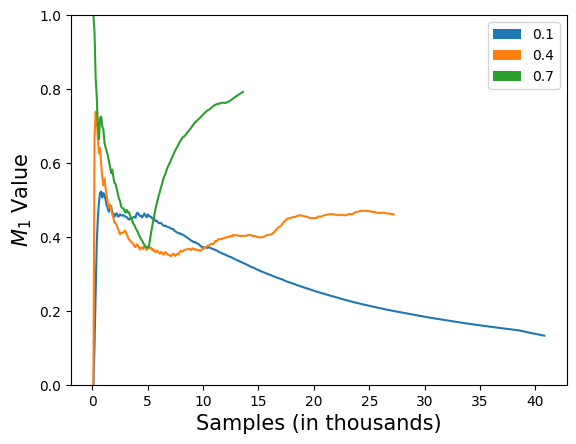

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 551.60it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


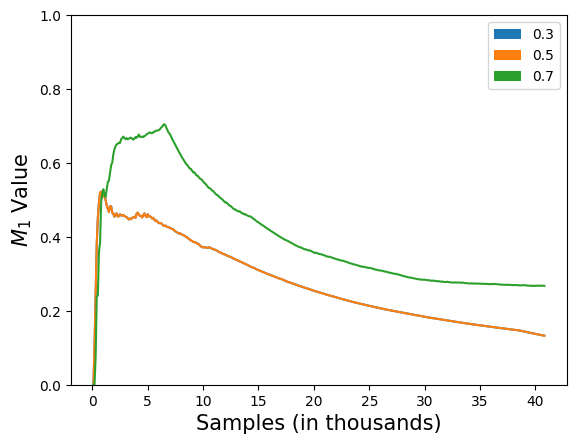

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.95it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


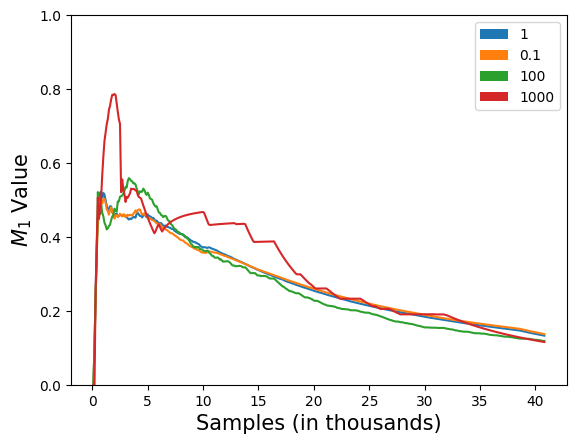

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 575.95it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


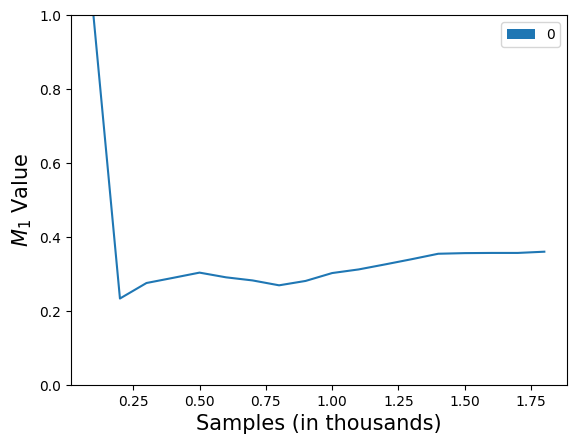

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 574.75it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


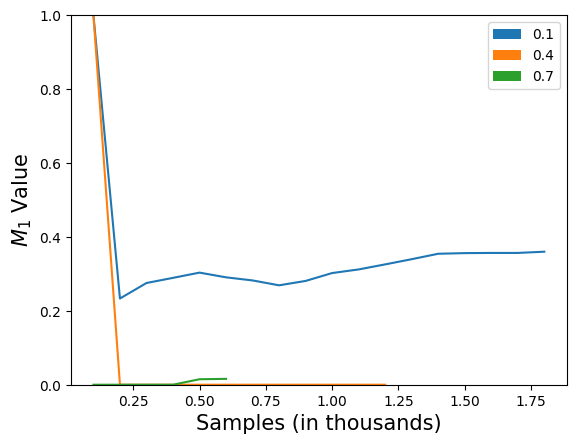

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 570.15it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


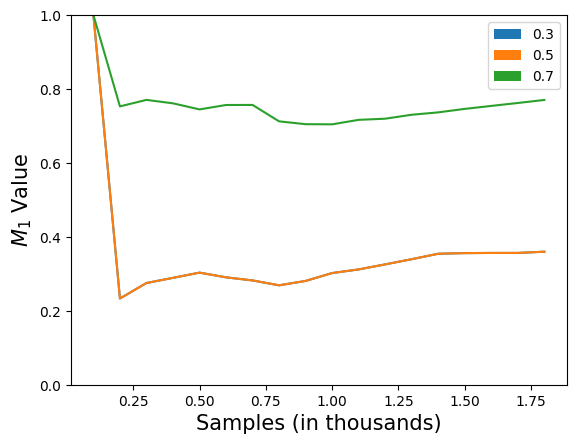

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 554.79it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


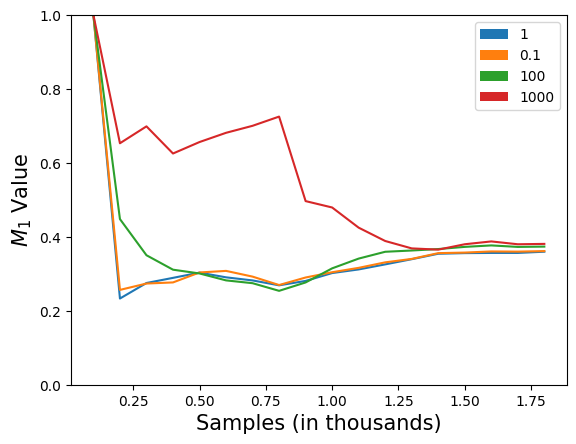

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 579.78it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


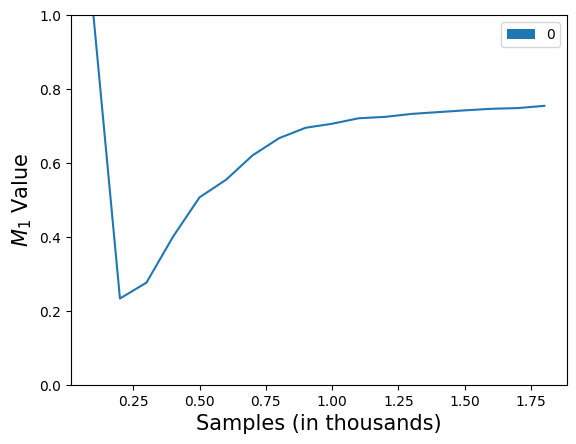

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 568.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


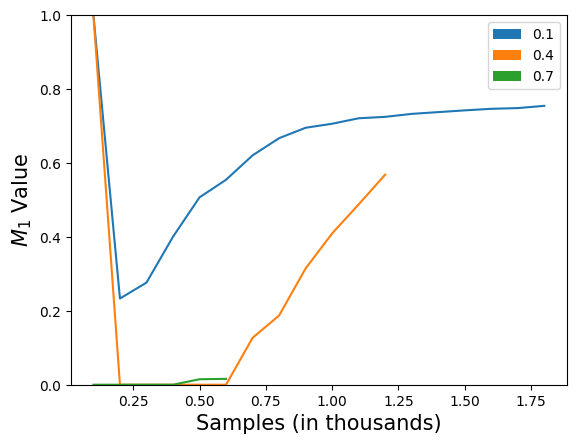

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 566.56it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


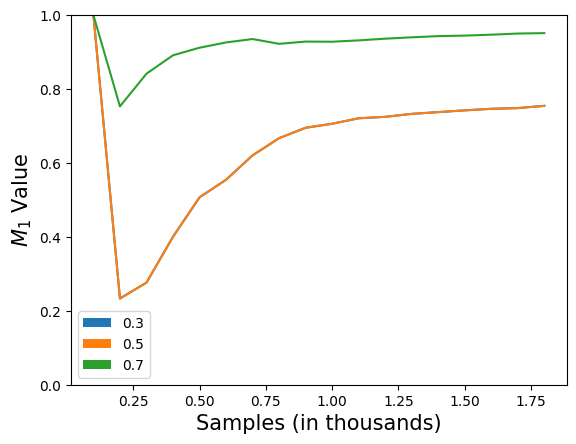

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 572.80it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


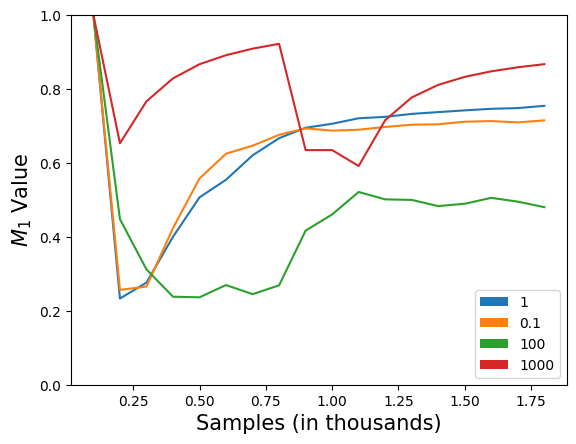

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 577.24it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


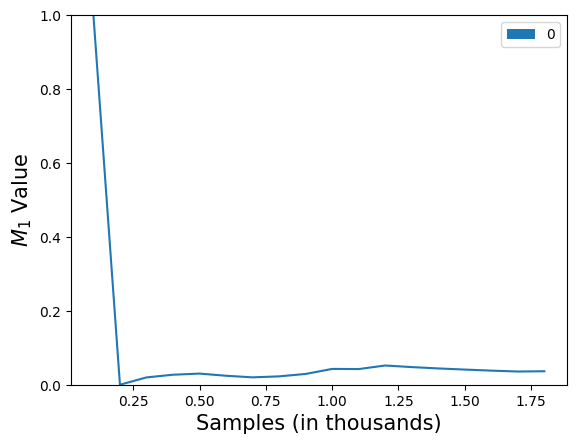

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 570.16it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


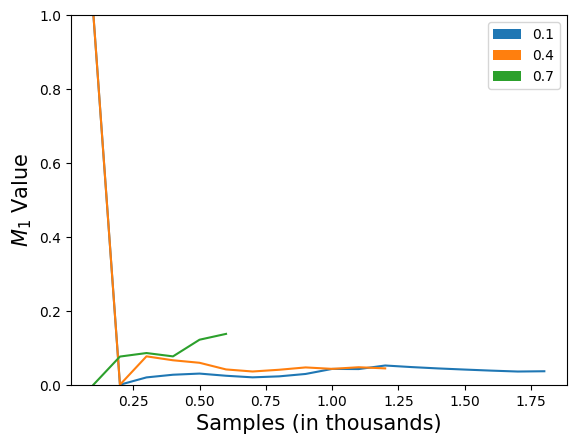

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 568.85it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


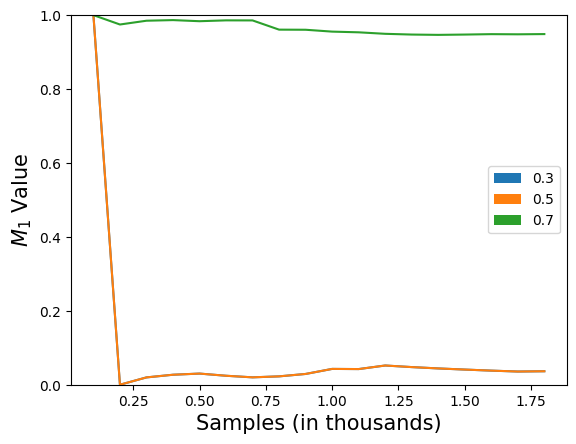

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 570.62it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


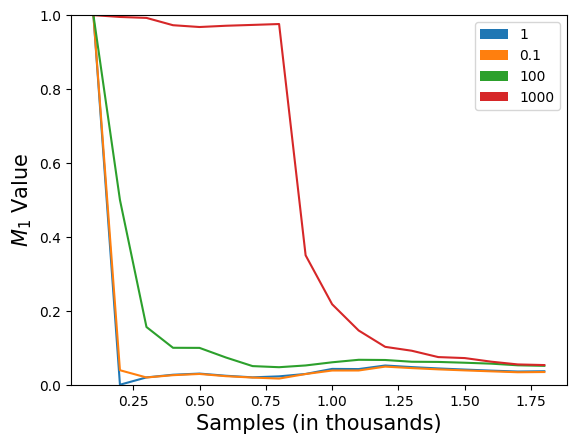

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 580.44it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


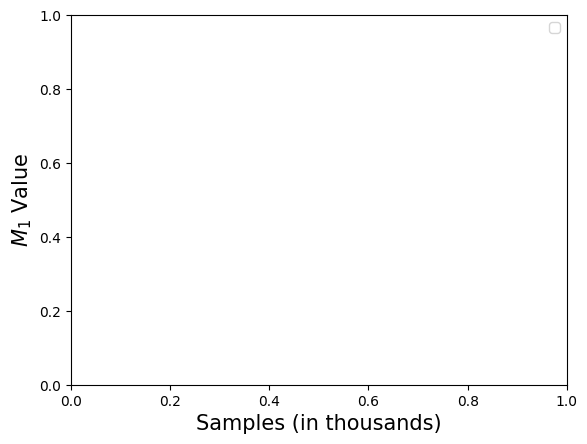

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 579.84it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


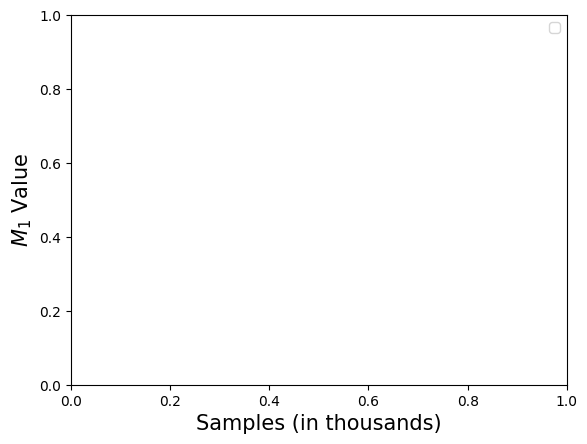

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 580.80it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


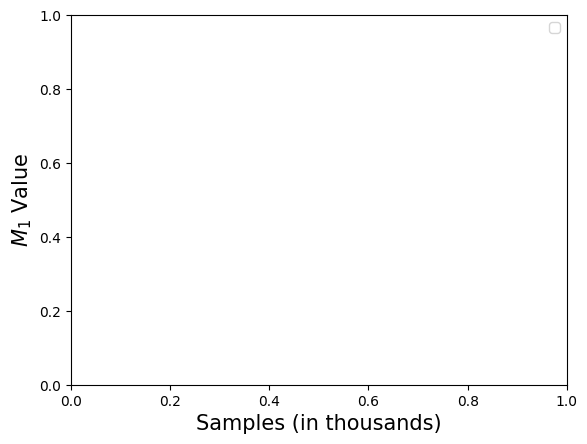

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 584.10it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


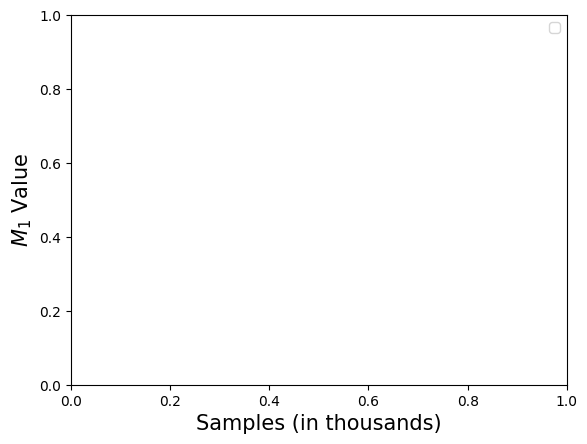

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 579.03it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


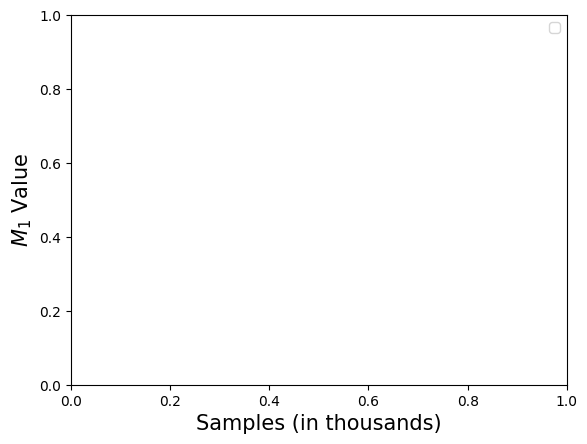

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 586.78it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


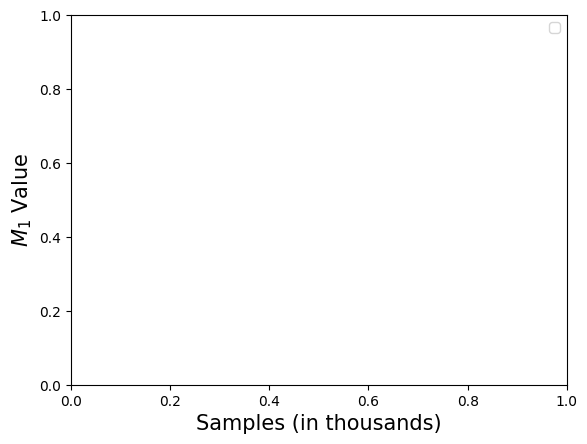

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 585.99it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


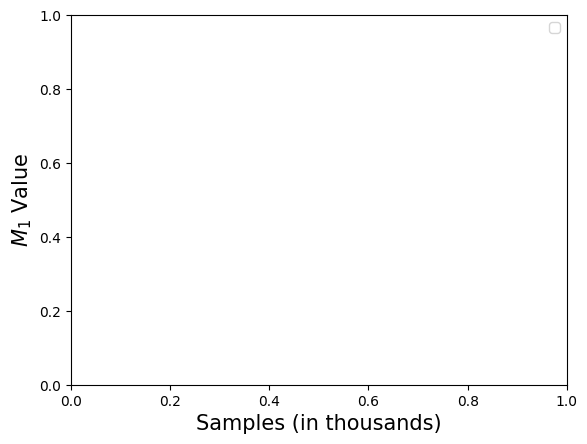

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 585.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


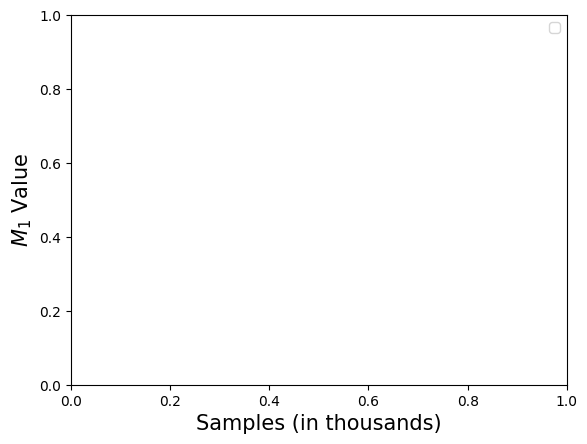

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 574.40it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


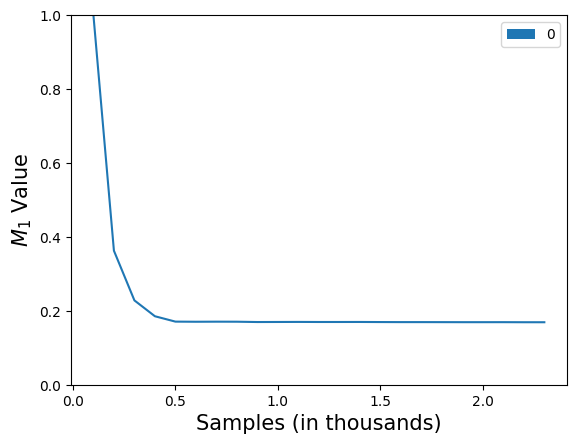

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 584.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


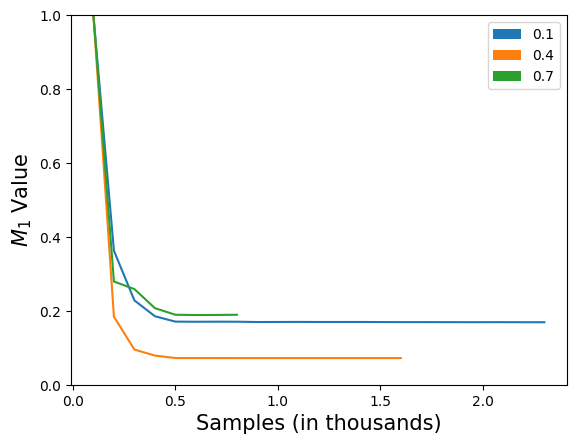

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 580.78it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


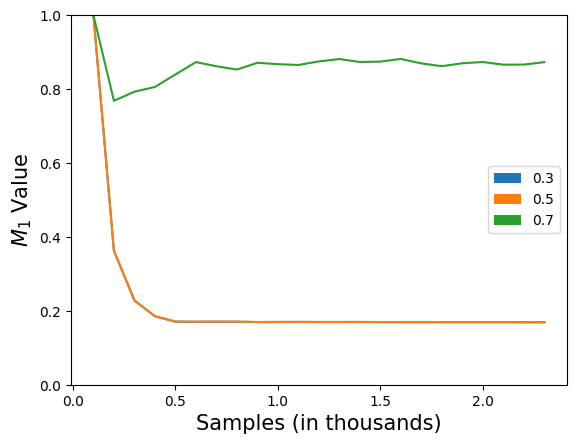

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 582.29it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


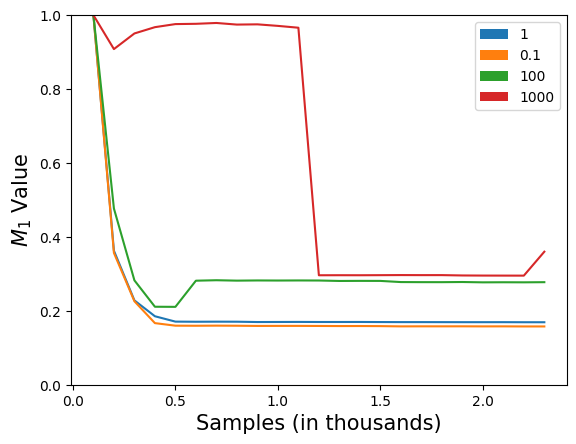

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 574.13it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


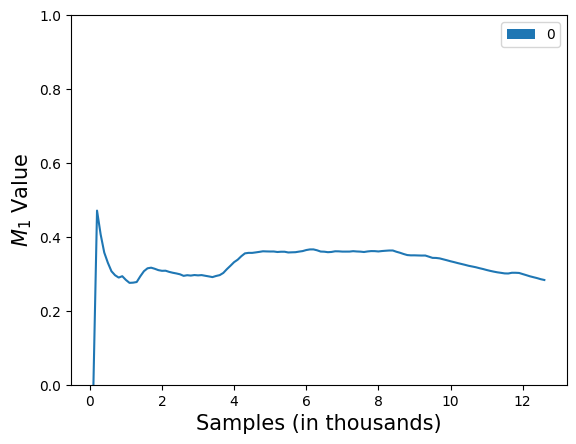

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 559.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


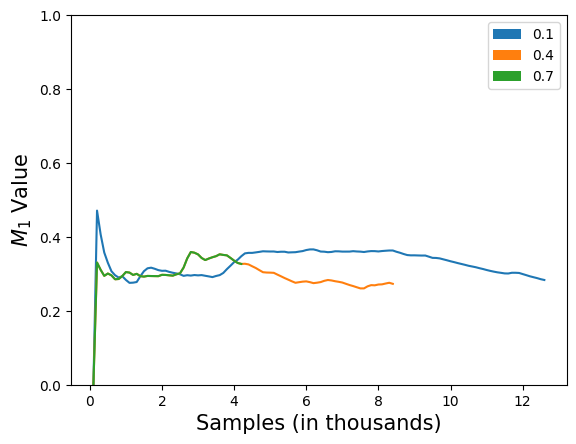

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 558.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


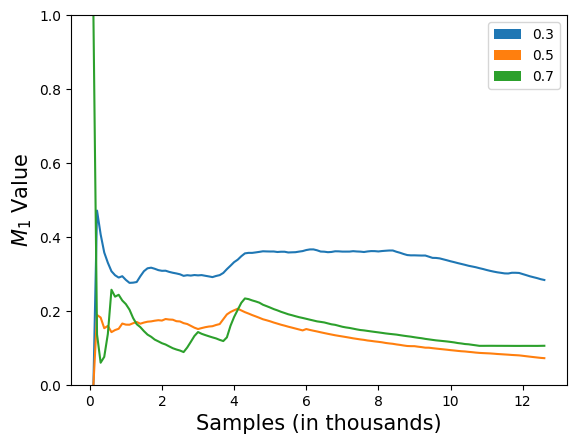

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 552.84it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


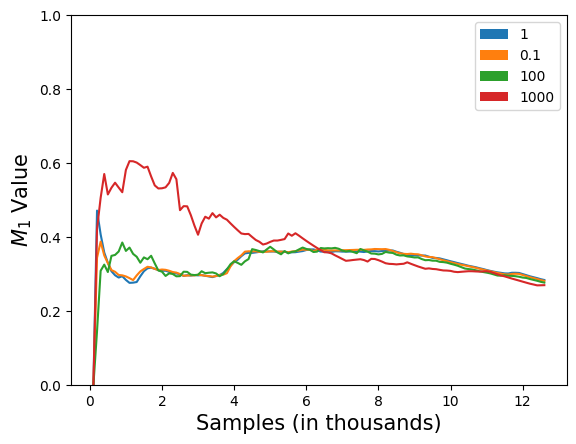

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 578.46it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


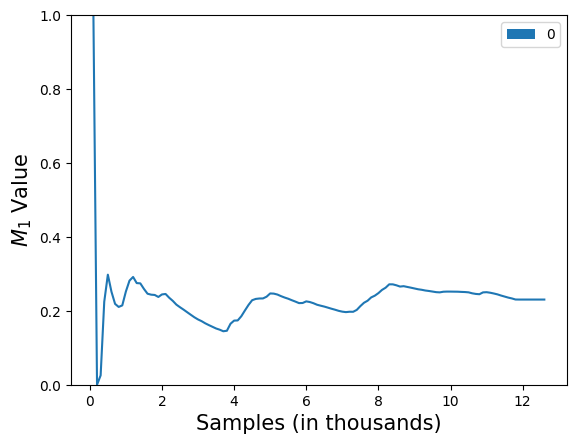

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 560.77it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


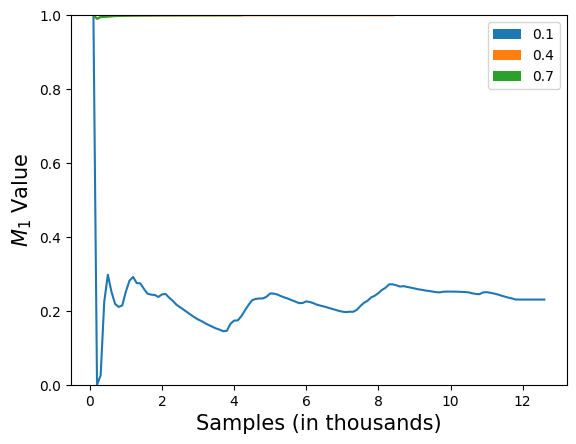

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 554.47it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


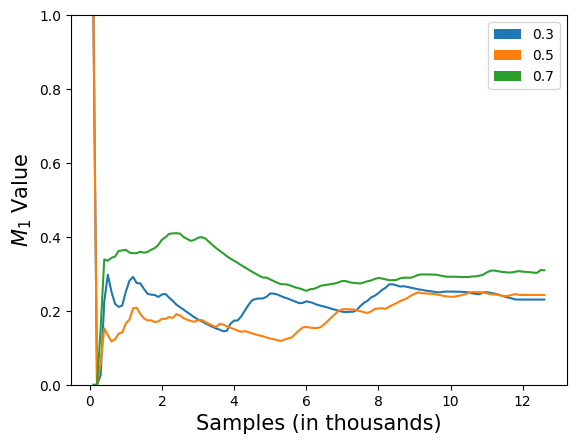

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 558.02it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


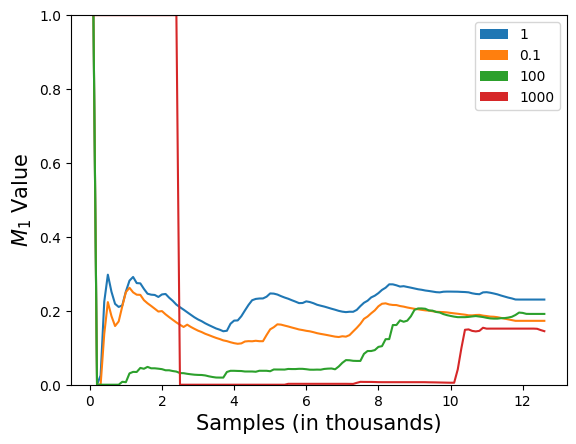

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 568.78it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


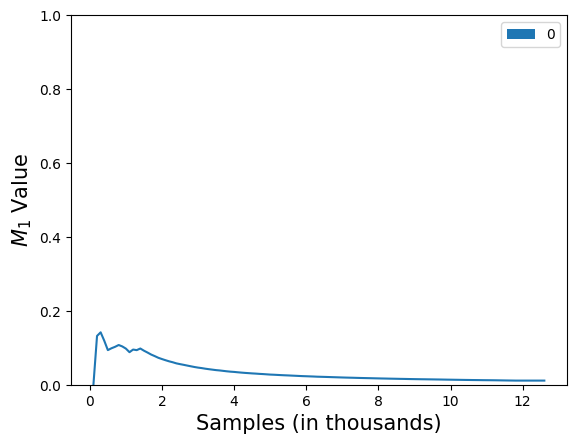

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.61it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


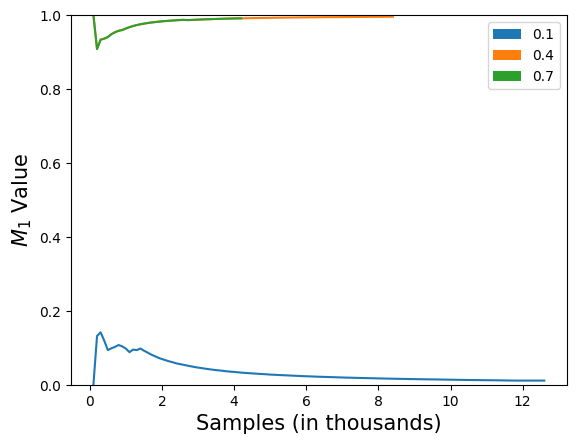

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 559.07it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


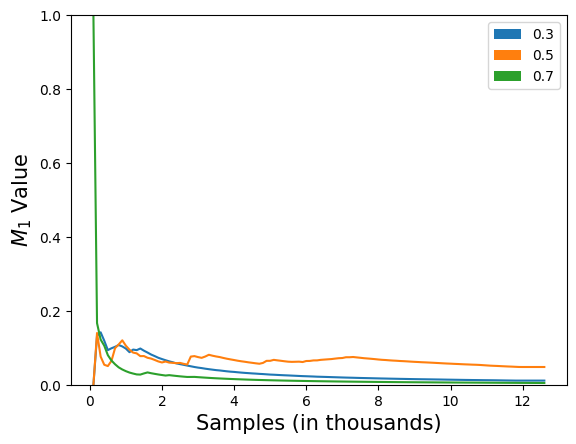

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 551.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


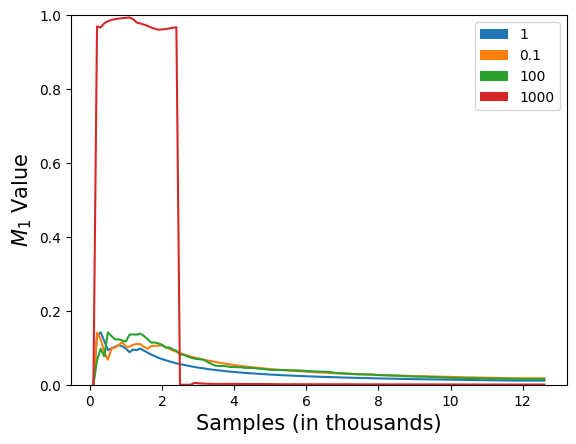

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 516.70it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


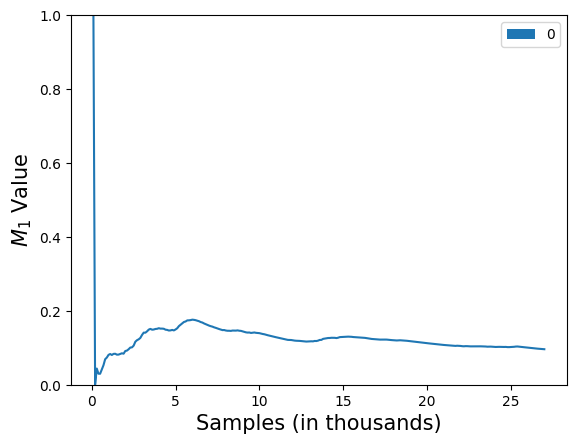

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 502.18it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


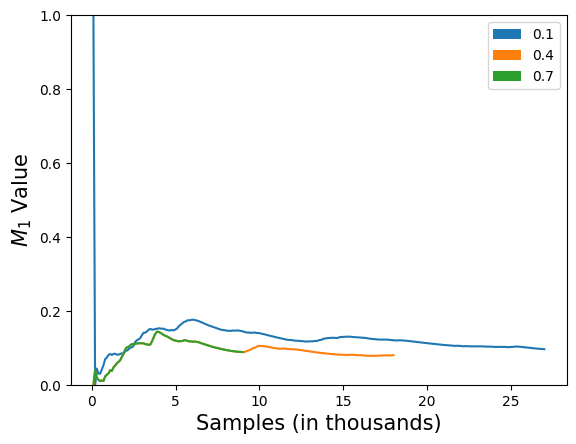

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 492.71it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


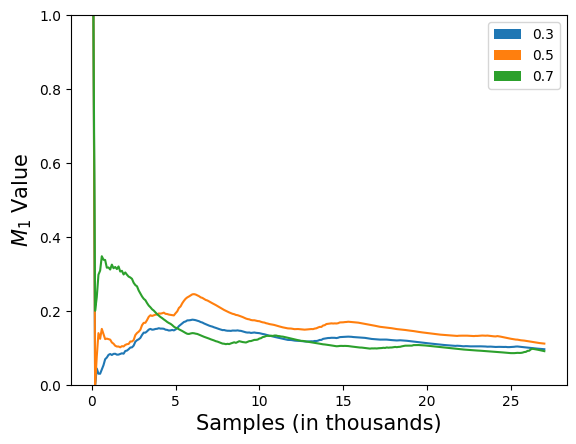

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 487.37it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


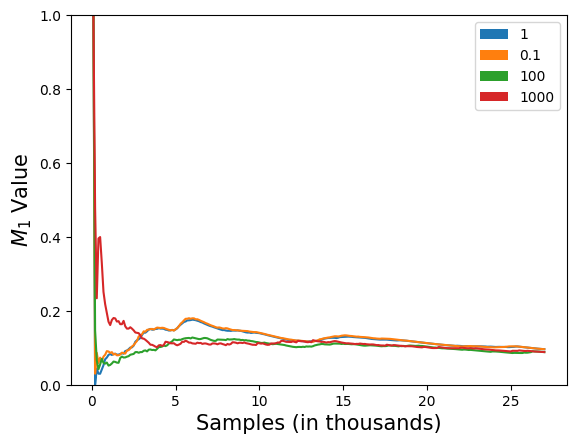

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 527.44it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


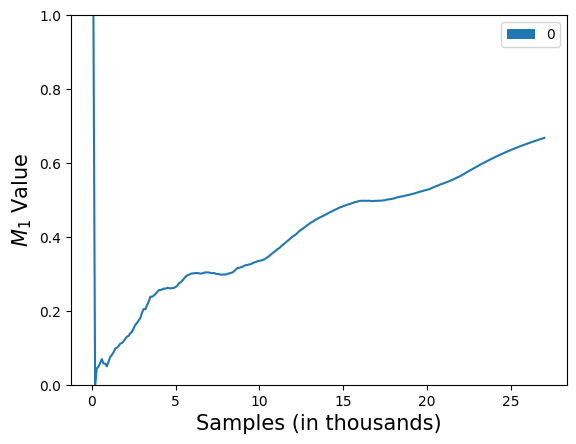

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 506.82it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


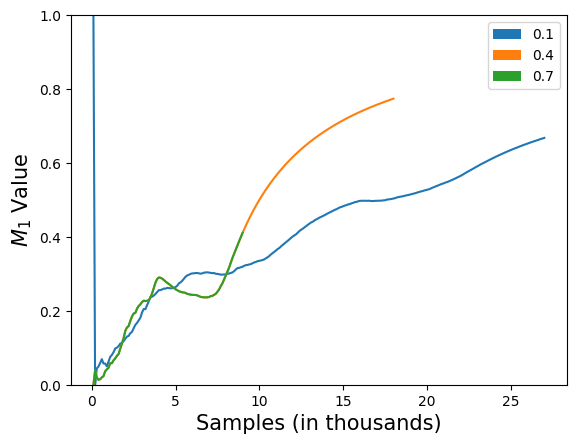

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 493.07it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


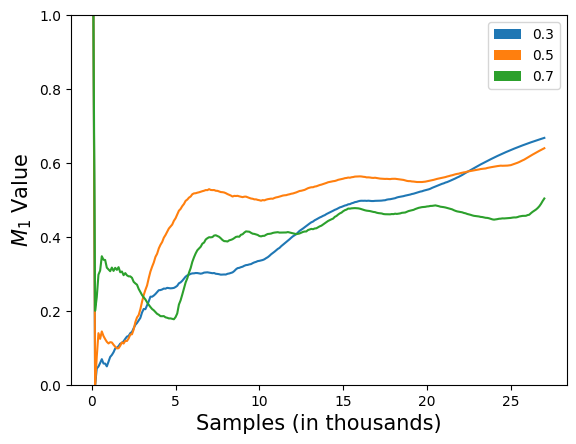

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 492.96it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


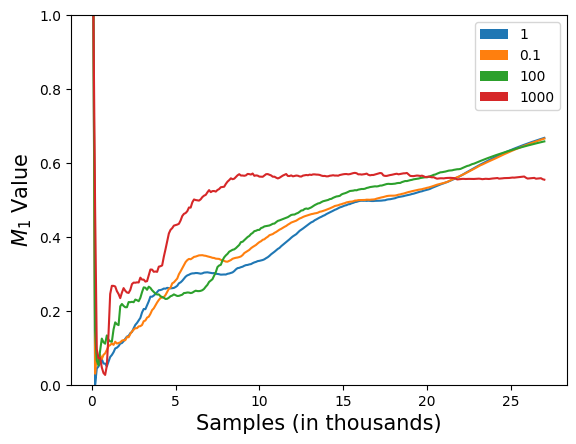

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 530.19it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


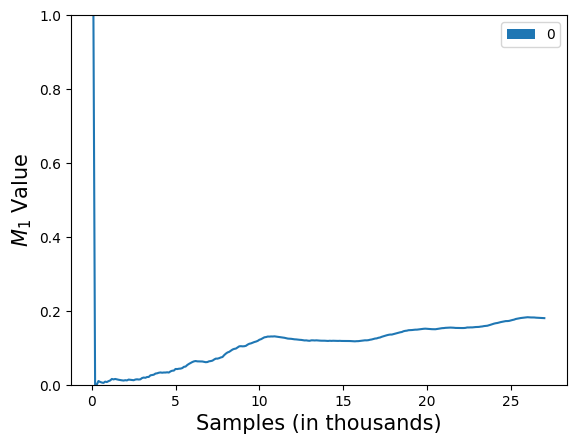

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 505.70it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


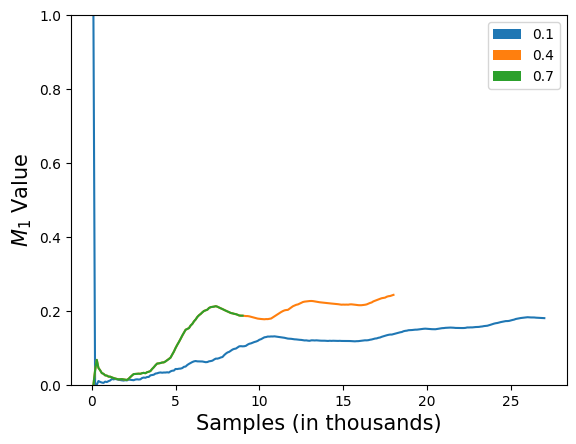

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 485.05it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


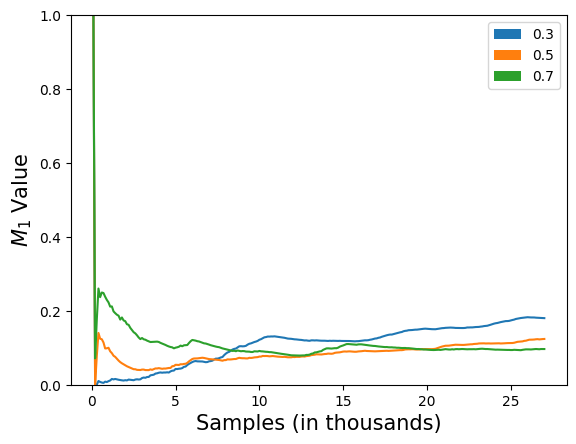

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 457.32it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


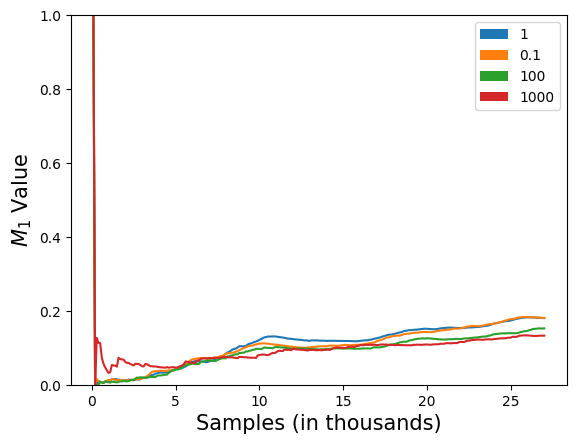

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 506.07it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


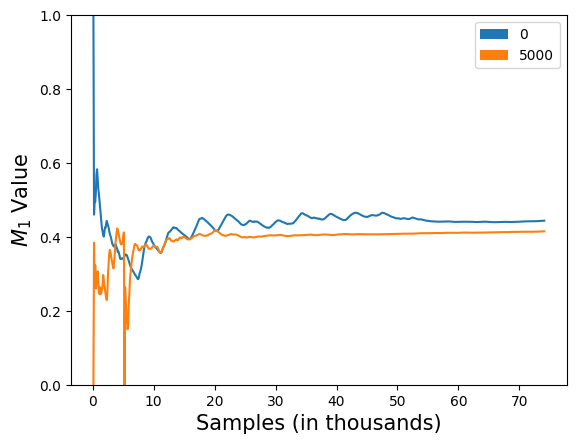

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 530.15it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


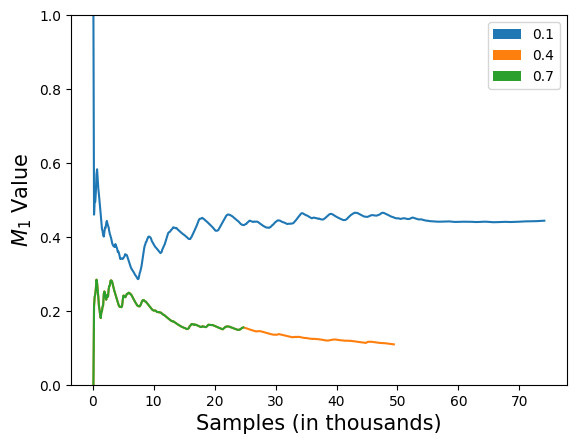

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 494.38it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


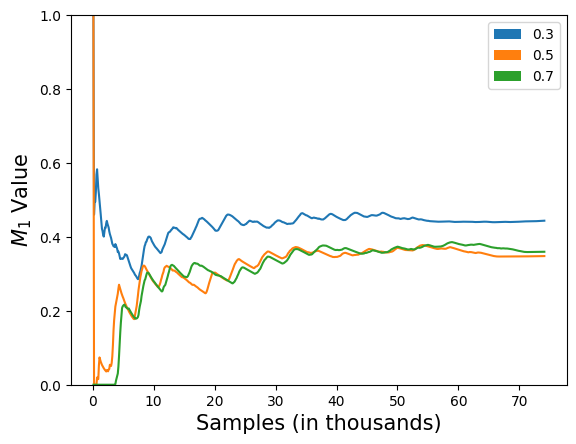

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 499.47it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


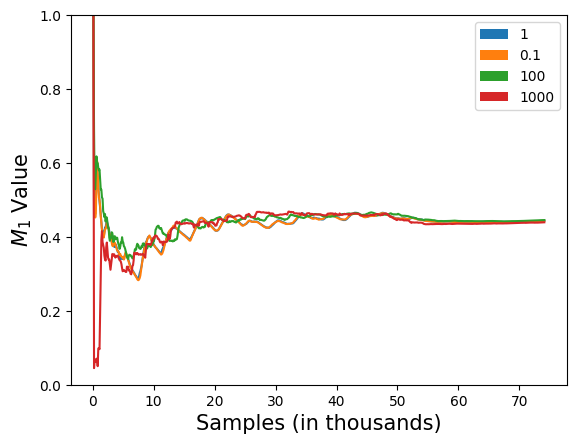

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 512.92it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


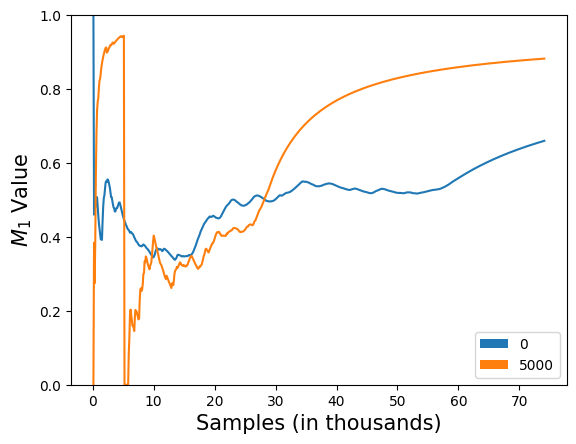

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 530.39it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


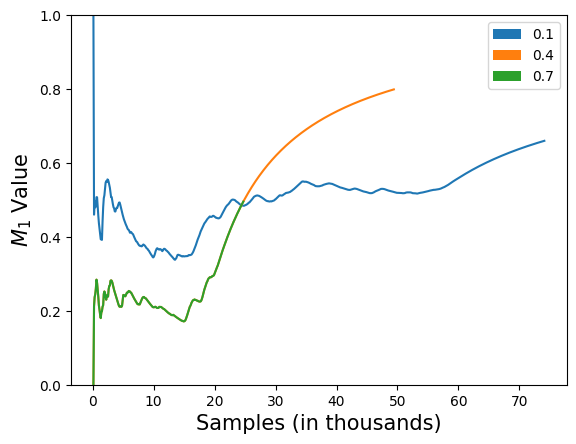

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 506.84it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


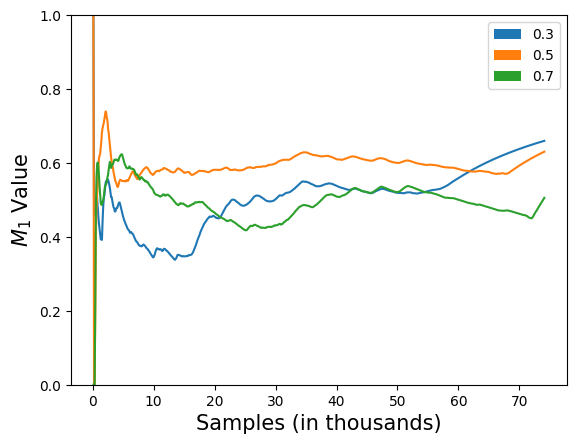

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 505.68it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


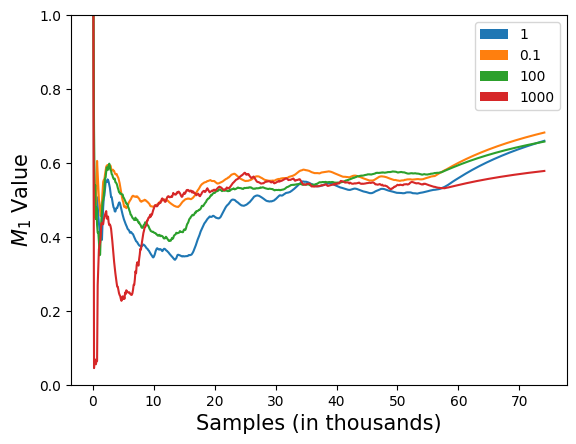

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 510.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


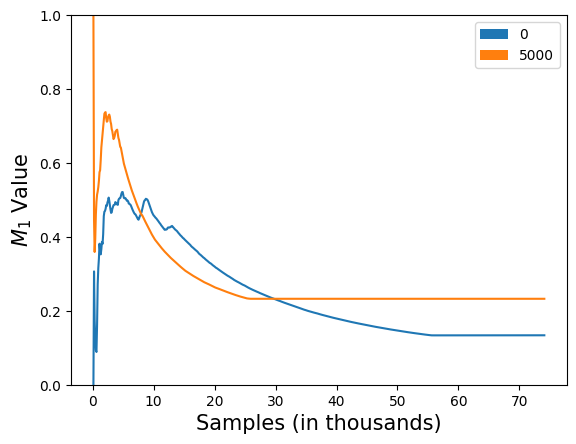

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 533.43it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


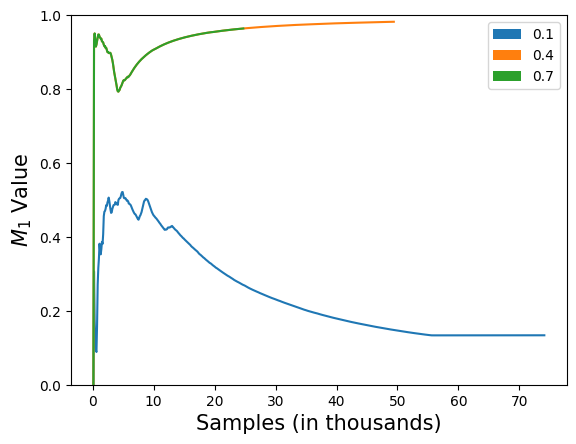

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 505.61it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


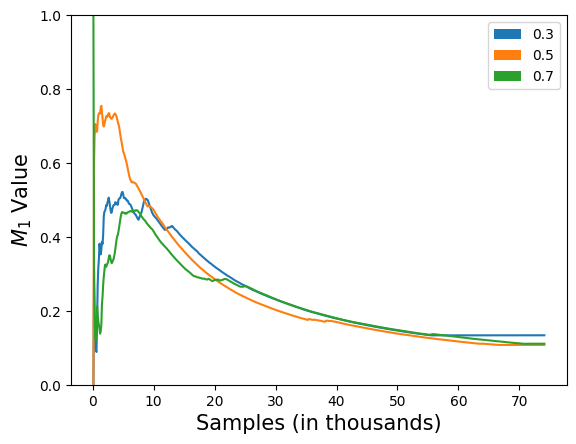

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 499.04it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


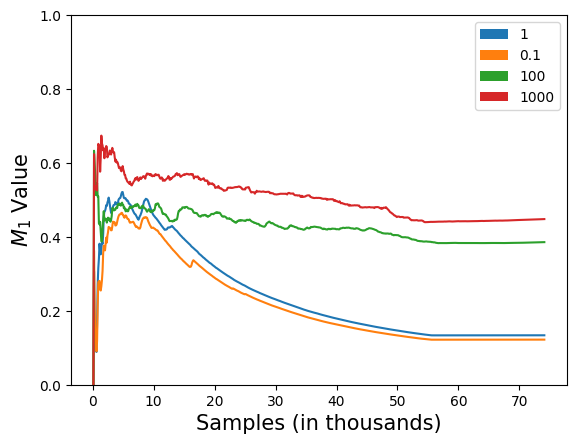

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 517.82it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


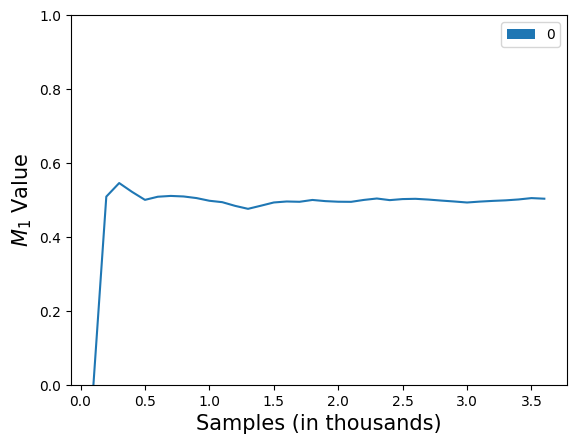

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 490.18it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


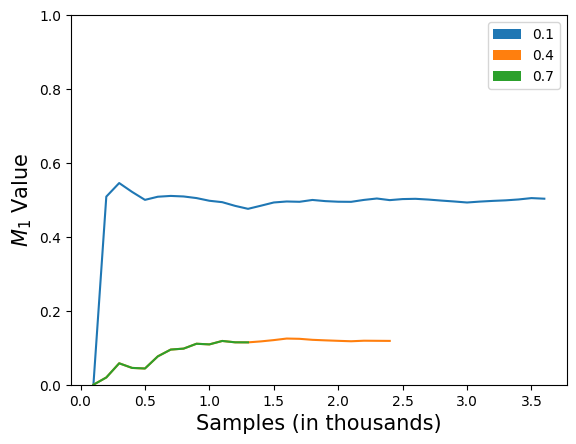

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 484.07it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


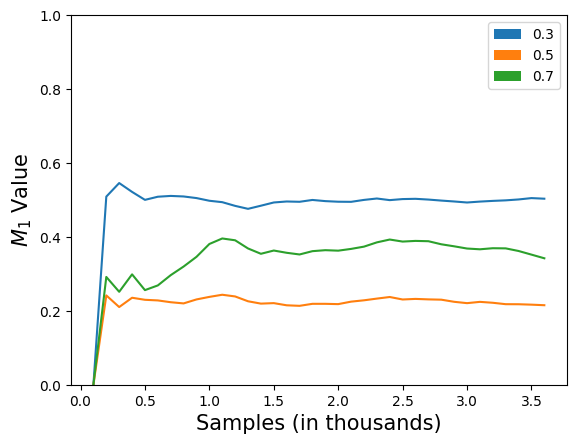

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 486.06it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


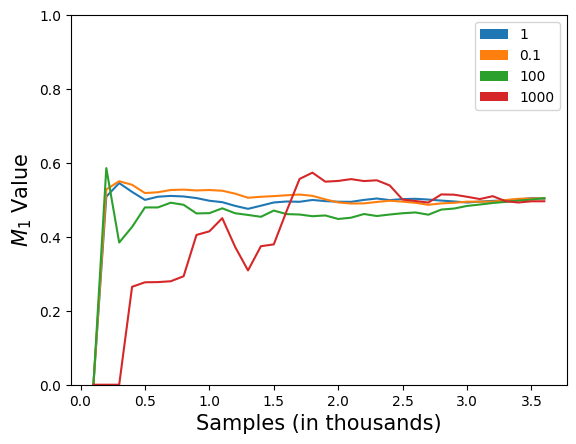

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 516.49it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


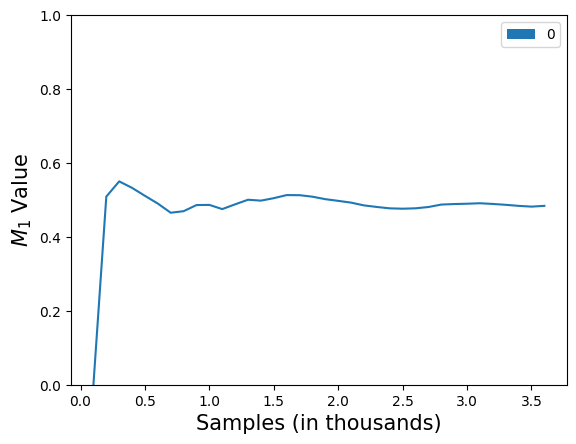

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 491.75it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


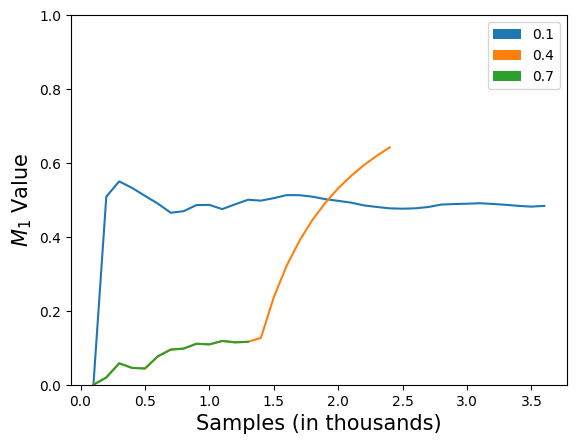

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 483.44it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


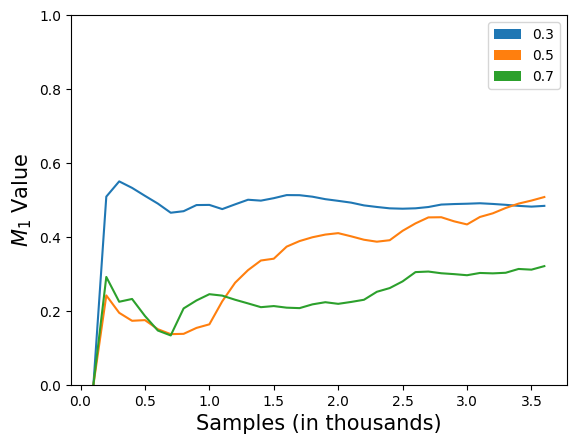

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 478.62it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


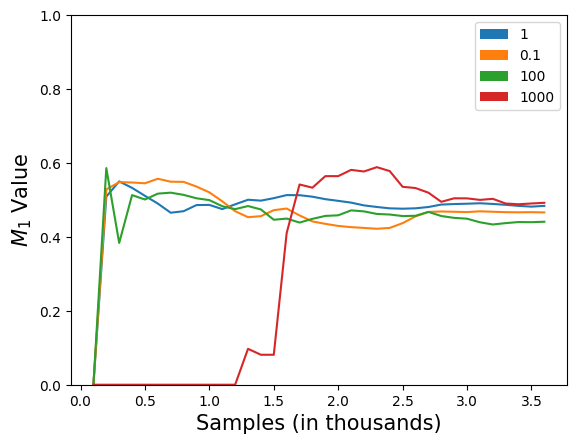

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 514.56it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


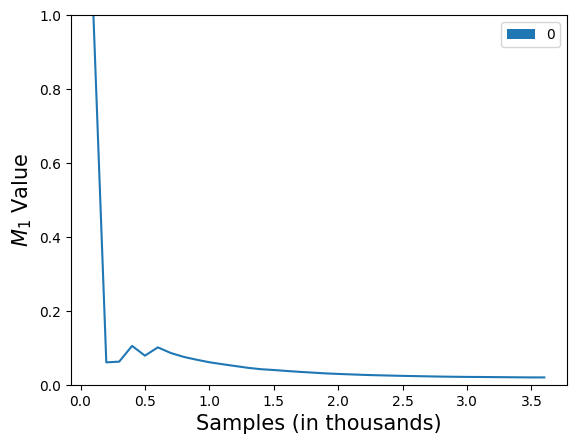

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 493.83it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


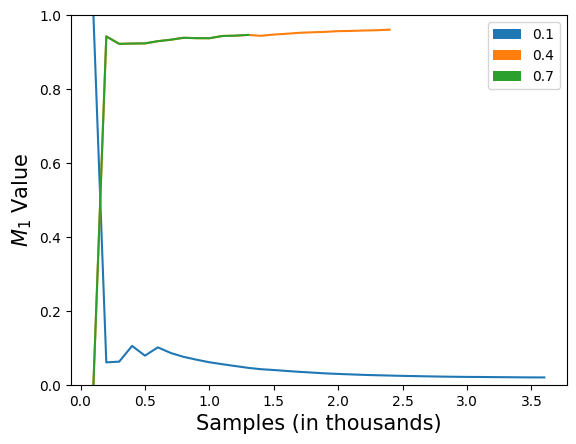

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 485.83it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


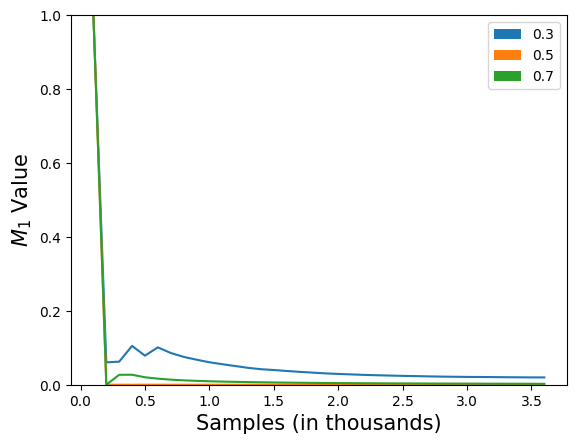

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 482.51it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


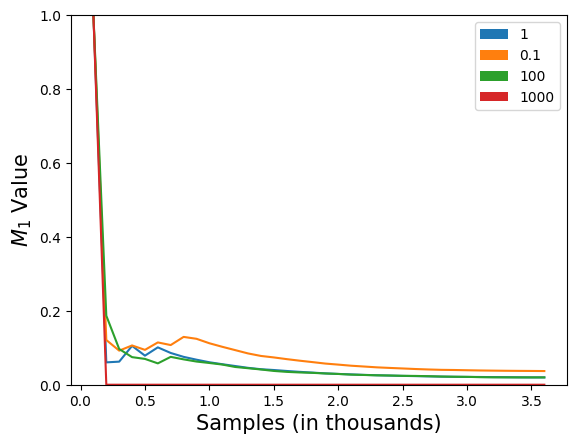

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 578.39it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


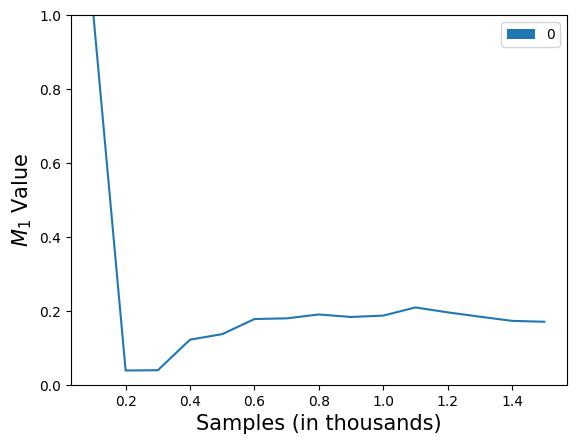

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 570.44it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


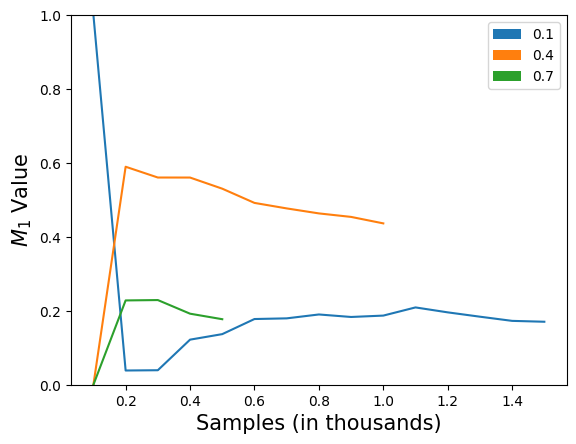

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 569.90it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


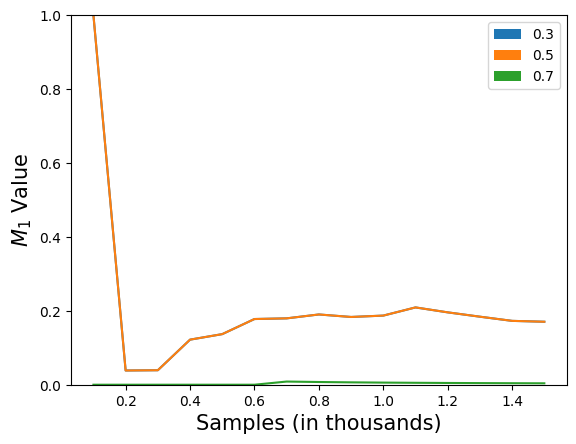

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 575.00it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


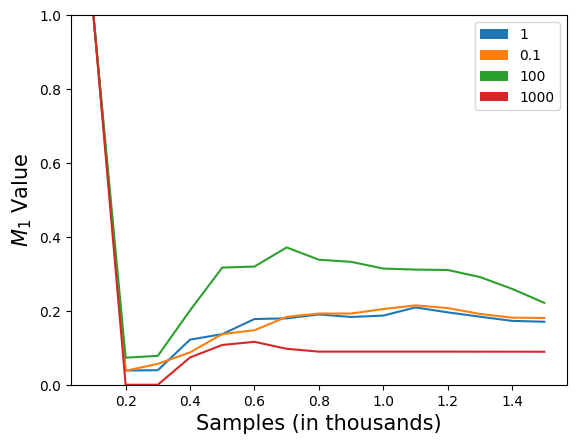

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 579.09it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


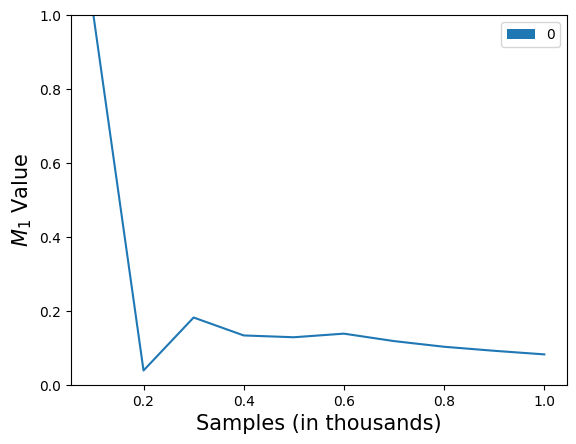

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 568.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


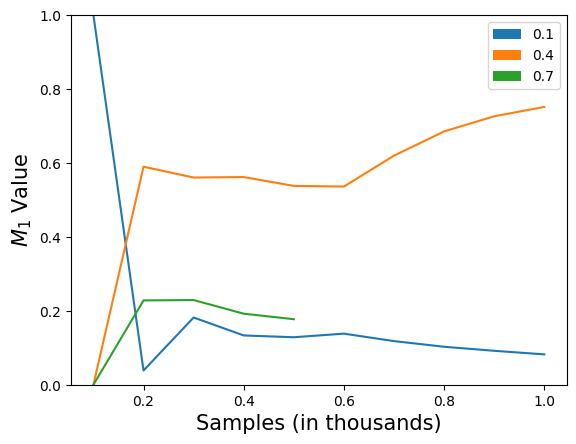

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 571.61it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


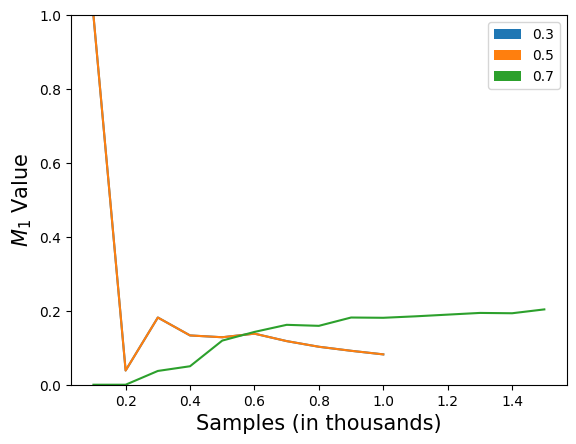

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 572.03it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


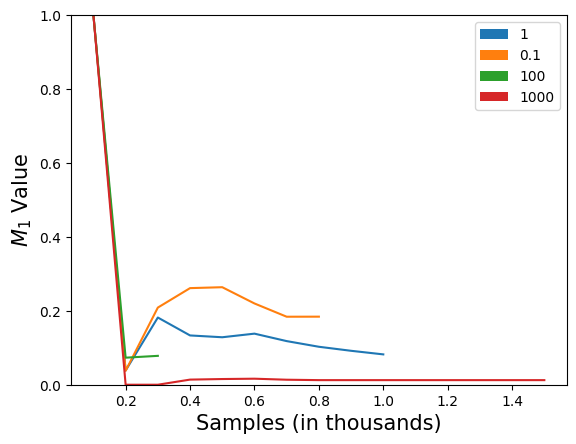

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 583.23it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


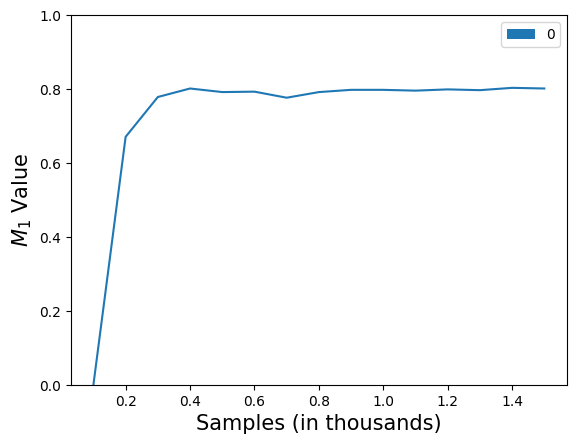

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 564.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


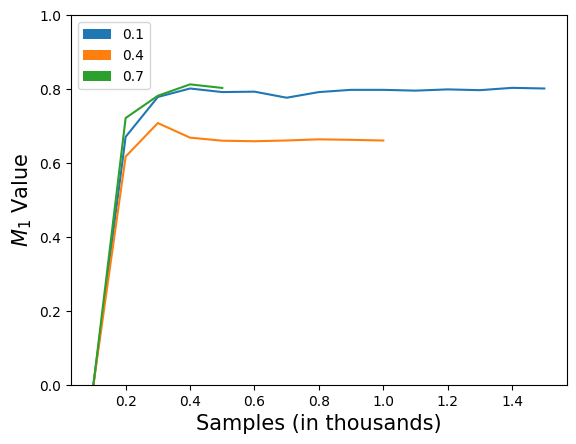

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 566.59it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


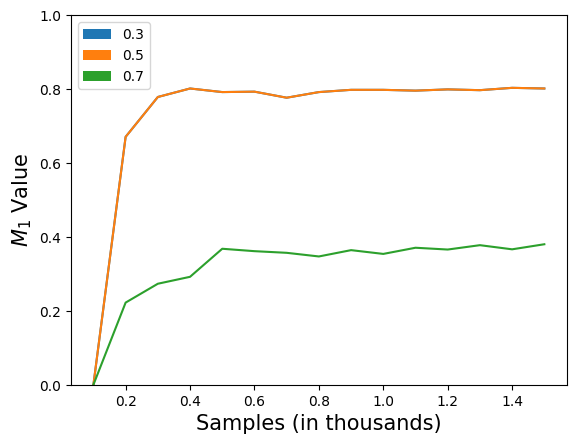

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 575.50it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


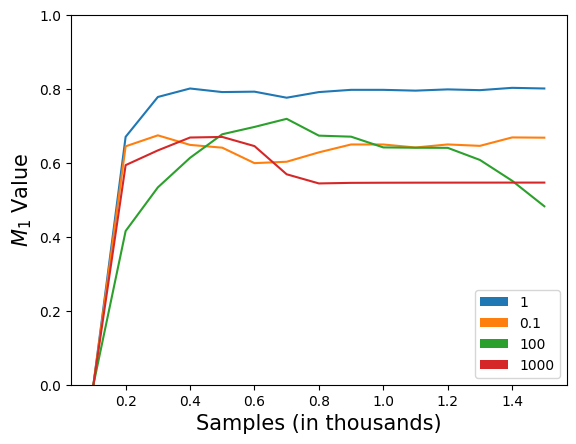

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 566.81it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


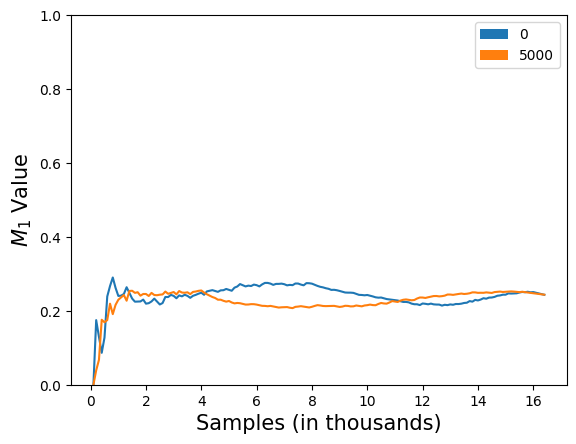

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 573.13it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


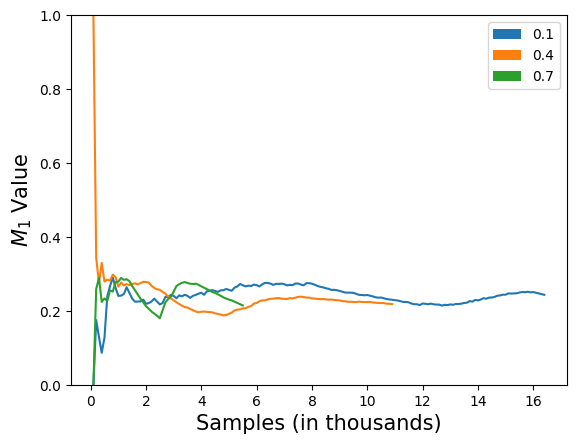

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 565.03it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


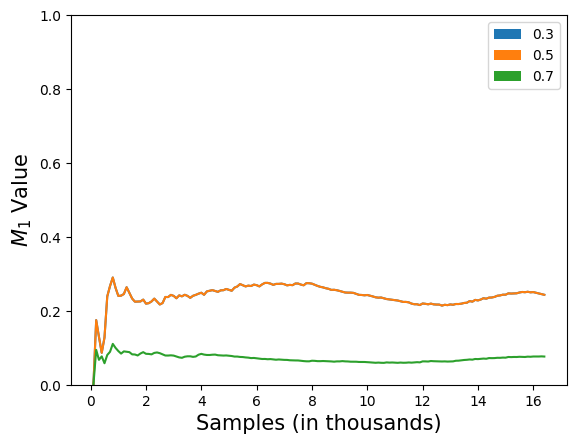

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 561.31it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


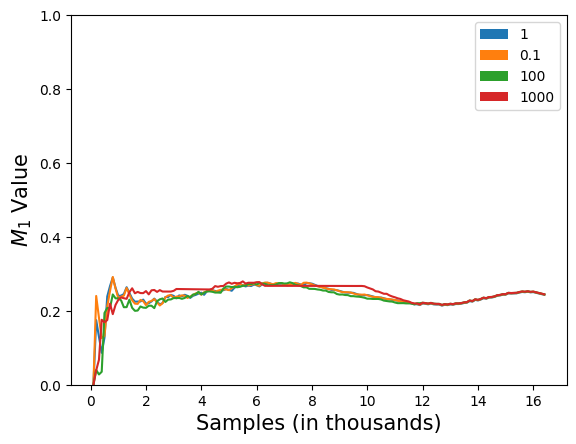

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 565.23it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


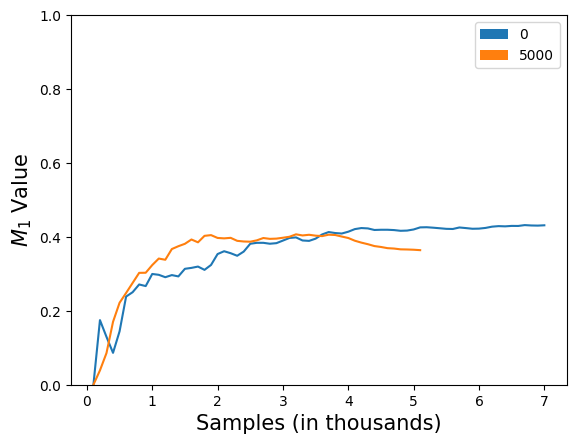

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 570.04it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


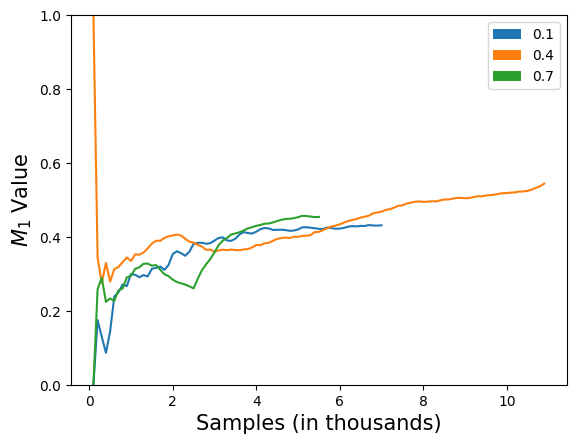

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 566.08it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


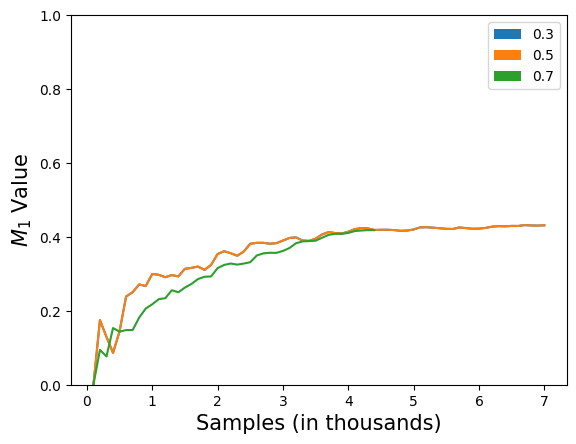

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 562.13it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


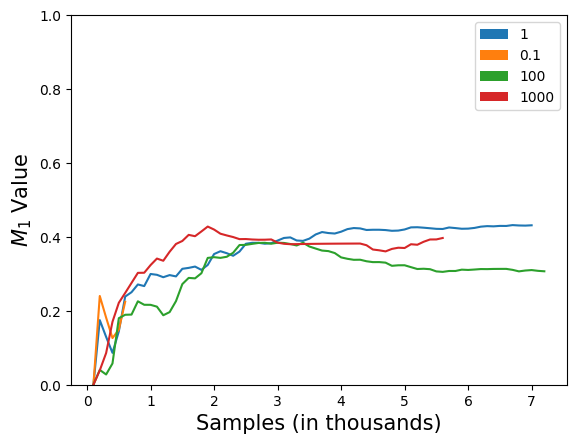

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 548.69it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


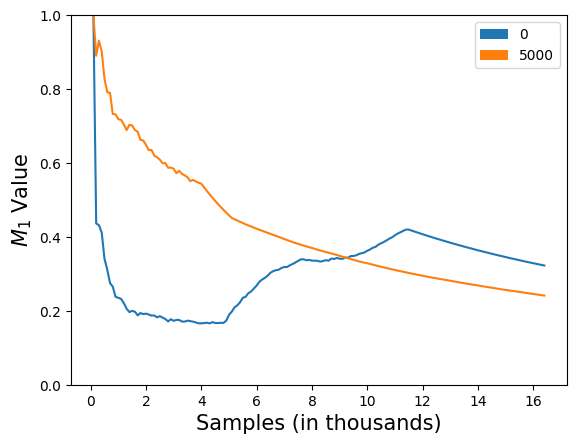

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 566.03it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


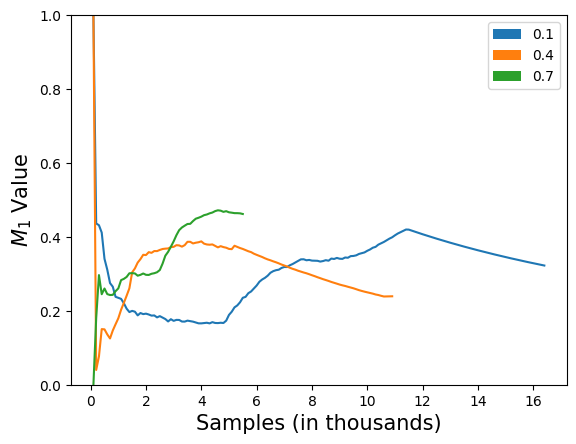

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 562.15it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


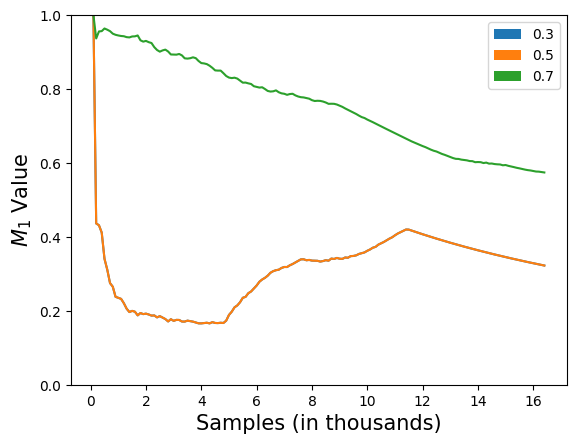

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 563.57it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


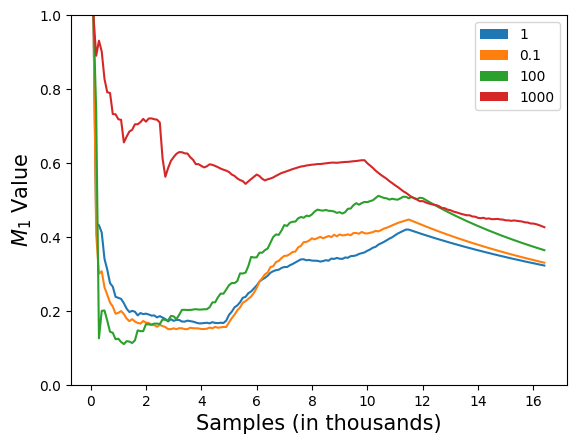

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 559.33it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


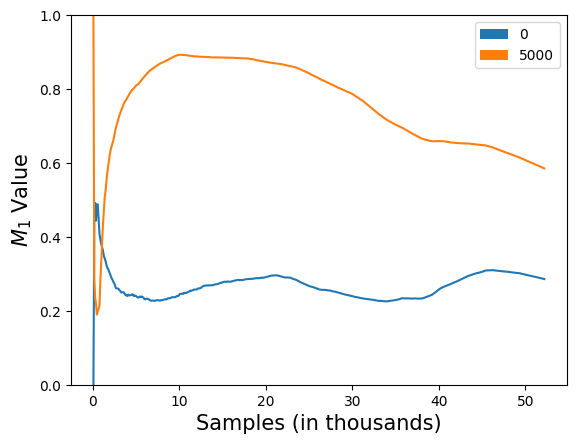

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 581.92it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


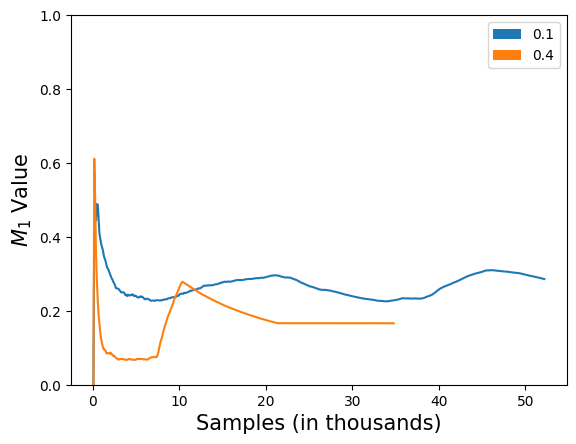

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 553.12it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


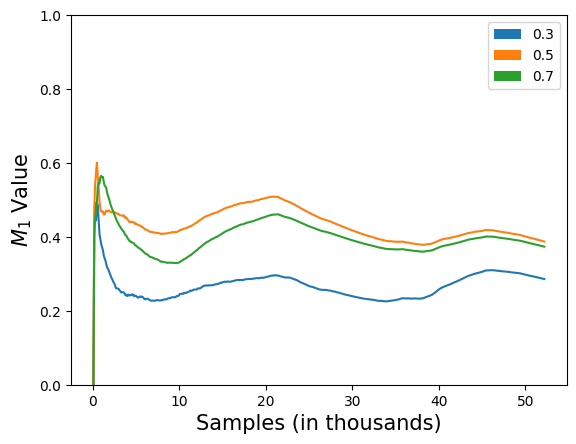

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 549.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


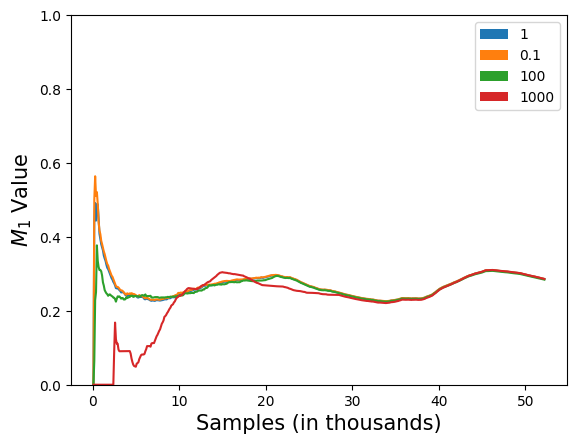

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 554.88it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


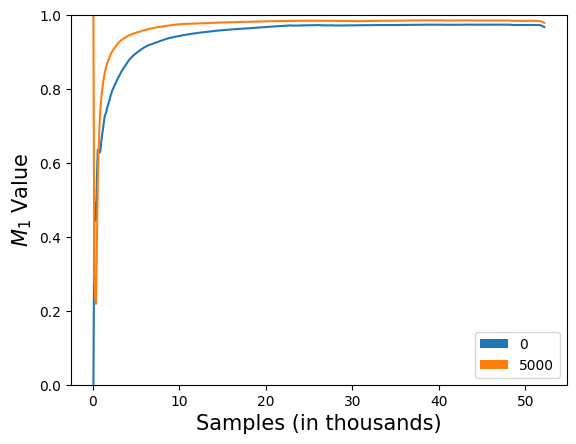

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 578.82it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


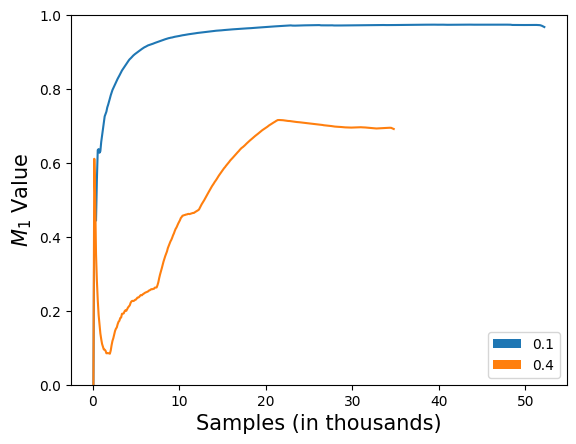

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 550.10it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


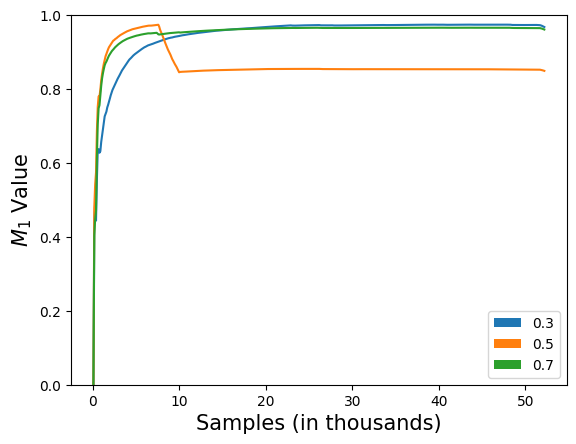

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 559.71it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


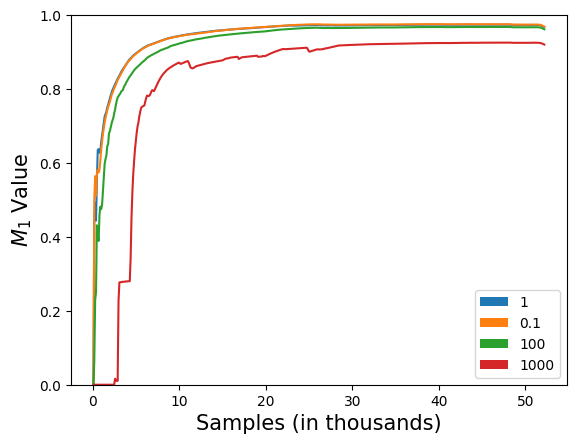

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 581.50it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


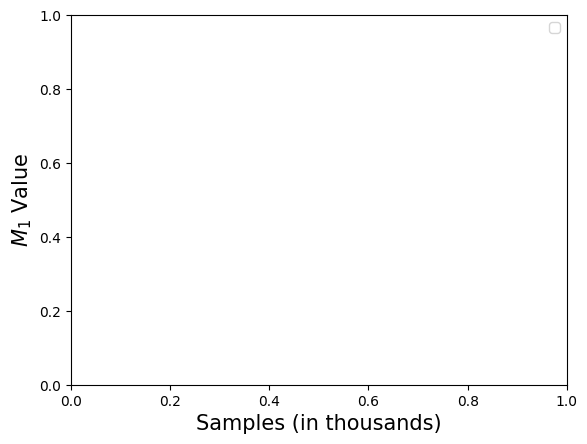

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 584.70it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


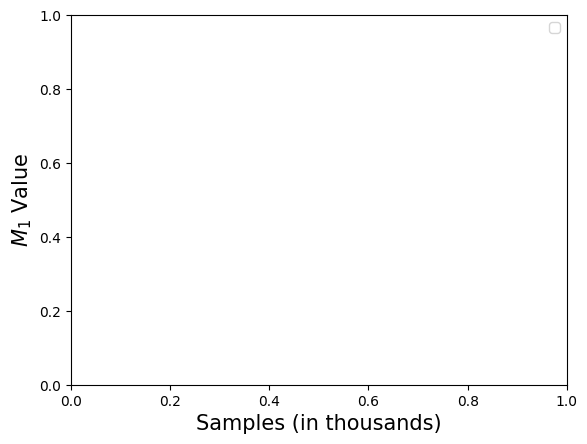

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 584.00it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


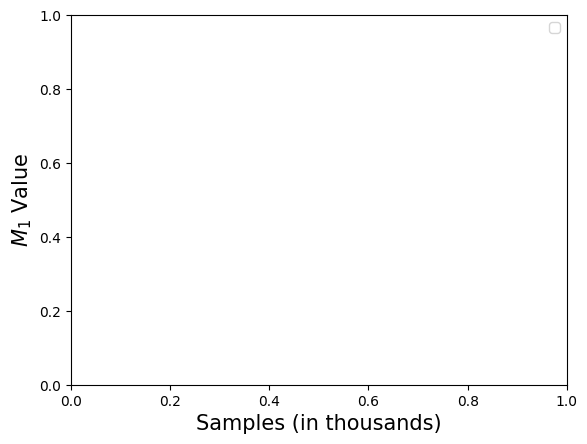

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 585.15it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


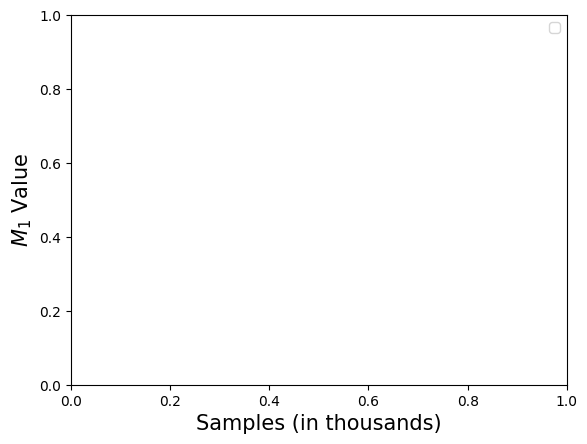

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 492.37it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


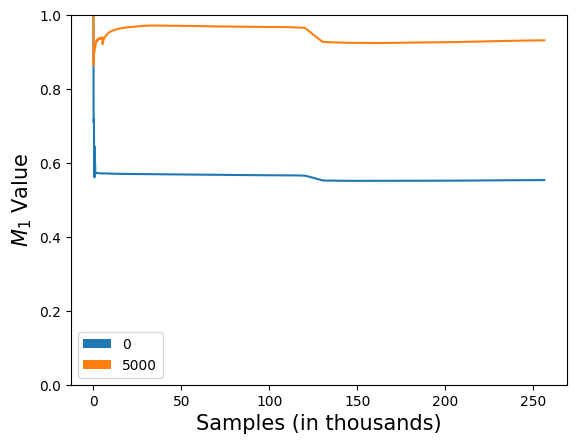

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 533.27it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


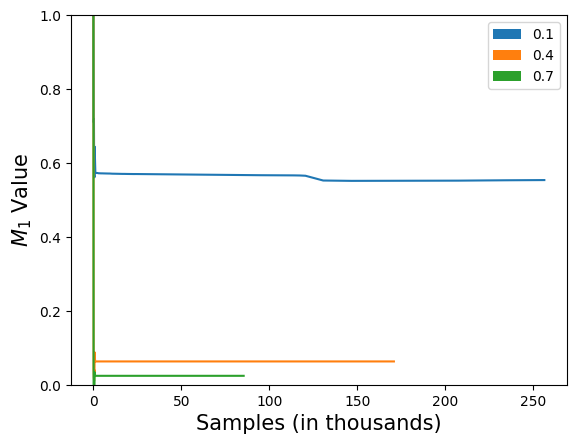

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 486.91it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


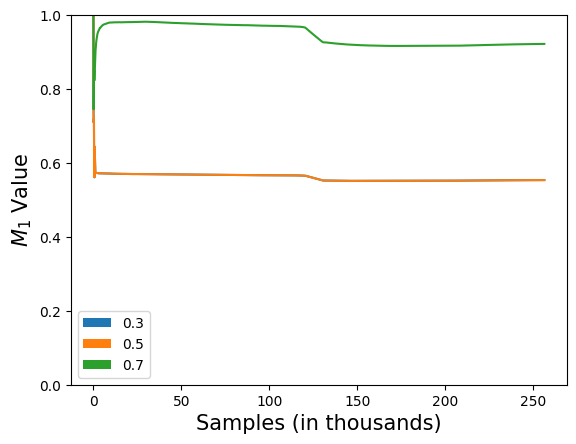

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 478.67it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


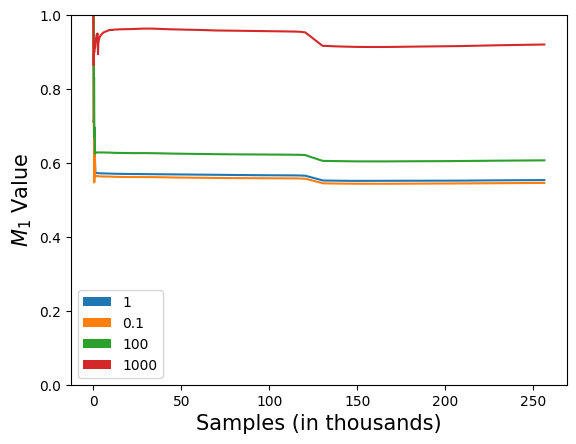

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 476.37it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


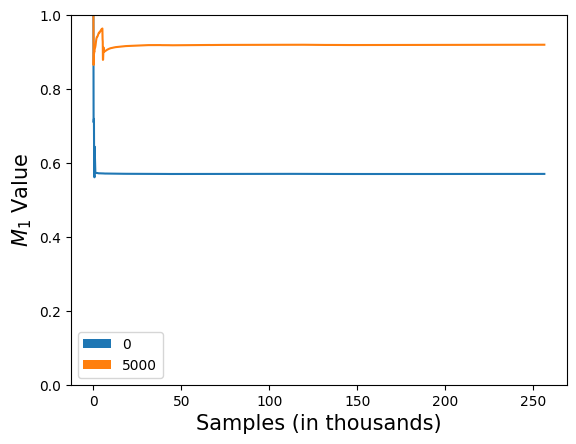

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 530.76it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


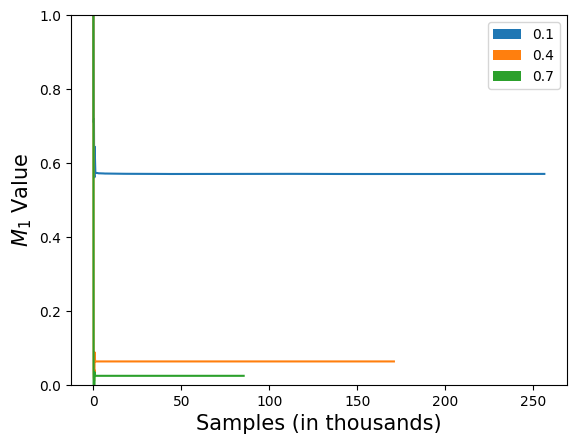

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 487.51it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


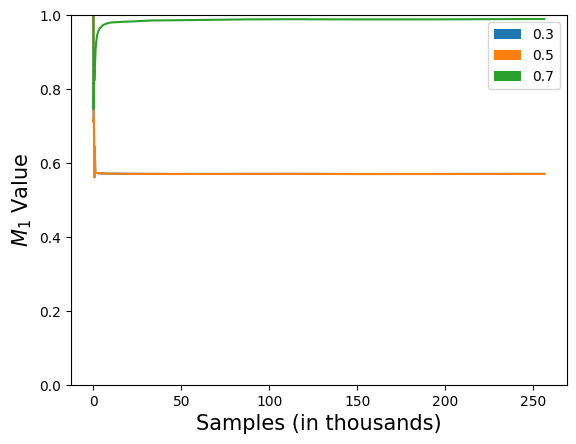

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 487.59it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


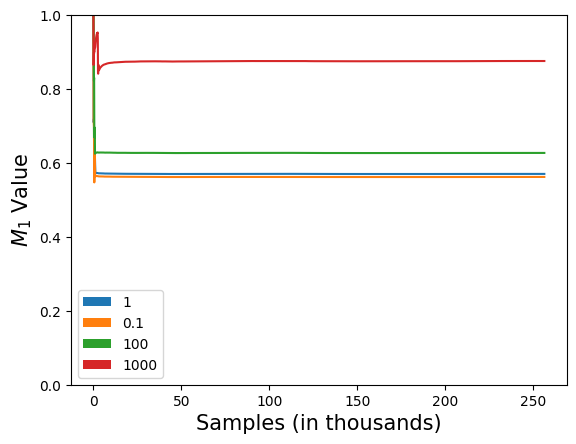

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 484.17it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


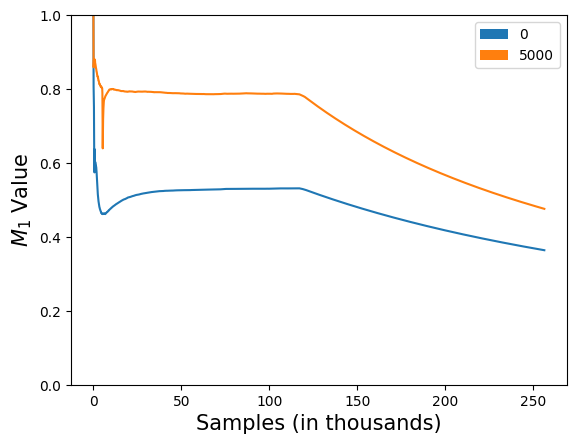

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 537.84it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


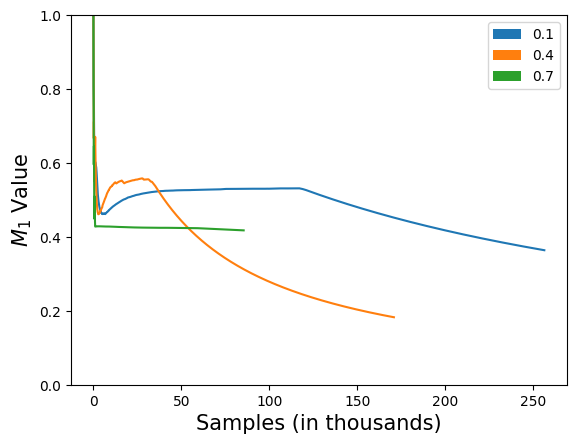

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 486.98it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


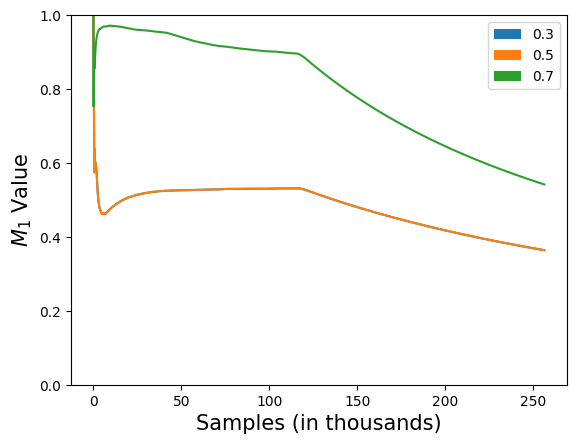

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 488.31it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


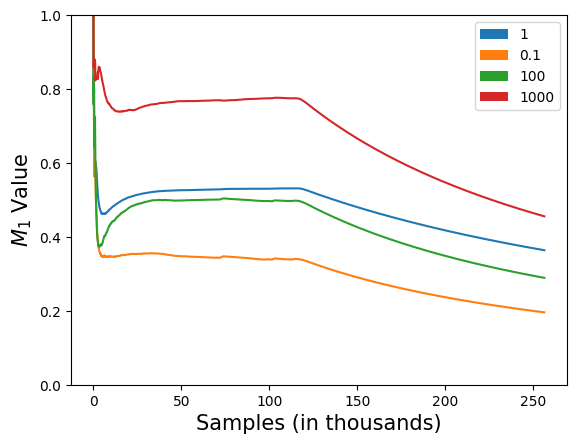

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 581.30it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


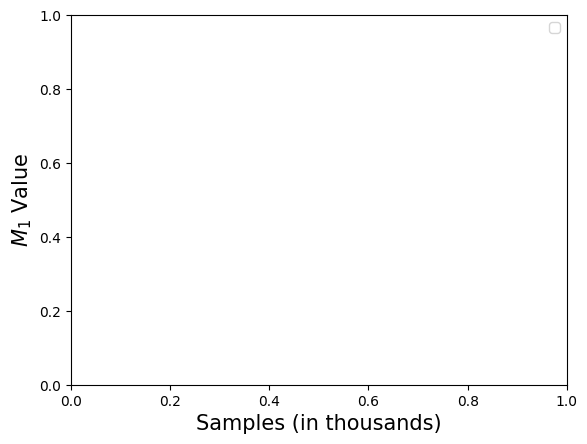

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 573.27it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


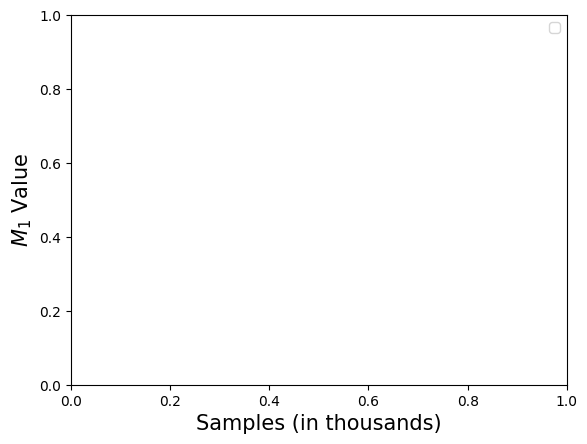

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 572.84it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


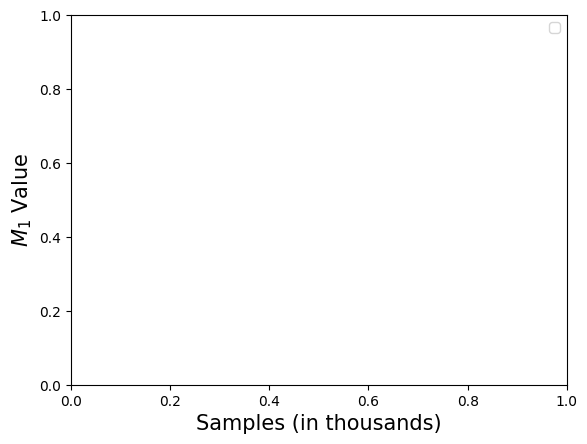

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 576.48it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


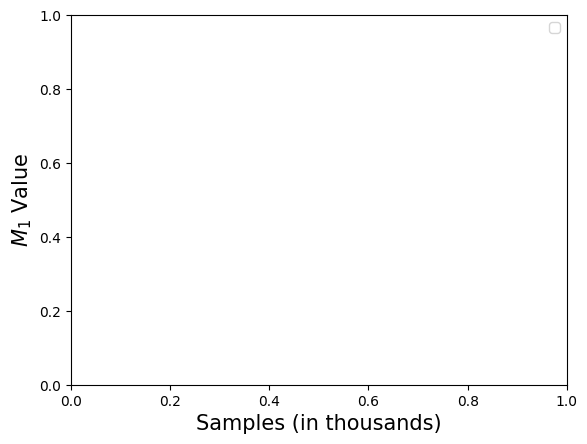

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 586.14it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


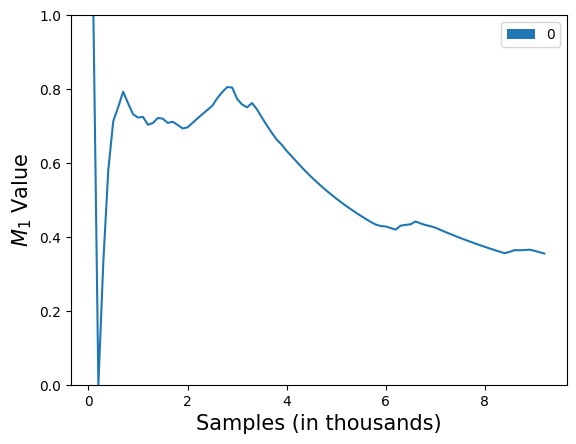

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 571.42it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


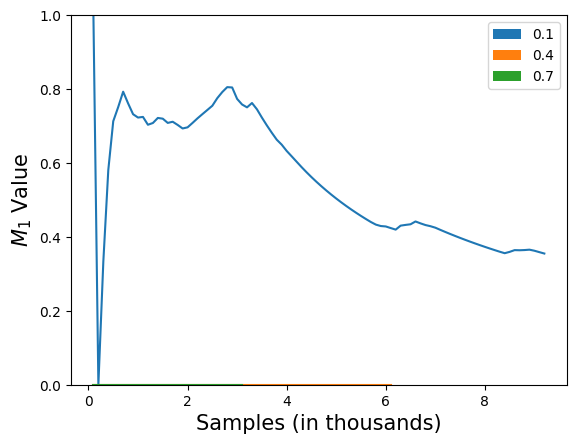

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 571.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


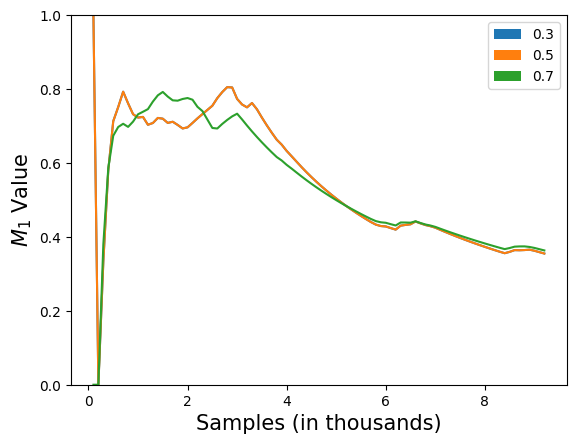

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.51it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


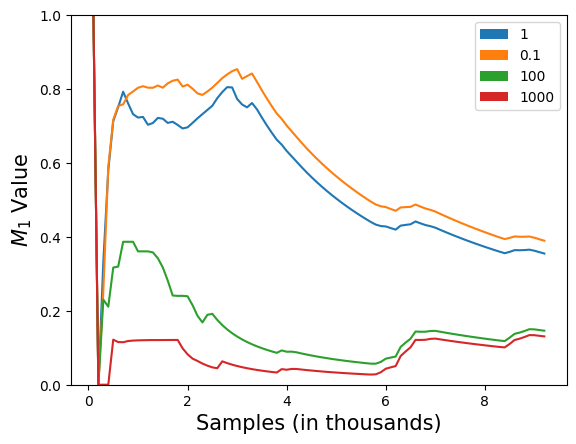

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 571.25it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


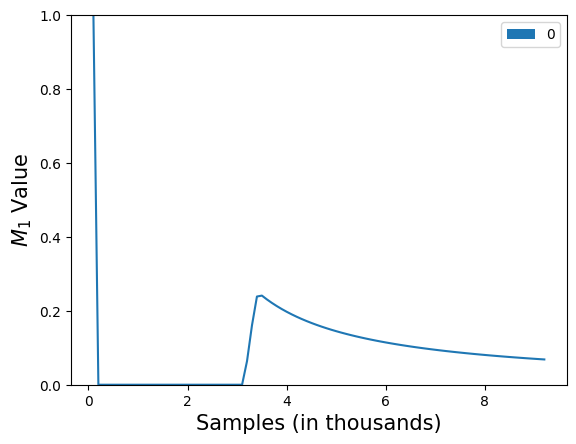

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 567.53it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


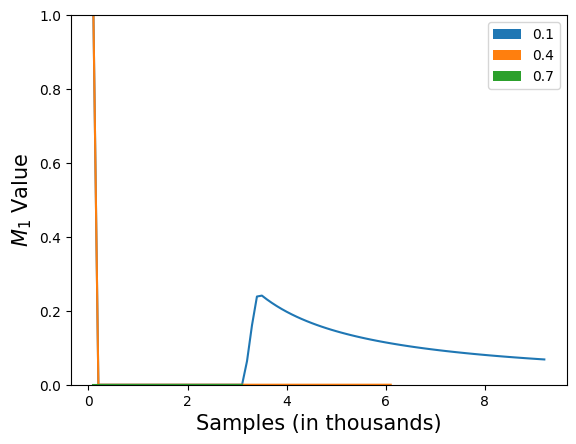

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 569.35it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


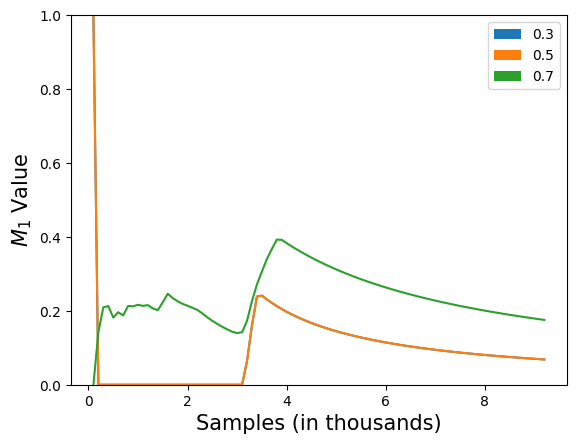

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 571.95it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


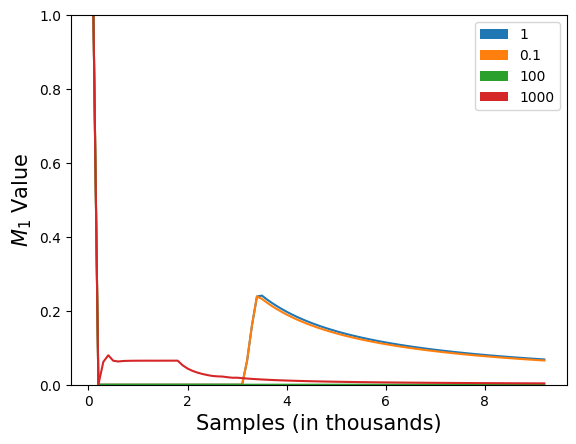

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 538.95it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


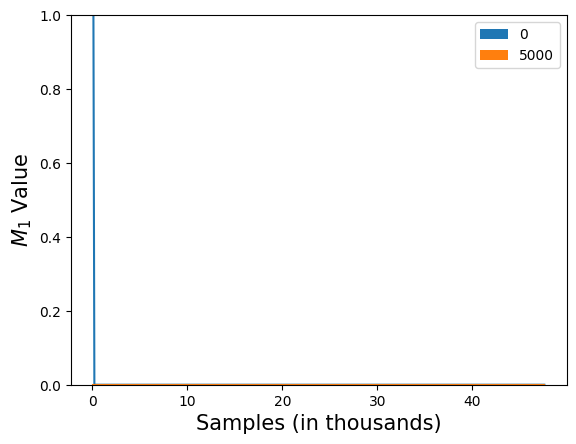

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 548.15it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


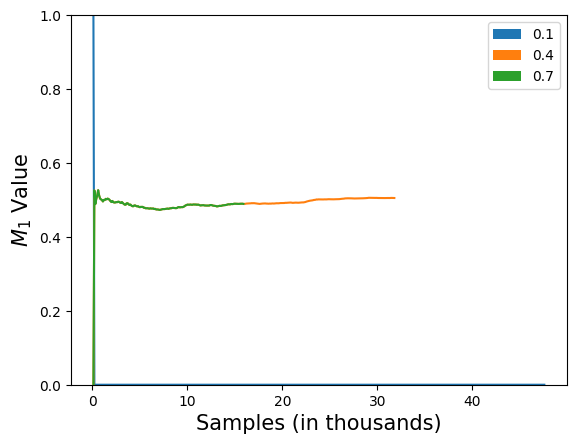

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 536.77it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


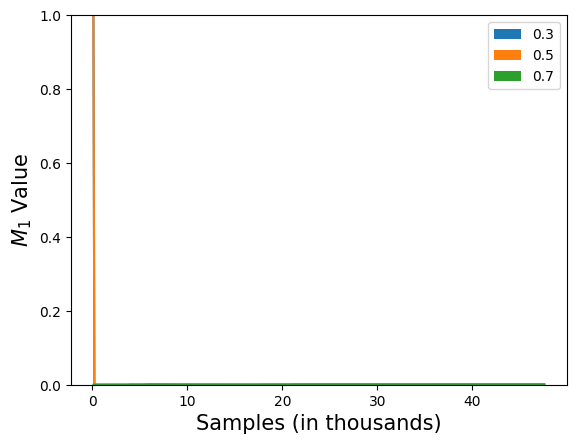

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 534.86it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


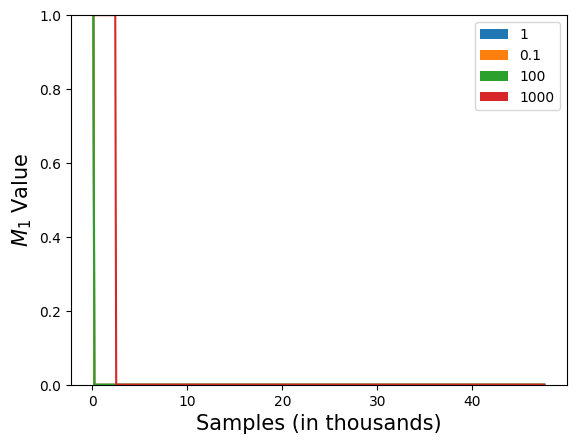

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 545.46it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


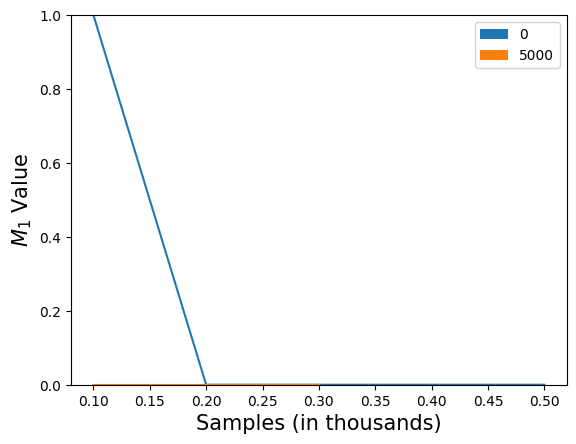

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 553.34it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


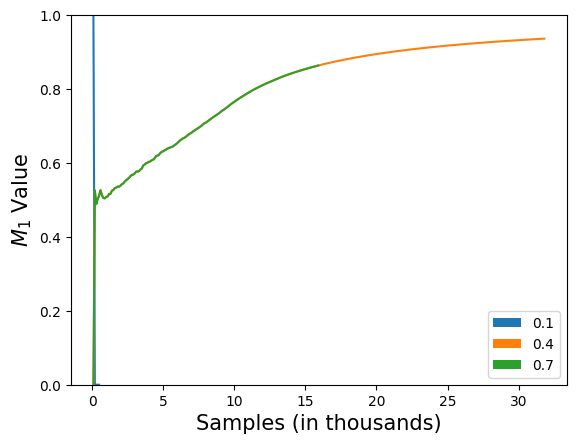

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 560.87it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


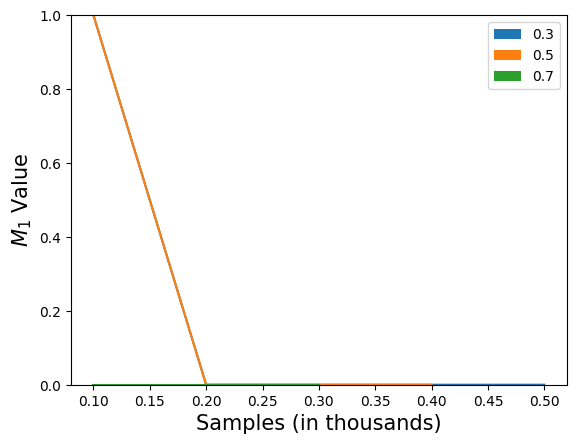

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 560.03it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


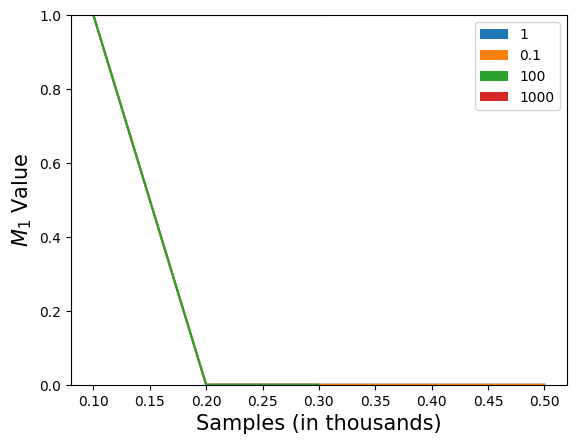

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 539.36it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


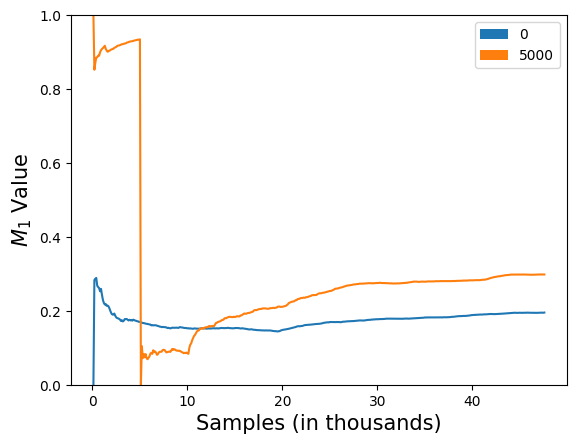

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 555.28it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


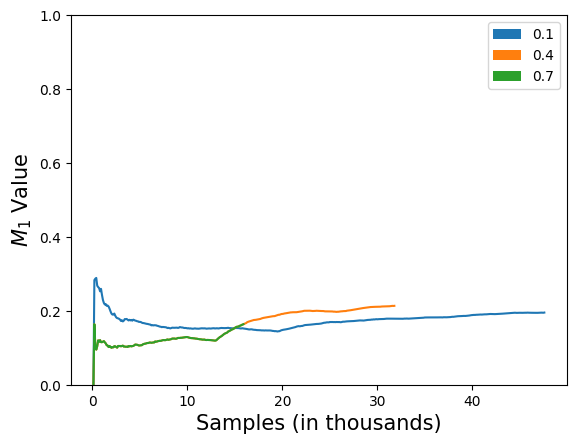

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 541.98it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


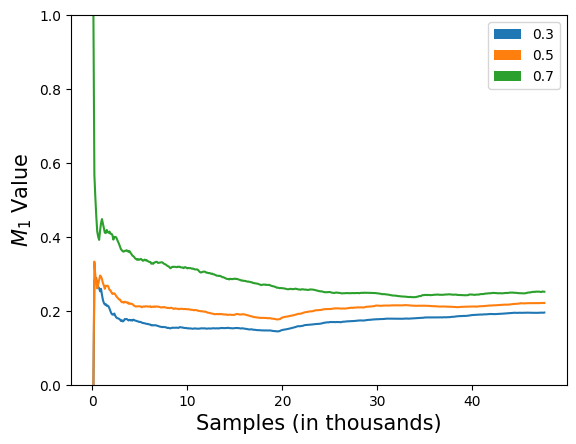

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 535.54it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


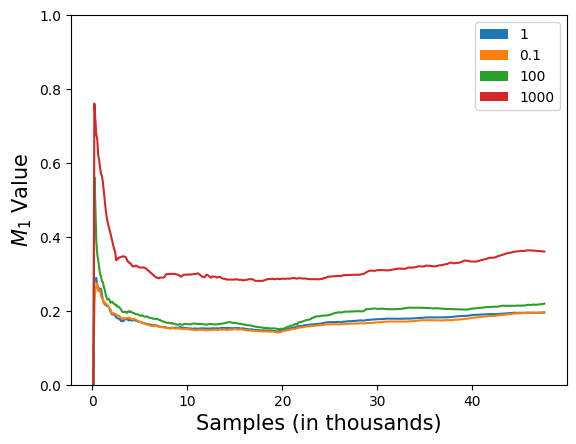

In [10]:
for dataset_name in datasets:
    for algo in algorithms:
        colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
        metric_name = 'inv_harm_mean'
        
        for rng in [range(0,2), range(2,5), range(5,8), range(8,12)]:
            fig, ax = plt.subplots()
            plt.xlabel('Samples (in thousands)', fontsize=15)
            plt.ylabel('$M_1$ Value', fontsize=15)
            plt.ylim(0,1)
            counter = 0
            handles = []
            
            for i in rng:
                if counter == 0:
                    query = f'run.experiment == "{dataset_name}" and {baseline} and "{algo}" in run.tags'
                else:
                    query = f'run.experiment == "{dataset_name}" and {queries[list_characteristics[i]]} and "{algo}" in run.tags'
                
            
                metrics = get_metrics(query, aim_repo, [metric_name])
            
                # Splitting for save name
                parts = list_characteristics[i].split('=')
                dc_name = parts[0].strip()
                dc_value = parts[1].strip()
        
                values = [elem[metric_name] for elem in metrics]
        
                if len(values) == 0:
                    continue
            
                max_values, min_values, mean_values = get_max_min_mean(values)
            
                x = ((np.arange(0, max(len(arr) for arr in values)) * 100 + 100) / 1000)
                ax.plot(x, mean_values, color = colors[counter])
                handles.append(Patch(facecolor=colors[counter], label=dc_value))
                
                counter += 1
                
            plt.legend(handles=handles)#, loc='upper center', bbox_to_anchor=(0.45, 1.15), ncol=5, fontsize=15)
            if save_path is not None:
                plt.savefig(f'{save_path}Range_plots/final/{dataset_name}_{algo}_{dc_name}_plot_m1.eps', format='eps', dpi=1200)
                plt.savefig(f'{save_path}Range_plots/final/{dataset_name}_{algo}_{dc_name}_plot_m1.png', format='png', dpi=1200)
        
            plt.show()

## Table

In [10]:
perc_change = {}

for dataset_name in datasets:
    perc_change[dataset_name] = {}
    
    for algo in algorithms:
        perc_change[dataset_name][algo] = {}

        query = f'run.experiment == "{dataset_name}" and {baseline} and "{algo}" in run.tags'
        vals = get_metrics(query, aim_repo, ['adj_mut_info', 'inv_harm_mean'])

        vals_metric = [elem['adj_mut_info'] for elem in vals]
        vals_metric_harm = [elem['inv_harm_mean'] for elem in vals]

        if len(vals_metric) == 0 or len(vals_metric_harm) == 0:
            continue
            
        combined_array = np.concatenate(vals_metric)
        combined_array_harm = np.concatenate(vals_metric_harm)
        
        base_mean = np.mean(combined_array)
        base_median = np.median(combined_array)
        base_std = np.std(combined_array)

        base_mean_harm = np.mean(combined_array_harm)
        base_median_harm = np.median(combined_array_harm)
        base_std_harm = np.std(combined_array_harm)
        
        
        for characteristic in queries.keys():
            query = f'run.experiment == "{dataset_name}" and {queries[characteristic]} and "{algo}" in run.tags'
            vals = get_metrics(query, aim_repo, ['adj_mut_info', 'inv_harm_mean'])
            
            vals_metric = [elem['adj_mut_info'] for elem in vals]
            vals_metric_harm = [elem['inv_harm_mean'] for elem in vals]
            
            if len(vals_metric) == 0 or len(vals_metric_harm) == 0:
                continue
            
            combined_array = np.concatenate(vals_metric)
            combined_array_harm = np.concatenate(vals_metric_harm)
            perc_change[dataset_name][algo][characteristic] = {}

            perc_change[dataset_name][algo][characteristic]['per_mean'] = percentage_change(base_mean, np.mean(combined_array))
            perc_change[dataset_name][algo][characteristic]['change_mean'] = np.mean(combined_array) - base_mean
            
            perc_change[dataset_name][algo][characteristic]['per_median'] = percentage_change(base_median, np.median(combined_array))
            perc_change[dataset_name][algo][characteristic]['change_median'] = np.median(combined_array) - base_median
            
            perc_change[dataset_name][algo][characteristic]['per_std'] = percentage_change(base_std, np.std(combined_array))
            perc_change[dataset_name][algo][characteristic]['change_std'] = np.std(combined_array) - base_std


            perc_change[dataset_name][algo][characteristic]['per_mean_harm'] = percentage_change(base_mean_harm, np.mean(combined_array_harm))
            perc_change[dataset_name][algo][characteristic]['change_mean_harm'] = np.mean(combined_array_harm) - base_mean_harm
            
            perc_change[dataset_name][algo][characteristic]['per_median_harm'] = percentage_change(base_median_harm, np.median(combined_array_harm))
            perc_change[dataset_name][algo][characteristic]['change_median_harm'] = np.median(combined_array_harm) - base_median_harm
            
            perc_change[dataset_name][algo][characteristic]['per_std_harm'] = percentage_change(base_std_harm, np.std(combined_array_harm))
            perc_change[dataset_name][algo][characteristic]['change_std_harm'] = np.std(combined_array_harm) - base_std_harm

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 533.09it/s]


In [11]:
perc_change

{'elec.csv': {'ECSMinerWF': {'wait_time=5000': {'per_mean': 37.37790772915218,
    'change_mean': 0.02254549609917724,
    'per_median': 69.7257754477416,
    'change_median': 0.03203156225907017,
    'per_std': 29.468184928673097,
    'change_std': 0.017218920796927807,
    'per_mean_harm': 0,
    'change_mean_harm': 0.0,
    'per_median_harm': 0,
    'change_median_harm': 0.0,
    'per_std_harm': 0,
    'change_std_harm': 0.0},
   'ratio_offline=0.4': {'per_mean': 375.29819673471627,
    'change_mean': 0.2263712589753006,
    'per_median': 493.4823382830677,
    'change_median': 0.22670253777690463,
    'per_std': 141.550866329937,
    'change_std': 0.0827113431645432,
    'per_mean_harm': 0,
    'change_mean_harm': 0.0,
    'per_median_harm': 0,
    'change_median_harm': 0.0,
    'per_std_harm': 0,
    'change_std_harm': 0.0},
   'ratio_offline=0.7': {'per_mean': -87.80964696350011,
    'change_mean': -0.05296476376984805,
    'per_median': -100.0,
    'change_median': -0.0459393417

In [12]:
mean_perc_change = {}

for characteristic in queries.keys():
    mean_perc_change[characteristic] = {}

    for algo in algorithms:
        mean_perc_change[characteristic][algo] = {}

        all_per_mean = []
        all_change_mean = []
        all_per_median = []
        all_change_median = []
        all_per_std = []
        all_change_std = []

        all_per_mean_harm = []
        all_change_mean_harm = []
        all_per_median_harm = []
        all_change_median_harm = []
        all_per_std_harm = []
        all_change_std_harm = []

        for dataset_name in datasets:
            if characteristic in perc_change[dataset_name][algo] and perc_change[dataset_name][algo][characteristic]:
                all_per_mean.append(perc_change[dataset_name][algo][characteristic]['per_mean'])
                all_change_mean.append(perc_change[dataset_name][algo][characteristic]['change_mean'])
    
                all_per_median.append(perc_change[dataset_name][algo][characteristic]['per_median'])
                all_change_median.append(perc_change[dataset_name][algo][characteristic]['change_median'])
    
                all_per_std.append(perc_change[dataset_name][algo][characteristic]['per_std'])
                all_change_std.append(perc_change[dataset_name][algo][characteristic]['change_std'])


                all_per_mean_harm.append(perc_change[dataset_name][algo][characteristic]['per_mean_harm'])
                all_change_mean_harm.append(perc_change[dataset_name][algo][characteristic]['change_mean_harm'])
    
                all_per_median_harm.append(perc_change[dataset_name][algo][characteristic]['per_median_harm'])
                all_change_median_harm.append(perc_change[dataset_name][algo][characteristic]['change_median_harm'])
    
                all_per_std_harm.append(perc_change[dataset_name][algo][characteristic]['per_std_harm'])
                all_change_std_harm.append(perc_change[dataset_name][algo][characteristic]['change_std_harm'])

        mean_perc_change[characteristic][algo]['per_mean'] = np.mean(all_per_mean)
        mean_perc_change[characteristic][algo]['change_mean'] = np.mean(all_change_mean)
        mean_perc_change[characteristic][algo]['per_median'] = np.mean(all_per_median)
        mean_perc_change[characteristic][algo]['change_median'] = np.mean(all_change_median)
        mean_perc_change[characteristic][algo]['per_std'] = np.mean(all_per_std)
        mean_perc_change[characteristic][algo]['change_std'] = np.mean(all_change_std)

        mean_perc_change[characteristic][algo]['per_mean_harm'] = np.mean(all_per_mean_harm)
        mean_perc_change[characteristic][algo]['change_mean_harm'] = np.mean(all_change_mean_harm)
        mean_perc_change[characteristic][algo]['per_median_harm'] = np.mean(all_per_median_harm)
        mean_perc_change[characteristic][algo]['change_median_harm'] = np.mean(all_change_median_harm)
        mean_perc_change[characteristic][algo]['per_std_harm'] = np.mean(all_per_std_harm)
        mean_perc_change[characteristic][algo]['change_std_harm'] = np.mean(all_change_std_harm)
        

In [13]:
mean_perc_change

{'wait_time=5000': {'ECSMinerWF': {'per_mean': 42.275553669069964,
   'change_mean': 0.02925412566720574,
   'per_median': 119.87698746313355,
   'change_median': 0.0247821810979124,
   'per_std': 34.438992709549105,
   'change_std': 0.019749657918636362,
   'per_mean_harm': 22.63190068820397,
   'change_mean_harm': 0.13648951991274036,
   'per_median_harm': 41.3770100992656,
   'change_median_harm': 0.14102255480801615,
   'per_std_harm': 30.625179591464775,
   'change_std_harm': 0.008164921647186341},
  'ECSMiner': {'per_mean': 63.649871487954556,
   'change_mean': 0.07952610657796517,
   'per_median': 62.363114110764165,
   'change_median': 0.0817070691161987,
   'per_std': 59.40630025277918,
   'change_std': 0.05596341651030529,
   'per_mean_harm': -0.4837004692158094,
   'change_mean_harm': 0.05958750873224256,
   'per_median_harm': 19.560710046047564,
   'change_median_harm': 0.11084702430063126,
   'per_std_harm': 7.724201658501609,
   'change_std_harm': -0.04025540590720381},
 

## Table ratio known classes multi-class

In [12]:
datasets_mc = ['gassensor.arff', 'powersupply.arff', 'rialto.arff', 'outdoor.arff', 'keystroke.arff', 'shuttle.csv', 'room_occupancy.csv', 'INSECTS-abrupt_balanced_norm.arff']
offline_mc_keys = ['ratio_known=0.5', 'ratio_known=0.7']

In [13]:
perc_change = {}

for dataset_name in datasets_mc:
    perc_change[dataset_name] = {}
    
    for algo in algorithms:
        perc_change[dataset_name][algo] = {}

        query = f'run.experiment == "{dataset_name}" and {baseline} and "{algo}" in run.tags'
        vals = get_metrics(query, aim_repo, ['adj_mut_info', 'inv_harm_mean'])

        vals_metric = [elem['adj_mut_info'] for elem in vals]
        vals_metric_harm = [elem['inv_harm_mean'] for elem in vals]

        if len(vals_metric) == 0 or len(vals_metric_harm) == 0:
            continue
            
        combined_array = np.concatenate(vals_metric)
        combined_array_harm = np.concatenate(vals_metric_harm)
        
        base_mean = np.mean(combined_array)
        base_median = np.median(combined_array)
        base_std = np.std(combined_array)

        base_mean_harm = np.mean(combined_array_harm)
        base_median_harm = np.median(combined_array_harm)
        base_std_harm = np.std(combined_array_harm)
        
        
        for characteristic in offline_mc_keys:
            query = f'run.experiment == "{dataset_name}" and {queries[characteristic]} and "{algo}" in run.tags'
            vals = get_metrics(query, aim_repo, ['adj_mut_info', 'inv_harm_mean'])
            
            vals_metric = [elem['adj_mut_info'] for elem in vals]
            vals_metric_harm = [elem['inv_harm_mean'] for elem in vals]
            
            if len(vals_metric) == 0 or len(vals_metric_harm) == 0:
                continue
            
            combined_array = np.concatenate(vals_metric)
            combined_array_harm = np.concatenate(vals_metric_harm)
            perc_change[dataset_name][algo][characteristic] = {}

            perc_change[dataset_name][algo][characteristic]['per_mean'] = percentage_change(base_mean, np.mean(combined_array))
            perc_change[dataset_name][algo][characteristic]['change_mean'] = np.mean(combined_array) - base_mean
            
            perc_change[dataset_name][algo][characteristic]['per_median'] = percentage_change(base_median, np.median(combined_array))
            perc_change[dataset_name][algo][characteristic]['change_median'] = np.median(combined_array) - base_median
            
            perc_change[dataset_name][algo][characteristic]['per_std'] = percentage_change(base_std, np.std(combined_array))
            perc_change[dataset_name][algo][characteristic]['change_std'] = np.std(combined_array) - base_std


            perc_change[dataset_name][algo][characteristic]['per_mean_harm'] = percentage_change(base_mean_harm, np.mean(combined_array_harm))
            perc_change[dataset_name][algo][characteristic]['change_mean_harm'] = np.mean(combined_array_harm) - base_mean_harm
            
            perc_change[dataset_name][algo][characteristic]['per_median_harm'] = percentage_change(base_median_harm, np.median(combined_array_harm))
            perc_change[dataset_name][algo][characteristic]['change_median_harm'] = np.median(combined_array_harm) - base_median_harm
            
            perc_change[dataset_name][algo][characteristic]['per_std_harm'] = percentage_change(base_std_harm, np.std(combined_array_harm))
            perc_change[dataset_name][algo][characteristic]['change_std_harm'] = np.std(combined_array_harm) - base_std_harm

100%|█████████████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 539.75it/s]


In [17]:
perc_change.keys()

dict_keys(['gassensor.arff', 'powersupply.arff', 'rialto.arff', 'outdoor.arff', 'keystroke.arff', 'shuttle.csv', 'room_occupancy.csv', 'INSECTS-abrupt_balanced_norm.arff'])

In [14]:
mean_perc_change = {}

for characteristic in offline_mc_keys:
    mean_perc_change[characteristic] = {}

    for algo in algorithms:
        mean_perc_change[characteristic][algo] = {}

        all_per_mean = []
        all_change_mean = []
        all_per_median = []
        all_change_median = []
        all_per_std = []
        all_change_std = []

        all_per_mean_harm = []
        all_change_mean_harm = []
        all_per_median_harm = []
        all_change_median_harm = []
        all_per_std_harm = []
        all_change_std_harm = []

        for dataset_name in datasets_mc:
            if characteristic in perc_change[dataset_name][algo] and perc_change[dataset_name][algo][characteristic]:
                all_per_mean.append(perc_change[dataset_name][algo][characteristic]['per_mean'])
                all_change_mean.append(perc_change[dataset_name][algo][characteristic]['change_mean'])
    
                all_per_median.append(perc_change[dataset_name][algo][characteristic]['per_median'])
                all_change_median.append(perc_change[dataset_name][algo][characteristic]['change_median'])
    
                all_per_std.append(perc_change[dataset_name][algo][characteristic]['per_std'])
                all_change_std.append(perc_change[dataset_name][algo][characteristic]['change_std'])


                all_per_mean_harm.append(perc_change[dataset_name][algo][characteristic]['per_mean_harm'])
                all_change_mean_harm.append(perc_change[dataset_name][algo][characteristic]['change_mean_harm'])
    
                all_per_median_harm.append(perc_change[dataset_name][algo][characteristic]['per_median_harm'])
                all_change_median_harm.append(perc_change[dataset_name][algo][characteristic]['change_median_harm'])
    
                all_per_std_harm.append(perc_change[dataset_name][algo][characteristic]['per_std_harm'])
                all_change_std_harm.append(perc_change[dataset_name][algo][characteristic]['change_std_harm'])

        mean_perc_change[characteristic][algo]['per_mean'] = np.mean(all_per_mean)
        mean_perc_change[characteristic][algo]['change_mean'] = np.mean(all_change_mean)
        mean_perc_change[characteristic][algo]['per_median'] = np.mean(all_per_median)
        mean_perc_change[characteristic][algo]['change_median'] = np.mean(all_change_median)
        mean_perc_change[characteristic][algo]['per_std'] = np.mean(all_per_std)
        mean_perc_change[characteristic][algo]['change_std'] = np.mean(all_change_std)

        mean_perc_change[characteristic][algo]['per_mean_harm'] = np.mean(all_per_mean_harm)
        mean_perc_change[characteristic][algo]['change_mean_harm'] = np.mean(all_change_mean_harm)
        mean_perc_change[characteristic][algo]['per_median_harm'] = np.mean(all_per_median_harm)
        mean_perc_change[characteristic][algo]['change_median_harm'] = np.mean(all_change_median_harm)
        mean_perc_change[characteristic][algo]['per_std_harm'] = np.mean(all_per_std_harm)
        mean_perc_change[characteristic][algo]['change_std_harm'] = np.mean(all_change_std_harm)
        

In [15]:
mean_perc_change

{'ratio_known=0.5': {'ECSMinerWF': {'per_mean': 4.573003381968948,
   'change_mean': 0.012071916830650568,
   'per_median': 6003.627935963185,
   'change_median': 0.01292836989287323,
   'per_std': -4.870405223551648,
   'change_std': -0.004059650215024238,
   'per_mean_harm': -4.8646549558600265,
   'change_mean_harm': -0.05360021090446603,
   'per_median_harm': inf,
   'change_median_harm': -0.053890903511820645,
   'per_std_harm': 6.097886658696289,
   'change_std_harm': -0.0007133485617224627},
  'ECSMiner': {'per_mean': 1.0277052407787504,
   'change_mean': 0.0042082538915377676,
   'per_median': -0.8354971513698963,
   'change_median': 0.0007644154244405652,
   'per_std': -0.48775586056730647,
   'change_std': 0.0030460076399733676,
   'per_mean_harm': 0.7218077339210984,
   'change_mean_harm': -0.006457703020200035,
   'per_median_harm': -2.256815841398382,
   'change_median_harm': -0.012928513598095798,
   'per_std_harm': -1.3543949834886218,
   'change_std_harm': 0.00089746462

## Time measures

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 504.75it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


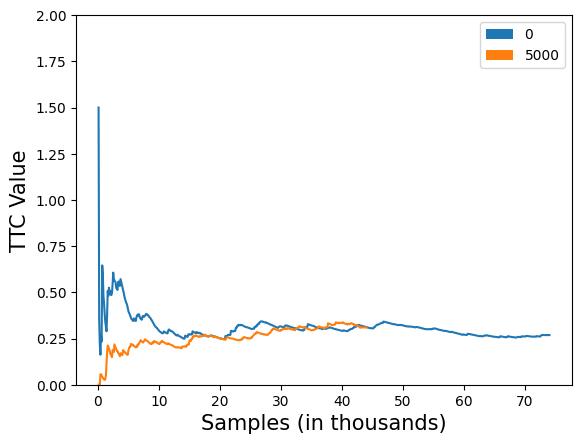

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:04<00:00, 520.17it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


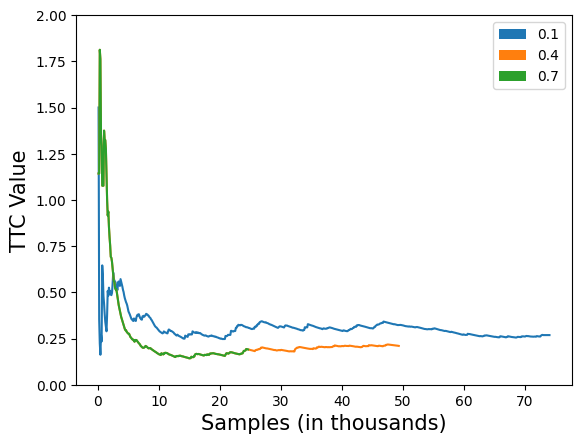

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 493.87it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


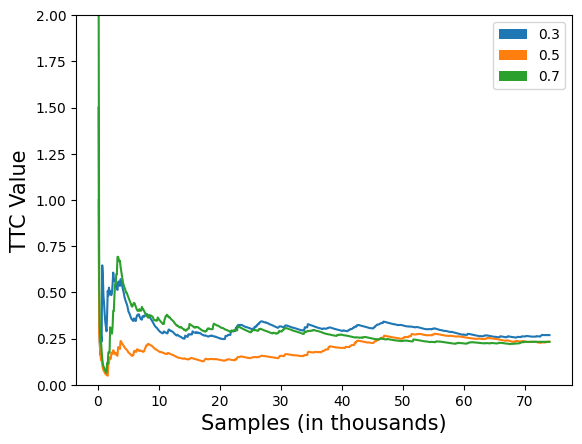

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 493.42it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


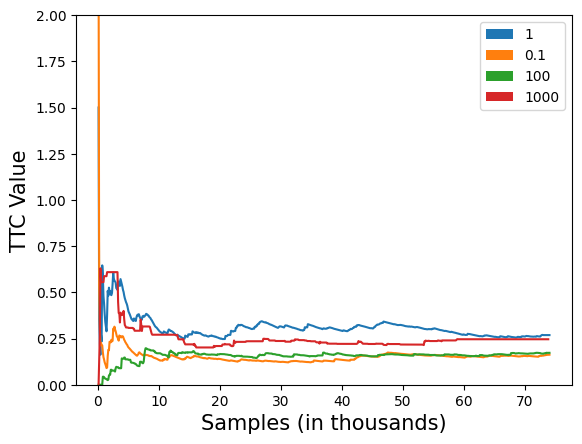

In [25]:
algo = "Minas"
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
dataset_name = "rialto.arff"
metric_name = 'ttc_5'

for rng in [range(0,2), range(2,5), range(5,8), range(8,12)]:
    fig, ax = plt.subplots()
    plt.xlabel('Samples (in thousands)', fontsize=15)
    plt.ylabel('TTC Value', fontsize=15)
    plt.ylim(0,2)
    counter = 0
    handles = []
    
    for i in rng:
        if counter == 0:
            query = f'run.experiment == "{dataset_name}" and {baseline} and "{algo}" in run.tags'
        else:
            query = f'run.experiment == "{dataset_name}" and {queries[list_characteristics[i]]} and "{algo}" in run.tags'
        
    
        metrics = get_metrics(query, aim_repo, [metric_name])
    
        # Splitting for save name
        parts = list_characteristics[i].split('=')
        dc_name = parts[0].strip()
        dc_value = parts[1].strip()

        values = [elem[metric_name] for elem in metrics]
    
        max_values, min_values, mean_values = get_max_min_mean(values)
    
        x = ((np.arange(0, max(len(arr) for arr in values)) * 100 + 100) / 1000)
        ax.plot(x, mean_values, color = colors[counter])
        handles.append(Patch(facecolor=colors[counter], label=dc_value))
        
        counter += 1
        
    plt.legend(handles=handles)#, loc='upper center', bbox_to_anchor=(0.45, 1.15), ncol=5, fontsize=15)
    if save_path is not None:
        plt.savefig(f'{save_path}Range_plots/final/{dc_name}_plot_ttc5.eps', format='eps', dpi=1200)
        plt.savefig(f'{save_path}Range_plots/final/{dc_name}_plot_ttc5.png', format='png', dpi=1200)

    plt.show()

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 496.11it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


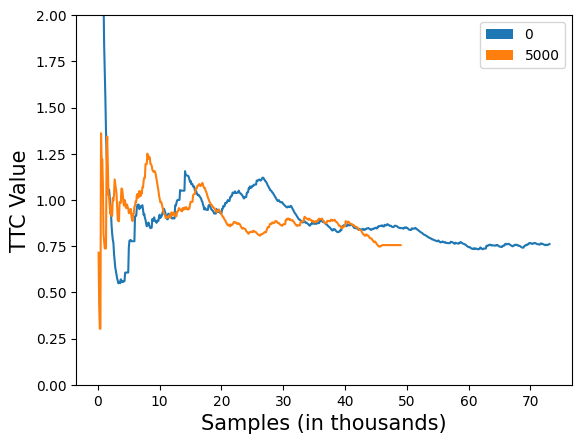

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 504.81it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


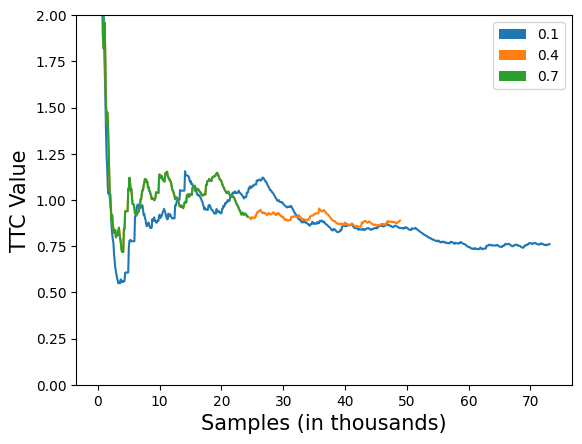

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 491.20it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


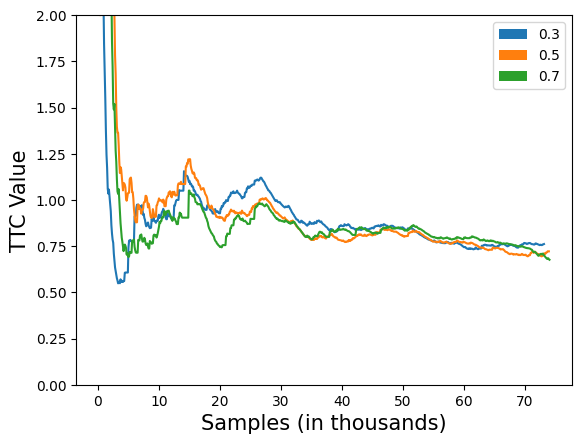

100%|██████████████████████████████████████████████████████████████████████████████| 2588/2588 [00:05<00:00, 492.75it/s]
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


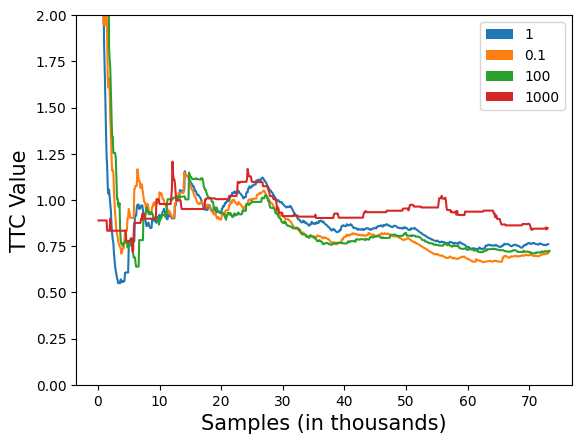

In [26]:
algo = "Minas"
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
dataset_name = "rialto.arff"
metric_name = 'ttc_9'

for rng in [range(0,2), range(2,5), range(5,8), range(8,12)]:
    fig, ax = plt.subplots()
    plt.xlabel('Samples (in thousands)', fontsize=15)
    plt.ylabel('TTC Value', fontsize=15)
    plt.ylim(0,2)
    counter = 0
    handles = []
    
    for i in rng:
        if counter == 0:
            query = f'run.experiment == "{dataset_name}" and {baseline} and "{algo}" in run.tags'
        else:
            query = f'run.experiment == "{dataset_name}" and {queries[list_characteristics[i]]} and "{algo}" in run.tags'
        
    
        metrics = get_metrics(query, aim_repo, [metric_name])
    
        # Splitting for save name
        parts = list_characteristics[i].split('=')
        dc_name = parts[0].strip()
        dc_value = parts[1].strip()

        values = [elem[metric_name] for elem in metrics]
    
        max_values, min_values, mean_values = get_max_min_mean(values)
    
        x = ((np.arange(0, max(len(arr) for arr in values)) * 100 + 100) / 1000)
        ax.plot(x, mean_values, color = colors[counter])
        handles.append(Patch(facecolor=colors[counter], label=dc_value))
        
        counter += 1
        
    plt.legend(handles=handles)#, loc='upper center', bbox_to_anchor=(0.45, 1.15), ncol=5, fontsize=15)
    if save_path is not None:
        plt.savefig(f'{save_path}Range_plots/final/{dc_name}_plot_ttc9.eps', format='eps', dpi=1200)
        plt.savefig(f'{save_path}Range_plots/final/{dc_name}_plot_ttc9.png', format='png', dpi=1200)

    plt.show()